Notebook Owner: Melisa Lara Denizoglu

# Facebook Fiat UK Analysis for Dolce Vita Concept

The aim of this study is to collect and analyze data from the official Fiat UK Facebook page, focusing on Dolcevita-themed posts, to perform a public sentiment analysis. This research seeks to understand consumer perceptions and sentiments about Fiat Dolce Vita theme by examining posts, comments, and discussions. The analysis will identify prevalent themes, attitudes, and trends in the data, providing insights into consumer satisfaction, brand perception, and areas for improvement. The findings will enhance the understanding of the Fiat 500 Dolcevita's reputation and engagement within the social media landscape among UK consumers.


Project Plan

The project steps for applying topic modeling to the news headlines dataset can be as follow:

1. Exploratory Data Analysis: The next step is analyzing the data to understand the distribution of headlines over time. The frequency of different words and phrases, and other patterns in the data. Also, you can visualizing the data using charts and graphs to gain insights into the data.

2. Data Pre-processing: The first step is cleaning and preprocessing the text to remove stop words, punctuation, etc. It also involves tokenization, stemming, and lemmatization to standardize the text data and make it suitable for analysis.

3. Sentiment Analysis

4. Sentiment Interpretation:

5. Topic Modeling: The core of the project is applying techniques such as LDA. Then, identify the main topics and themes in the news headlines dataset. It requires selecting the appropriate parameters for the topic modeling algorithms. For example, the number of topics, the size of the vocabulary, and the similarity measure.

6. Topic Interpretation: After identifying the main topics, the next step is interpreting the topics and assigning human-readable labels to them. It includes analyzing the top words and phrases associated with each topic and identifying the main themes and trends.

7. Evaluation: The final step involves evaluating the performance of the topic modeling algorithms. Then, comparing them based on metrics such as coherence score and perplexity. Identifying the limitations and challenges of the topic modeling approach and proposing possible solutions.



Part 1: Data Collection and Exploratory Data Analysis (EDA)

The dataset contains social media data sourced from the Fiat Official UK Facebook page. To collect this data, I utilized Apify. The platform provide APIs and automation tools that simplify the data collection process, allowing access to structured data without the complexities of direct API integration. This approach is particularly useful for accessing data efficiently and without handling API-related challenges.

Using Apify, I was able to extract comments from Facebook without facing any limitations. In contrast, using the Facebook Graph API requires creating a business account, obtaining approval for certain permissions (which may involve a review process), and adhering to Facebook's API rate limits and policies. This process can be cumbersome and restrictive.

Another option, direct downloading from Facebook, has its own set of challenges. Manual downloading is time-consuming, impractical for large datasets, and lacks automation and real-time data access. Additionally, Facebook’s interface may impose restrictions on the volume of data that can be accessed at once. These limitations make Apify the most suitable solution for this task.

 Posts link : 
https://docs.google.com/document/d/1AnpLcyDX_qzzGG86BEE-VfeosSMLy_2Ujms4bVdounM/edit?usp=sharing

Minimum date: 2019-04-26 17:09:36+00:00

Maximum date: 2024-07-30 04:05:15+00:00

Since the launching date we collected data until August 2024.

## Step 1: Load the Dataset

Packages to install

In [1]:
pip install emoji

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
pip install openpyxl

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
pip install pandas

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
# Libraries to install
import pandas as pd
import emoji


# Step 2: Data Preperation 

In [5]:
import pandas as pd

# Read the file into a dataframe
df = pd.read_csv("facebook_dataset_new.csv")

# Show the first 5 rows of the dataframe
print(df.head())  

# Show the number of the rows and columns in the dataframe 
print(df.shape)


  attachments/0/style_list/0 attachments/0/style_list/1  \
0                        NaN                        NaN   
1                      photo                   fallback   
2                        NaN                        NaN   
3                        NaN                        NaN   
4                        NaN                        NaN   

  attachments/0/style_list/2 attachments/0/style_list/3  \
0                        NaN                        NaN   
1                        NaN                        NaN   
2                        NaN                        NaN   
3                        NaN                        NaN   
4                        NaN                        NaN   

  attachments/0/style_list/4 attachments/0/style_list/5  \
0                        NaN                        NaN   
1                        NaN                        NaN   
2                        NaN                        NaN   
3                        NaN                        Na

In [ ]:
import pandas as pd

# Load the dataset
file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_dataset_new.csv'
facebook_data = pd.read_csv(file_path)

# Remove duplicate rows
facebook_data.drop_duplicates(inplace=True)

# Fill missing values for 'commentsCount' and 'likesCount' with 0
facebook_data['commentsCount'] = facebook_data['commentsCount'].fillna(0)
facebook_data['likesCount'] = facebook_data['likesCount'].fillna(0)

# Convert 'date' column to datetime
facebook_data['date'] = pd.to_datetime(facebook_data['date'], errors='coerce')

# Normalize text fields: Convert 'text' to lowercase, strip whitespace, and fill NaNs with an empty string
facebook_data['text'] = facebook_data['text'].str.lower().str.strip().fillna('')

# Extract post IDs from 'commentUrl'
facebook_data['postId'] = facebook_data['commentUrl'].apply(lambda url: url.split('/')[-2] if isinstance(url, str) else None)

# List of columns to drop
columns_to_drop = [
    'attachments/0/style_list/0',
    'attachments/0/style_list/1',
    'attachments/0/style_list/2',
    'attachments/0/style_list/3',
    'attachments/0/style_list/4',
    'attachments/0/style_list/5',
    'commentsCount',
    'pageAdLibrary/is_business_page_active',
    'feedbackId',
    'pageAdLibrary/id',
    'profilePicture',
    'profileUrl',
    'profileId',
    'id',
    'facebookId',
    'profileName'
]

# Drop the unnecessary columns
facebook_data.drop(columns=columns_to_drop, inplace=True)

# Validate numeric fields
facebook_data['likesCount'] = facebook_data['likesCount'].astype(int)

# Replicate rows based on likes count
facebook_data['replicate_count'] = facebook_data['likesCount'].apply(lambda x: max(1, x))
replicated_facebook_data = facebook_data.loc[facebook_data.index.repeat(facebook_data['replicate_count'])].reset_index(drop=True)

# Drop the replicate_count column after use
replicated_facebook_data.drop(columns=['replicate_count'], inplace=True)

# Rename columns
renamed_columns = {
    'commentUrl': 'comment_url',
    'date': 'comment_date',
    'facebookUrl': 'facebook_url',
    'likesCount': 'likes_count',
    'postTitle': 'post_text',
    'text': 'comment',
    'postId': 'post_id'
}

replicated_facebook_data.rename(columns=renamed_columns, inplace=True)

# Display the updated DataFrame
print(replicated_facebook_data[['comment', 'likes_count']].head())

# Display basic info about the cleaned dataset
replicated_facebook_data.info()

# Save to a new CSV file
output_file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'
replicated_facebook_data.to_csv(output_file_path, index=False)

print(f"DataFrame saved to {output_file_path}")


In [6]:
# Read the csv file
df = pd.read_csv('facebook_new_dataset_4.csv')

In [7]:
# Print the columns of the DataFrame
print(df.columns)


Index(['comment_url', 'comment_date', 'facebook_url', 'likes_count',
       'post_text', 'comment', 'post_id'],
      dtype='object')


In [8]:
# Ensure the 'Date' column is in datetime format
df['comment_date'] = pd.to_datetime(df['comment_date'], errors='coerce')

# Find the minimum and maximum dates
min_date = df['comment_date'].min()
max_date = df['comment_date'].max()

print(f"Minimum date: {min_date}")
print(f"Maximum date: {max_date}")

Minimum date: 2019-04-26 17:09:36+00:00
Maximum date: 2024-07-30 04:05:15+00:00


In [9]:
# How many data?
df.shape

(2354, 7)

## Step 2: Preprocessing the Text

In this section, Facebook comments will be cleaned by removing unwanted characters, HTML tags, URLs, and non-English words, converting emojis to text, and lemmatizing words.

1)  Textual cleaning and tokenising 

A.  Text Standardization: Converting all text to lowercase, removing punctuation and digits.

B. Noise Removal: Eliminating HTML tags, URLs, and specific non-content tokens.

C. Word Normalization: Using stopword removal and lemmatization to standardize words and reduce dimensionality.

D.  Emoji Conversion: Translating emojis to text to maintain their meaning in the analysis.

2) Determine the specific names
3) Translating comments to English
4) Extracting non-emoji columns

In [10]:
# What Nltk libraries version are we using?
import nltk

# Check the version of the NLTK package
nltk_version = nltk.__version__
print(f"NLTK package version: {nltk_version}")

# Example: Check if a specific resource is downloaded
resource_name = 'punkt'  # replace with the model/resource you want to check

try:
    nltk.data.find(f'tokenizers/{resource_name}')
    print(f"{resource_name} model/resource is installed.")
except LookupError:
    print(f"{resource_name} model/resource is not installed.")

# Note: For many resources, specific version information might not be easily accessible via NLTK.


NLTK package version: 3.8.1
punkt model/resource is installed.


In [11]:
import pandas as pd
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import emoji

# Download necessary NLTK data
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

# Initialize tools
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

# Function to remove HTML tags and non-relevant tokens
def remove_html_tags_and_tokens(comment):
    comment = re.sub(r'<.*?>', ' ', comment)  # Remove HTML tags
    comment = re.sub(r'\bbr\b', ' ', comment)  # Remove "br" tokens
    comment = re.sub(r'\bhref\b', ' ', comment)  # Remove "href" tokens
    comment = re.sub(r'\bquot\b', ' ', comment)  # Remove "quot" tokens
    return comment

# Function to clean comments
def clean_comment(comment):
    if pd.isna(comment):
        return ""
    comment = str(comment)  # Ensure the comment is a string
    comment = remove_html_tags_and_tokens(comment)  # Remove HTML tags and tokens
    comment = re.sub(r'http\S+|www\S+|https\S+', '', comment)  # Remove URLs
    comment = re.sub(r'\W', ' ', comment)  # Remove punctuation
    comment = re.sub(r'\d', '', comment)  # Remove digits
    comment = comment.replace('_', ' ')  # Replace underscores with spaces
    comment = comment.lower()  # Convert to lowercase
    tokens = nltk.word_tokenize(comment)  # Tokenize
    cleaned_tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in stop_words]  # Remove stopwords and lemmatize
    return ' '.join(cleaned_tokens)

 # Check for special names and return None if found
    if any(name in cleaned_comment for name in special_names):
        return None
    
    return cleaned_comment

# Function to convert emojis to text
def convert_emojis_to_text(comment):
    if isinstance(comment, float):
        return str(comment)  # Convert float to string
    else:
        return emoji.demojize(comment)

# Load the Facebook dataset
file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'  
comments_df = pd.read_csv(file_path)

# Apply the cleaning function to the 'text' column
comments_df['cleaned_comment'] = comments_df['comment'].apply(clean_comment)

# Optionally, apply the emoji conversion and cleaning to another column if needed
comments_df['cleaned_comment_with_text_emojis'] = comments_df['comment'].apply(lambda x: clean_comment(convert_emojis_to_text(x)))

# Save the updated DataFrame to a new CSV file
output_file_path = 'cleaned_facebook_comments_1.csv'  # Specify your desired output file path
comments_df.to_csv(output_file_path, index=False)

print(f"Cleaning complete. Cleaned comments saved to {output_file_path}.")

# Display the first few rows of the updated DataFrame
print(comments_df.head())

# Check the number of comments after the cleaning process
num_comments = comments_df.shape[0]
print(f"Number of comments after cleaning: {num_comments}")

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


Cleaning complete. Cleaned comments saved to cleaned_facebook_comments_1.csv.
                                         comment_url  \
0  https://www.facebook.com/share/p/b5pfTf3arta9f...   
1  https://www.facebook.com/share/p/b5pfTf3arta9f...   
2  https://www.facebook.com/share/p/b5pfTf3arta9f...   
3  https://www.facebook.com/share/p/b5pfTf3arta9f...   
4  https://www.facebook.com/share/p/b5pfTf3arta9f...   

                comment_date  \
0  2024-05-20 16:18:18+00:00   
1  2024-05-20 16:18:18+00:00   
2  2024-05-21 15:40:44+00:00   
3  2024-05-21 12:55:10+00:00   
4  2024-05-21 12:55:10+00:00   

                                        facebook_url  likes_count  \
0  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
1  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
2  https://www.facebook.com/share/p/b5pfTf3arta9f...            0   
3  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
4  https://www.facebook.com/share/p/b5pfTf3arta

2. Optimising Text Data Processing Through Special Name Identification

Managing special names in text processing is crucial, especially in environments like Facebook where frequent user tagging can skew analysis. By filtering out these tags, we could maintain focus on the content of the comments, ensuring more accurate and relevant insights.

In [12]:
! python -m spacy download en_core_web_sm

     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     --------------------------------------- 0.0/12.8 MB 487.6 kB/s eta 0:00:27
      --------------------------------------- 0.2/12.8 MB 2.0 MB/s eta 0:00:07
     -- ------------------------------------- 0.7/12.8 MB 4.2 MB/s eta 0:00:03
     --- ------------------------------------ 1.1/12.8 MB 5.0 MB/s eta 0:00:03
     ---- ----------------------------------- 1.5/12.8 MB 5.7 MB/s eta 0:00:02
     ----- ---------------------------------- 1.8/12.8 MB 5.6 MB/s eta 0:00:02
     ------ --------------------------------- 2.0/12.8 MB 5.5 MB/s eta 0:00:02
     ------ --------------------------------- 2.2/12.8 MB 5.4 MB/s eta 0:00:02
     ------- -------------------------------- 2.5/12.8 MB 5.6 MB/s eta 0:00:02
     -------- ------------------------------- 2.8/12.8 MB 5.7 MB/s eta 0:00:02
     --------- ------------------------------ 3.0/12.8 MB 5.7 MB/


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [13]:
import pandas as pd
import spacy

# Load the spaCy model
nlp = spacy.load("en_core_web_sm")

# Load the CSV file from your specified path
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_facebook_comments_1.csv"
comments_df_new = pd.read_csv(file_path_csv)

# Function to extract names using spaCy NER
def extract_names_spacy(comment):
    if pd.isna(comment):
        return []
    doc = nlp(comment)
    return [ent.text for ent in doc.ents if ent.label_ == 'PERSON']

# Create a set to store unique names
extracted_names_spacy = set()

# Apply spaCy NER to extract names from the 'comment' column
comments_df_new['cleaned_comment_with_text_emojis'].dropna().apply(lambda comment: extracted_names_spacy.update(extract_names_spacy(comment)))

# Convert the set to a sorted list for easier viewing
special_names_list_spacy = sorted(extracted_names_spacy)

# Display the list of special names extracted by spaCy
print(special_names_list_spacy)


['abarth pista', 'abbie bell', 'abigail', 'adam johnston', 'adam watt', 'adzy lee', 'ainda vou comprar', 'alex alia', 'alexander murphy', 'alison calvert', 'anderson capelari', 'andrew crawshaw', 'andrew mitton', 'andrew thomas want one', 'andré soriano', 'andy', 'andy browning ohhhhh', 'andy lol', 'anisa lin', 'anthony james', 'araliya thevapalan', 'arnold clark', 'aryel caleffi', 'arze', 'ashleigh hannah', 'aufzustellen müssen unmengen von wälder', 'banana', 'bansen para cuando vayamos vivir la', 'batterien von auto entsorgen', 'beautiful mocha', 'benjamin chaplin', 'benz eqe', 'beth bruce', 'bill doggett', 'bill nicola', 'billy potter', 'bin ross', 'bin wastebasket', 'bin zany face', 'bott oh', 'brian brew', 'bright orange anniversario called', 'britt norman', 'cam tyson', 'cameron hartley', 'carl', 'carol rowley', 'caseyy', 'catherine ribstein', 'cerys thomas', 'chao hope', 'charlie', 'charlotte jackson', 'chavez st', 'chris', 'chris elston', 'chris moylan', 'chris south car', 'chr

3. Translating the comments to English

While analyzing the comments, we noticed that some comments were in different languages, which is expected given the UK's linguistic diversity. Since the number of such comments was relatively small, we were able to translate them.

In [ ]:
pip install googletrans==4.0.0-rc1


In [ ]:
pip install deep-translator


In [ ]:
import pandas as pd
from deep_translator import GoogleTranslator
import spacy

# Initialize the Google Translator from deep_translator
translator = GoogleTranslator(source='auto', target='en')

# Load the spaCy model for NER
nlp = spacy.load("en_core_web_sm")

# Load your dataset
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_facebook_comments_1.csv"
comments_df = pd.read_csv(file_path_csv)

# Define a function to translate comments
def translate_comment(comment):
    if pd.isna(comment):
        return comment
    try:
        # Translate the comment to English
        translated = translator.translate(comment)
        return translated
    except Exception as e:
        print(f"Translation error for comment: {comment}\nError: {e}")
        return comment

# Apply the translation function to the comment column
comments_df['translated_comment'] = comments_df['comment'].apply(translate_comment)

# Function to extract names using spaCy NER and replace them in the comment
def replace_names_with_tag(comment):
    if pd.isna(comment):
        return comment, []
    
    doc = nlp(comment)
    names = [ent.text for ent in doc.ents if ent.label_ == 'PERSON']
    
    # Replace each name with 'tagged person'
    for name in names:
        comment = comment.replace(name, 'tagged person')
    
    return comment, names

# Apply the function to replace names and store tagged persons
comments_df[['translated_comment', 'tagged_person']] = comments_df['translated_comment'].apply(lambda comment: pd.Series(replace_names_with_tag(comment)))

# Display the updated DataFrame with translated comments and tagged persons
print(comments_df[['comment', 'translated_comment', 'tagged_person']].head())

# Save the updated DataFrame to a new CSV file
output_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\translated_facebook_comments.csv"
comments_df.to_csv(output_file_path, index=False)


We first identified and categorized the names of people as tagged individuals, as the special names primarily referred to people being tagged in the comments. This allows us to analyze how often users tag each other.

In [15]:
import pandas as pd

# Load the CSV file from your specified path
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\translated_facebook_comments.csv"
comments_df = pd.read_csv(file_path_csv)

# Create a binary column to indicate the presence of tagged persons
comments_df['tagged_person_flag'] = comments_df['translated_comment'].apply(lambda x: 1 if pd.notna(x) and 'tagged person' in x else 0)

# Display the updated DataFrame with the new flag
print(comments_df[['translated_comment', 'tagged_person_flag']].head())

# Save the updated DataFrame to a new CSV file
output_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\preprocessed_facebook_comments.csv"
comments_df.to_csv(output_file_path, index=False)

print(f"Updated comments with tagging flags saved to {output_file_path}")


                                  translated_comment  tagged_person_flag
0           500 looking very dated, needs a facelift                   0
1           500 looking very dated, needs a facelift                   0
2                                   i love my fiat 🖤                   0
3  tagged person clough wish i found my fiat this...                   1
4  tagged person clough wish i found my fiat this...                   1
Updated comments with tagging flags saved to C:\Users\melis\OneDrive\Desktop\ARP 3\preprocessed_facebook_comments.csv


4. Removing emojis and making a new columns without emoji

We removed emojis from the comments and created a new column with the text without emojis for clearer analysis, while retaining the emojis in a separate column for potential future use.

In [14]:
pip install emoji

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [17]:
# Function to remove emojis from text
def remove_emojis(text):
    if pd.isna(text):
        return text
    return emoji.replace_emoji(text, replace='')

# Load the CSV file from your specified path
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\preprocessed_facebook_comments.csv"
comments_df = pd.read_csv(file_path_csv)

# Remove emojis from the 'translated_comment' column
comments_df['translated_comment'] = comments_df['translated_comment'].apply(remove_emojis)

# Save the updated DataFrame to a new CSV file
output_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\processed_facebook_comments.csv"
comments_df.to_csv(output_file_path, index=False)

In [ ]:
import pandas as pd
import re

# Load the dataset
new_dataset = r"C:\Users\melis\OneDrive\Desktop\ARP 3\processed_facebook_comments.csv"
df = pd.read_csv(new_dataset)

# Function to remove tagged persons 
def remove_tagged_persons(comment):
    if isinstance(comment, str):  # Ensure the comment is a string
        tagged_persons = re.findall(r'tagged person', comment)  # Find all occurrences of "tagged person"
        cleaned_comment = comment.replace('tagged person', '').strip()  # Remove "tagged person" from the comment
        return cleaned_comment, 'tagged person' if tagged_persons else ''
    else:
        return '', ''  # Return empty strings if the comment is not a string (e.g., NaN)

# Apply the function and create new columns
df[['cleaned_translated_comment', 'tagged_person']] = df['cleaned_comment_with_text_emojis'].apply(
    lambda x: pd.Series(remove_tagged_persons(x))
)

# Save the updated DataFrame to a new CSV file
new_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\processed_facebook_comments_with_tagged_persons_removed.csv"
df.to_csv(new_file_path, index=False)

# Display the first few rows of the updated DataFrame
print(df.head())

# Check the columns of the DataFrame
print(df.columns)

How many people tagged each other?

In [21]:
import re
import pandas as pd

# Load the dataset
new_dataset = r"C:\Users\melis\OneDrive\Desktop\ARP 3\processed_facebook_comments.csv"
df = pd.read_csv(new_dataset)

# Filter the DataFrame where 'tagged_person_flag' is flagged as 1
tagged_person_flagged = df[df['tagged_person_flag'] == 1]['cleaned_comment_with_text_emojis']

# Count the number of rows where 'tagged_person_flag' is flagged as 1
tagged_person_flagged_count = tagged_person_flagged.shape[0]

# Function to count special characters in a string
def count_special_characters(text):
    special_chars = re.findall(r'[^a-zA-Z0-9\s]', str(text))
    return len(special_chars)

# Apply the function to count special characters in each comment in the filtered DataFrame
special_char_total = tagged_person_flagged.apply(count_special_characters).sum()

# Display the results
print(f"Number of rows flagged with 'tagged_person_flag' = 1: {tagged_person_flagged_count}")
print(f"Total number of special characters in these comments: {special_char_total}")

# Check the unique values in the 'tagged_person' column
unique_values = df['tagged_person'].unique()
print(f"Unique values in the 'tagged_person' column: {unique_values}")


Number of rows flagged with 'tagged_person_flag' = 1: 451
Total number of special characters in these comments: 99
Unique values in the 'tagged_person' column: ['[]' "['sam']" "['karen peck']" "['beth bruce']" "['jason liddy']"
 "['🚗']" "['hayley chappell']" "['james hyde']" "['kirsty smart 🤩']"
 "['liz colley']" "['bill nicola']" "['thomas black']" "['pippa neal']"
 "['nigel webb']" "['laura bowen']" "['sally powley']"
 "['ervin pinvisase']" "['louis theodossiou']" "['gregg wilson']"
 "['harvey newman']" "['michelle']" "['luke']" "['Steve Short']"
 "['caseyy']" "['paul hancock']" "['mike warren']"
 "['joe benit mich swift', '😍😍😍😍']" "['julie hennessy']"
 "['natasha harrison']" "['luke carter']" "['dean clarkson']"
 "['john bennett']" "['john bennett', '😍😍😍😍']" "['steven 😍']"
 "['john cardie']" "['tory powles', 'chris elston']" "['sharon burrows']"
 "['😍😍😍']" "['soooooo']" "['ashleigh hannah']" "['joe riley']"
 "['jayne jones']" "['joanne panda']" "['paul']" "['sarah milner']"
 "['laur

Remove the special names 

In [22]:
# Function to remove specified words and phrases from the comments
def remove_specified_words(comment, words_to_remove):
    for word in words_to_remove:
        comment = comment.replace(word, '')  # Remove the specific word or phrase
    return comment.strip()

# Convert all unique values to strings and flatten the list, in case there are nested lists
flattened_values = [str(word) for sublist in unique_values for word in eval(sublist)]

# Apply the function to remove the specified words from the comments and store the result in a new column
df['cleaned_translated_comment'] = df['cleaned_comment_with_text_emojis'].apply(
    lambda comment: remove_specified_words(comment, flattened_values)
)

# Save the updated DataFrame to a new CSV file
new_file_path = 'cleaned_translated_comments_final.csv'
df.to_csv(new_file_path, index=False)

# Display the first few rows of the updated DataFrame to verify the changes
df[['cleaned_comment_with_text_emojis', 'cleaned_translated_comment']].head()


AttributeError: 'float' object has no attribute 'replace'

In [23]:
# Function to remove specified words and phrases from the comments
def remove_specified_words(comment, words_to_remove):
    for word in words_to_remove:
        comment = comment.replace(word, '')  # Remove the specific word or phrase
    return comment.strip()

# Convert all unique values to strings and flatten the list, in case there are nested lists
flattened_values = [str(word) for sublist in unique_values for word in eval(sublist)]

# Apply the function to remove the specified words from the comments and store the result in a new column
df['cleaned_translated_comment'] = df['cleaned_comment_with_text_emojis'].apply(
    lambda comment: remove_specified_words(comment, flattened_values)
)

# Save the updated DataFrame to a new CSV file
new_file_path = 'cleaned_translated_comments_final.csv'
df.to_csv(new_file_path, index=False)

# Display the first few rows of the updated DataFrame to verify the changes
df[['cleaned_comment_with_text_emojis', 'cleaned_translated_comment']].head()


AttributeError: 'float' object has no attribute 'replace'

In [ ]:
import pandas as pd

# Load the dataset
new_dataset = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_final.csv"
df = pd.read_csv(new_dataset)

# Display missing values in the DataFrame
missing_values = df.isnull().sum()
print(missing_values)

# Remove rows where 'cleaned_translated_comment' is missing (NaN)
df_cleaned = df.dropna(subset=['cleaned_translated_comment'])

# Save the updated DataFrame to a new CSV file
cleaned_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
df_cleaned.to_csv(cleaned_file_path, index=False)


Data Visualisation

In [219]:
# Load the dataset
file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'  
df = pd.read_csv(file_path)

# Get the column names
print(df.columns.tolist())


['comment_url', 'comment_date', 'facebook_url', 'likes_count', 'post_text', 'comment', 'post_id']


How many comments per month?

In [ ]:
# Load the dataset
file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'  
df = pd.read_csv(file_path)

# Get the column names
print(df.columns.tolist())
['comment_url', 'comment_date', 'facebook_url', 'likes_count', 'post_text', 'comment', 'post_id']



In [255]:
import pandas as pd

# Load the dataset
file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'  
df = pd.read_csv(file_path)

# Convert 'comment_date' to datetime
df['comment_date'] = pd.to_datetime(df['comment_date'])

# Extract the month and define the season
df['month'] = df['comment_date'].dt.month

def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

df['season'] = df['month'].apply(month_to_season)

# Group by 'post_id' and 'season', then count the number of comments
comments_per_post = df.groupby(['post_id', 'season']).size().reset_index(name='comment_count')

# Group by 'season' to get the average number of comments per post
average_comments_per_post = comments_per_post.groupby('season')['comment_count'].mean().reset_index()

# Display the results
print(average_comments_per_post)


   season  comment_count
0  Autumn      21.400000
1  Spring       9.238095
2  Summer      31.475000
3  Winter       8.941176


How many posts per season?

In [256]:
import pandas as pd

# Load the dataset
file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'  
df = pd.read_csv(file_path)

# Convert 'comment_date' to datetime
df['comment_date'] = pd.to_datetime(df['comment_date'])

# Extract the month and define the season
df['month'] = df['comment_date'].dt.month

def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

df['season'] = df['month'].apply(month_to_season)

# Count the number of unique posts per season
posts_per_season = df.groupby('season')['post_id'].nunique().reset_index(name='post_count')

# Display the results
print(posts_per_season)


   season  post_count
0  Autumn          35
1  Spring          21
2  Summer          40
3  Winter          17


In [24]:
# Display the first few rows of the updated DataFrame

new_dataset= r"C:\Users\melis\OneDrive\Desktop\ARP 3\processed_facebook_comments.csv"
df = pd.read_csv(new_dataset)
print(df.head())

# Check the columns of the DataFrame
print(df.columns)

                                         comment_url  \
0  https://www.facebook.com/share/p/b5pfTf3arta9f...   
1  https://www.facebook.com/share/p/b5pfTf3arta9f...   
2  https://www.facebook.com/share/p/b5pfTf3arta9f...   
3  https://www.facebook.com/share/p/b5pfTf3arta9f...   
4  https://www.facebook.com/share/p/b5pfTf3arta9f...   

                comment_date  \
0  2024-05-20 16:18:18+00:00   
1  2024-05-20 16:18:18+00:00   
2  2024-05-21 15:40:44+00:00   
3  2024-05-21 12:55:10+00:00   
4  2024-05-21 12:55:10+00:00   

                                        facebook_url  likes_count  \
0  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
1  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
2  https://www.facebook.com/share/p/b5pfTf3arta9f...            0   
3  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
4  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   

                                           post_text  \

How many people tagged each other? What's the ratio?

In [25]:
import pandas as pd

# Total number of data points (rows) in the DataFrame
total_data_points = df.shape[0]

# Count the number of tagged persons
tagged_person_count = df['tagged_person_flag'].sum()

# Calculate the ratio of tagged persons
ratio = tagged_person_count / total_data_points

print(f'Total number of data points: {total_data_points}')
print(f'Total number of tagged persons: {tagged_person_count}')
print(f'Ratio of tagged persons to total data points: {ratio:.2f}')


Total number of data points: 2354
Total number of tagged persons: 451
Ratio of tagged persons to total data points: 0.19


Emoji Distribution

In [26]:
import pandas as pd
from collections import Counter
import emoji
import re

# Function to extract only emojis from a text
def extract_emojis(text):
    # Use emoji module's is_emoji function to filter out only emojis
    return ''.join(c for c in text if c in emoji.EMOJI_DATA)

# Extract all emojis from the 'cleaned_comment_with_text_emojis' column
all_emojis = df['comment'].apply(lambda x: extract_emojis(str(x))).sum()

# Count the frequency of each emoji
emoji_counter = Counter(all_emojis)

# Get the top 10 most common emojis
top_10_emojis = emoji_counter.most_common(10)

print("Top 10 most used emojis:")
for emoji_char, count in top_10_emojis:
    print(f"{emoji_char}: {count} times")


Top 10 most used emojis:
😍: 200 times
😂: 110 times
❤: 90 times
🤣: 79 times
🥰: 45 times
💙: 37 times
💛: 33 times
🤩: 32 times
👍: 32 times
💚: 31 times


In [30]:
import pandas as pd
from collections import Counter
import emoji
import re

# Function to extract only emojis from a text
def extract_emojis(text):
    # Use emoji module's is_emoji function to filter out only emojis
    return ''.join(c for c in text if c in emoji.EMOJI_DATA)

# Extract all emojis from the 'comment' column
all_emojis = df['comment'].apply(lambda x: extract_emojis(str(x))).sum()

# Count the frequency of each emoji
emoji_counter = Counter(all_emojis)

# Get the least 10 common emojis
least_10_emojis = emoji_counter.most_common()[:-11:-1]

print("Least 10 used emojis:")
for emoji_char, count in least_10_emojis:
    print(f"{emoji_char}: {count} times")


Least 10 used emojis:
🙋: 1 times
🍾: 1 times
💞: 1 times
🫣: 1 times
🌏: 1 times
🏅: 1 times
😣: 1 times
⚠: 1 times
🏾: 1 times
🎪: 1 times


In [27]:
import pandas as pd
import numpy as np
from collections import Counter
import emoji


# Function to extract only emojis from a text
def extract_emojis(text):
    return ''.join(c for c in text if c in emoji.EMOJI_DATA)

# Extract all emojis from the 'comment' column
df['emojis'] = df['comment'].apply(lambda x: extract_emojis(str(x)))

# Flatten the list of emojis into a single array
all_emojis = np.hstack(df['emojis'].apply(lambda x: list(x)).values)

# Count the frequency of each emoji using Counter
emoji_counter = Counter(all_emojis)

# Convert the counter to a DataFrame
emoji_df = pd.DataFrame(emoji_counter.items(), columns=['Emoji', 'Count']).sort_values(by='Count', ascending=False)

import pandas as pd

# Set display options to show all rows in the DataFrame
pd.set_option('display.max_rows', None)

# Print the results
print(emoji_df)



    Emoji  Count
3       😍    200
11      😂    110
9       ❤     90
30      🤣     79
1       🥰     45
46      💙     37
79      💛     33
35      👍     32
5       🤩     32
44      💚     31
40      😉     25
80      🤍     23
23      😊     19
49      😆     17
69      😁     15
27      👌     15
68      ☺     14
10      👀     12
55      🚙     12
28      🤔     11
50      ⚡     11
65      🧡     10
98      😱      9
18      🤮      9
7       😏      9
32      🙈      8
100     🙄      8
75      ⭐      8
2       💖      8
104     🩵      7
20      😀      7
64      😎      7
52      🙏      7
77      ♂      7
13      💕      7
92      🌻      7
4       🚗      7
36      🏻      7
54      🍦      7
22      🏼      6
117     👹      6
61      😐      6
119     💩      5
48      😜      5
0       🖤      5
45      🩷      5
91      💗      5
29      🔥      5
12      🤭      5
15      😭      5
19      🤷      5
89      😘      5
39      ☹      4
105     😅      4
6       🐼      4
83      😳      4
76      🤦      4
99      😄     

In [ ]:
pip install matplotlib

In [ ]:
pip install matplotlib==3.3.4


In [ ]:
pip install matplotlib


In [ ]:
!pip install --upgrade requests-mock blosc2 jedi prompt-toolkit fsspec
!pip install -U protobuf pydantic black urllib3

In [15]:
import numpy as np
import pandas as pd
from IPython.display import display
from tqdm import tqdm
from collections import Counter

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob
import scipy.stats as stats

from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE
from wordcloud import WordCloud, STOPWORDS

from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
output_notebook()

%matplotlib inline

ImportError: DLL load failed while importing _path: The specified module could not be found.

Starting with visualizing the top 15 words in the data without including stopwords.

C:\Users\melis\AppData\Local\Temp\ipykernel_8372\2416210929.py:8: FutureWarning:

The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.

C:\Users\melis\AppData\Local\Temp\ipykernel_8372\2416210929.py:8: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



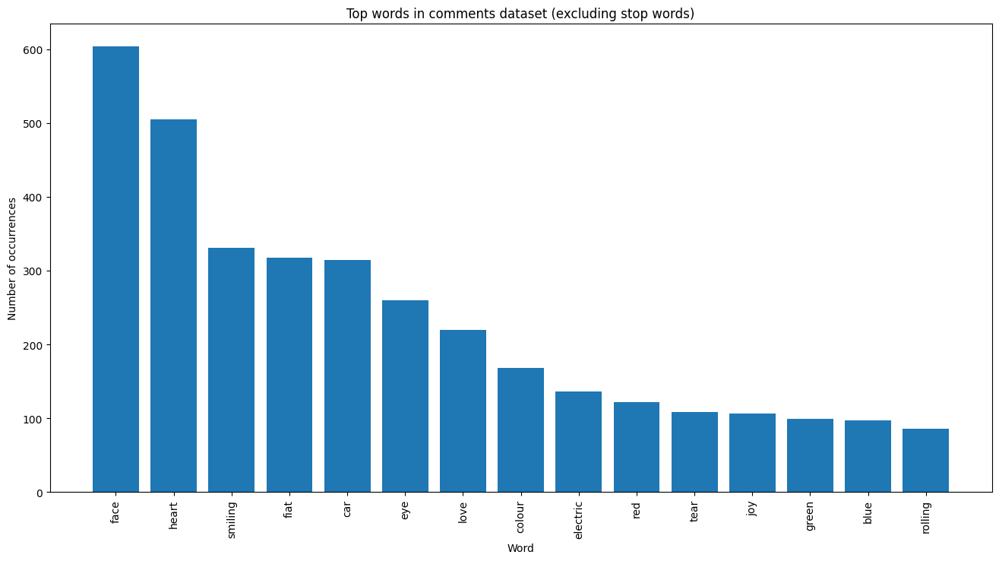

In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer

# Load the dataset
path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
df = pd.read_csv(path, parse_dates=[0], infer_datetime_format=True)

# Drop rows where 'translated_comment' is NaN
df = df.dropna(subset=['translated_comment'])

def get_top_n_words(n_top_words, count_vectorizer, text_data):
    '''
    Returns a tuple of the top n words in a sample and their 
    accompanying counts, given a CountVectorizer object and text sample.
    '''
    vectorized_text = count_vectorizer.fit_transform(text_data.values)
    vectorized_total = np.sum(vectorized_text, axis=0)
    word_indices = np.flip(np.argsort(vectorized_total)[0, :], 1)
    word_values = np.flip(np.sort(vectorized_total)[0, :], 1)
    
    word_vectors = np.zeros((n_top_words, vectorized_text.shape[1]))
    for i in range(n_top_words):
        word_vectors[i, word_indices[0, i]] = 1

    words = [word[0].encode('ascii').decode('utf-8') for 
             word in count_vectorizer.inverse_transform(word_vectors)]
    return (words, word_values[0, :n_top_words].tolist()[0])

# Define the CountVectorizer with specified parameters
count_vectorizer = CountVectorizer(max_df=0.8, min_df=2, stop_words='english')

# Extract the top words from the 'translated_comment' column
words, word_values = get_top_n_words(
    n_top_words=15,
    count_vectorizer=count_vectorizer,
    text_data=df['cleaned_translated_comment']  # Replace 'reindexed_data' with your column name
)

# Plot the results
fig, ax = plt.subplots(figsize=(16, 8))
ax.bar(range(len(words)), word_values)
ax.set_xticks(range(len(words)))
ax.set_xticklabels(words, rotation='vertical')
ax.set_title('Top words in comments dataset (excluding stop words)')
ax.set_xlabel('Word')
ax.set_ylabel('Number of occurrences')
plt.show()


In [32]:
import nltk
from textblob import TextBlob
import pandas as pd
import numpy as np

# Ensure the necessary NLTK data packages are downloaded
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

# Load your dataset
path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
df = pd.read_csv(path)

# Ensure there are no NaN values in the 'translated_comment' column
df = df.dropna(subset=['translated_comment'])

# Apply POS tagging to each comment
tagged_comments = [TextBlob(df['translated_comment'].iloc[i]).pos_tags for i in range(df.shape[0])]

# Create a DataFrame to store the tagged comments
tagged_comments_df = pd.DataFrame({'tags': tagged_comments})

# Initialize lists and dictionaries to store word counts and POS counts
word_counts = []
pos_counts = {}

# Count the words and their POS tags
for comment in tagged_comments_df['tags']:
    word_counts.append(len(comment))
    for tag in comment:
        if tag[1] in pos_counts:
            pos_counts[tag[1]] += 1
        else:
            pos_counts[tag[1]] = 1

# Output the total and mean number of words
print('Total number of words:', np.sum(word_counts))
print('Mean number of words per comment:', np.mean(word_counts))

# Optionally, display the POS counts
print('POS Tag Counts:', pos_counts)


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


Total number of words: 24581
Mean number of words per comment: 11.699666825321275
POS Tag Counts: {'CD': 789, 'VBG': 433, 'RB': 1523, 'JJ': 2361, 'VBZ': 670, 'DT': 2221, 'NN': 5863, 'VBP': 820, 'PRP$': 507, 'VBN': 621, 'IN': 2186, 'VBD': 581, 'VB': 1332, 'PRP': 1243, 'NNS': 978, 'WRB': 201, 'RP': 136, 'WP': 83, 'EX': 33, 'NNP': 104, 'MD': 402, 'TO': 495, 'CC': 639, 'JJR': 74, 'PDT': 28, 'JJS': 58, 'POS': 41, 'WDT': 80, 'RBR': 47, 'UH': 17, 'SYM': 4, 'RBS': 6, 'FW': 5}


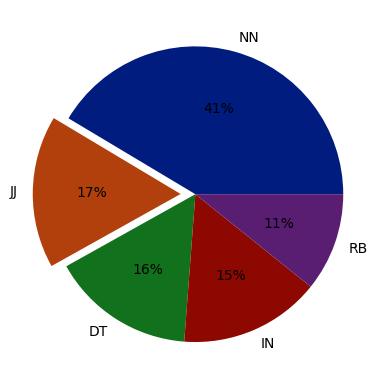

In [34]:
# importing libraries
import matplotlib.pyplot as plt
import seaborn as sns
  
# declaring data
pos_sorted_types = sorted(pos_counts, key=pos_counts.__getitem__, reverse=True)
pos_sorted_counts = sorted(pos_counts.values(), reverse=True)
  
top_five = pos_sorted_types[:5]
data = pos_sorted_counts[:5]
# declaring exploding pie
explode = [0, 0.1, 0, 0, 0]
# define Seaborn color palette to use
palette_color = sns.color_palette('dark')
  
# plotting data on chart
plt.pie(data, labels=top_five, colors=palette_color, explode=explode,
         autopct='%.0f%%')
  
# displaying chart
plt.show()

The pie chart appears to be visualizing the distribution of different Part-of-Speech (POS) tags within a dataset. The labels such as "NN," "JJ," "RB," "IN," and "DT" are standard POS tags used in Natural Language Processing (NLP):

NN: Noun, singular or mass
JJ: Adjective
RB: Adverb
IN: Preposition or subordinating conjunction
DT: Determiner

The percentages shown in the pie chart represent the proportion of words in the  dataset that fall into each of these POS categories. For example, the chart shows that 41% of the words are nouns (NN), 17% are adjectives (JJ), and so on.

This type of chart helps in understanding the lexical composition of the text data by indicating which parts of speech are most prevalent.

In [ ]:
# burasi onemli degildi silebilirsin

Most common bigrams: [(('tagged', 'person'), 331), (('!', '!'), 134), (('in', 'the'), 120), (('.', 'i'), 106), (('fiat', '500'), 77), (('’', 's'), 77), (('in', 'a'), 69), (('’', 't'), 68), (('i', 'have'), 62), (('on', 'the'), 60)]


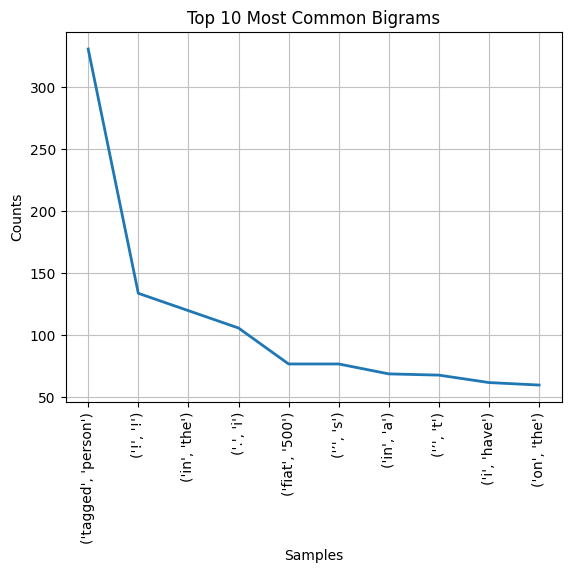

In [10]:
import pandas as pd
import nltk
from nltk import FreqDist
from nltk.util import ngrams
import matplotlib.pyplot as plt

# Load the dataset
path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
df = pd.read_csv(path)

# Tokenize the cleaned and translated comments into words
words = []
for comment in df['translated_comment']:
    if pd.notna(comment):  # Ensure the comment is not NaN
        words.extend(nltk.word_tokenize(comment.lower()))  # Convert to lowercase for uniformity

# Generate bigrams (two-word phrases)
bigrams = list(ngrams(words, 2))

# Find the frequency distribution of bigrams
fdist_bigrams = FreqDist(bigrams)

# Get the 10 most common bigrams
most_common_bigrams = fdist_bigrams.most_common(10)
print("Most common bigrams:", most_common_bigrams)

# Plot the frequency distribution of the 10 most common bigrams
fdist_bigrams.plot(10, title="Top 10 Most Common Bigrams")

plt.show()


C:\Users\melis\AppData\Local\Temp\ipykernel_19448\2078042859.py:8: FutureWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  df = pd.read_csv(path, parse_dates=[0], infer_datetime_format=True)
C:\Users\melis\AppData\Local\Temp\ipykernel_19448\2078042859.py:8: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df = pd.read_csv(path, parse_dates=[0], infer_datetime_format=True)


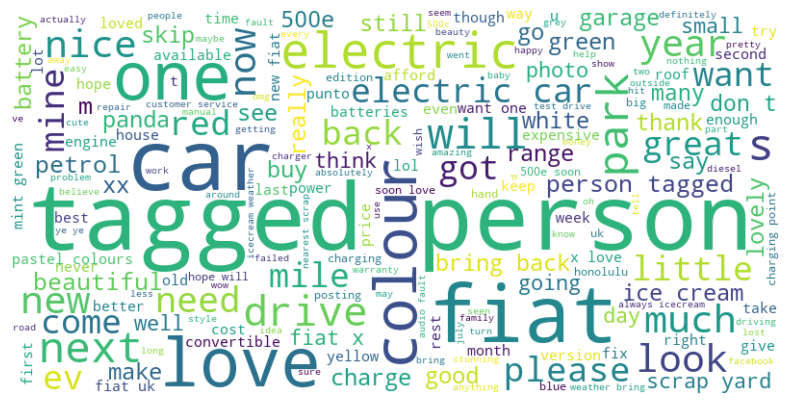

In [9]:
# Word Cloud
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Load the dataset
path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
df = pd.read_csv(path, parse_dates=[0], infer_datetime_format=True)

# Combine all comments into a single string
text = " ".join(comment for comment in df['translated_comment'].dropna())

# Create and generate a word cloud image
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)

# Display the generated word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


In [36]:
import pandas as pd
import gensim
from gensim import corpora
from gensim.utils import simple_preprocess
from gensim.models import LdaModel
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

# Load your dataset
data = pd.read_csv(r'C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv')

# Ensure the 'cleaned_comment_with_text_emojis' column is treated as a string
data['cleaned_comment_with_text_emojis'] = data['cleaned_comment_with_text_emojis'].astype(str)

# Tokenize the data
data['tokens'] = data['cleaned_comment_with_text_emojis'].map(lambda x: simple_preprocess(x, deacc=True))

# Create a dictionary representation of the documents
dictionary = corpora.Dictionary(data['tokens'])

# Filter out extremes to limit the number of features
dictionary.filter_extremes(no_below=15, no_above=0.5, keep_n=100000)

# Create a bag-of-words representation of the data
corpus = [dictionary.doc2bow(text) for text in data['tokens']]

# Set up the LDA model
lda_model = LdaModel(
    corpus=corpus, 
    num_topics=10, 
    id2word=dictionary, 
    passes=10, 
    iterations=50, 
    random_state=100, 
    update_every=1, 
    chunksize=100, 
    alpha='auto'
)

# Use pyLDAvis to visualize the topics
vis = gensimvis.prepare(lda_model, corpus, dictionary)

# Display the visualization in the notebook (if using Jupyter)
pyLDAvis.display(vis)

# Alternatively, you can save it as an HTML file
pyLDAvis.save_html(vis, 'lda_topic_model_visualization.html')


c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:39: DeprecationWarning:

Attribute n is deprecated and will be removed in Python 3.14; use value instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users

In [37]:
import webbrowser
pyLDAvis.save_html(vis, 'lda_topic_model_visualization.html')
webbrowser.open('lda_topic_model_visualization.html')


True

In [ ]:
# bu kullanilabilir

In [38]:
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis


In [39]:
vis = gensimvis.prepare(lda_model, corpus, dictionary)


c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:39: DeprecationWarning:

Attribute n is deprecated and will be removed in Python 3.14; use value instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:39: DeprecationWarning:

Attribute n is deprecated and will be removed in Python 3.14; use value instead



In [44]:
import pandas as pd
import gensim
from gensim import corpora
from gensim.utils import simple_preprocess
from gensim.models import LdaModel
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

# Load your dataset
data = pd.read_csv(r'C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv')

# Ensure the 'cleaned_comment_with_text_emojis' column is treated as a string
data['cleaned_comment_with_text_emojis'] = data['cleaned_comment_with_text_emojis'].astype(str)

# Tokenize the data
data['tokens'] = data['cleaned_comment_with_text_emojis'].map(lambda x: simple_preprocess(x, deacc=True))

# Create a dictionary representation of the documents
dictionary = corpora.Dictionary(data['tokens'])

# Filter out extremes to limit the number of features
dictionary.filter_extremes(no_below=15, no_above=0.5, keep_n=100000)

# Create a bag-of-words representation of the data
corpus = [dictionary.doc2bow(text) for text in data['tokens']]

# Set up the LDA model
lda_model = LdaModel(corpus=corpus, num_topics=10, id2word=dictionary, passes=10, iterations=50, random_state=100, update_every=1, chunksize=100, alpha='auto')

# Create the LDA visualization
vis = gensimvis.prepare(lda_model, corpus, dictionary)

# Display the visualization inline in the notebook
pyLDAvis.display(vis)


Removing stop words is needed.

Section 2: Data Model Selection

2.1 Sentimental Analysis: Clustering based on sentiments 

Using sentiment analysis companies and product owners use can use sentiment analysis to know the demand and supply of their products through comments and feedback from the customers.

2.1.1 Star Rating Approach

In [45]:
import pandas as pd
from transformers import pipeline
import torch
import time

# Check if Apple Silicon with MPS backend is available
device = torch.device("mps") if torch.backends.mps.is_available() else torch.device("cpu")
print(f"Using device: {device}")

# Load your data
file_path =  r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
facebook4_data = pd.read_csv(file_path)

# Load the pre-trained sentiment-analysis pipeline with GPU support
sentiment_pipeline = pipeline("sentiment-analysis", model="nlptown/bert-base-multilingual-uncased-sentiment", device=device)

# Function to split text into chunks of max_length
def chunk_text(text, max_length=512):
    return [text[i:i + max_length] for i in range(0, len(text), max_length)]

# Function to apply sentiment analysis safely with segment processing
def analyze_sentiment(text):
    try:
        chunks = chunk_text(text, max_length=512)
        sentiments = [sentiment_pipeline(chunk)[0]['label'] for chunk in chunks]
        # Aggregate sentiments 
        aggregated_sentiment = max(set(sentiments), key=sentiments.count)
        return aggregated_sentiment
    except Exception as e:
        print(f"Error processing text: {text}\nError: {e}")
        return None

# Progress tracking variables
total_comments = len(facebook4_data)
start_time = time.time()

# Apply sentiment analysis to the translated comments
sentiments = []
for idx, comment in enumerate(facebook4_data['cleaned_translated_comment']):
    sentiment = analyze_sentiment(str(comment))
    sentiments.append(sentiment)
    
    # Print progress every 10 comments
    if (idx + 1) % 10 == 0:
        elapsed_time = time.time() - start_time
        print(f"Processed {idx + 1}/{total_comments} comments. Elapsed time: {elapsed_time:.2f} seconds.")

# Add sentiments to the dataframe
facebook4_data['sentiment'] = sentiments

# Display the first few rows to show the sentiment analysis results
print(facebook4_data.head())

# Save the results to a new CSV file
output_file_path = 'sentiment_analyzed_comments_with_text_emojis_facebook_fiat_5.csv'
facebook4_data.to_csv(output_file_path, index=False)

print(f"Sentiment analysis complete. Results saved to {output_file_path}.")


KeyboardInterrupt: 

Using device: cpu



c:\Users\melis\anaconda3\Lib\site-packages\torch\_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
c:\Users\melis\anaconda3\Lib\site-packages\transformers\tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Processed 10/2126 comments. Elapsed time: 0.69 seconds.
Processed 20/2126 comments. Elapsed time: 1.20 seconds.
Processed 30/2126 comments. Elapsed time: 1.66 seconds.
Processed 40/2126 comments. Elapsed time: 2.08 seconds.
Processed 50/2126 comments. Elapsed time: 2.57 seconds.
Processed 60/2126 comments. Elapsed time: 3.18 seconds.
Processed 70/2126 comments. Elapsed time: 3.61 seconds.
Processed 80/2126 comments. Elapsed time: 4.14 seconds.
Processed 90/2126 comments. Elapsed time: 4.57 seconds.
Processed 100/2126 comments. Elapsed time: 4.94 seconds.


KeyboardInterrupt: 

In [18]:
pip install --upgrade numpy pandas pillow


     ---------------------------------------- 0.0/59.7 kB ? eta -:--:--
     ------------------- ------------------ 30.7/59.7 kB 660.6 kB/s eta 0:00:01
     -------------------------------------- 59.7/59.7 kB 798.4 kB/s eta 0:00:00
   ---------------------------------------- 0.0/12.9 MB ? eta -:--:--
   - -------------------------------------- 0.5/12.9 MB 10.0 MB/s eta 0:00:02
   - -------------------------------------- 0.6/12.9 MB 11.8 MB/s eta 0:00:02
   --- ------------------------------------ 1.2/12.9 MB 9.2 MB/s eta 0:00:02
   --- ------------------------------------ 1.2/12.9 MB 8.6 MB/s eta 0:00:02
   ----- ---------------------------------- 1.6/12.9 MB 7.4 MB/s eta 0:00:02
   ------ --------------------------------- 2.0/12.9 MB 7.5 MB/s eta 0:00:02
   ------ --------------------------------- 2.1/12.9 MB 6.8 MB/s eta 0:00:02
   ------- -------------------------------- 2.4/12.9 MB 6.6 MB/s eta 0:00:02
   -------- ------------------------------- 2.7/12.9 MB 6.7 MB/s eta 0:00:02
   

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cartopy 0.22.0 requires matplotlib>=3.4, which is not installed.
data-morph-ai 0.2.0 requires matplotlib>=3.3, which is not installed.
lifelines 0.28.0 requires matplotlib>=3.0, which is not installed.
phik 0.12.4 requires matplotlib>=2.2.3, which is not installed.
wordcloud 1.9.3 requires matplotlib, which is not installed.
ydata-profiling 4.6.4 requires matplotlib<3.9,>=3.2, which is not installed.
seaborn 0.12.2 requires matplotlib!=3.6.1,>=3.1, which is not installed.
islp 0.3.22 requires numpy<1.25,>=1.7.1, but you have numpy 2.1.0 which is incompatible.
islp 0.3.22 requires pandas<=1.9,>=0.20, but you have pandas 2.2.2 which is incompatible.
lifelines 0.28.0 requires numpy<2.0,>=1.14.0, but you have numpy 2.1.0 which is incompatible.
pygam 0.9.0 requires numpy<2.0.0,>=1.24.2, but you have numpy 2.1.0 which i

C:\Users\melis\AppData\Local\Temp\ipykernel_19448\2564464000.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=rating_counts.index, y=rating_counts.values, palette='viridis')
c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group

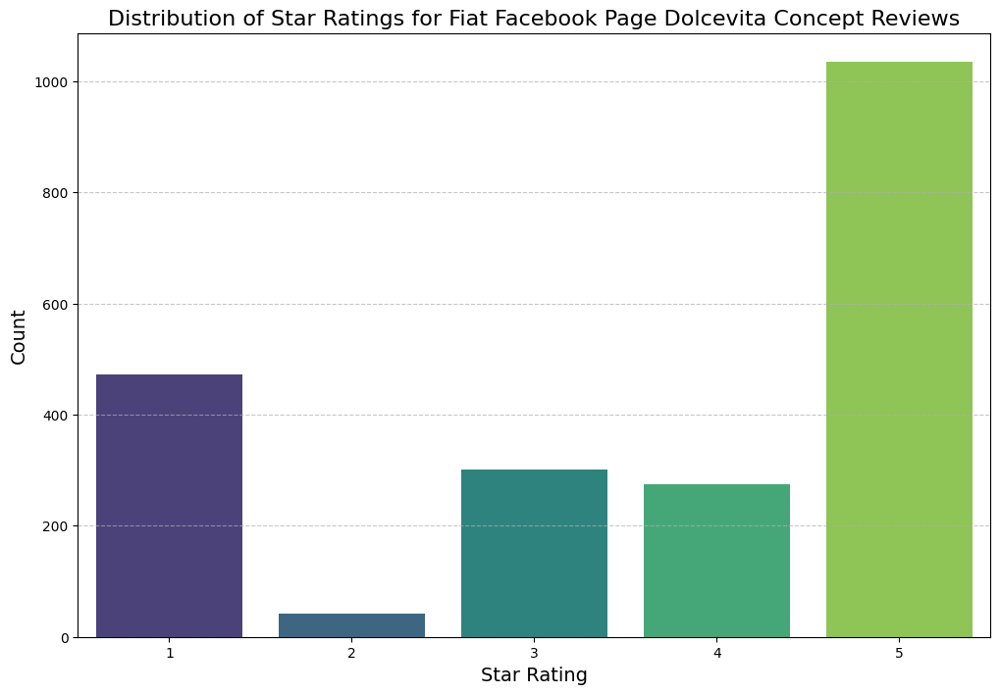

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the sentiment analyzed data
file_path = 'sentiment_analyzed_comments_with_text_emojis_facebook_fiat_5.csv'
facebook4_data = pd.read_csv(file_path)

# Extract the star ratings from the sentiment labels
facebook4_data['star_rating'] = facebook4_data['sentiment'].apply(lambda x: int(x.split()[0]) if 'star' in x else None)

# Count the occurrences of each star rating
rating_counts = facebook4_data['star_rating'].value_counts().sort_index(ascending=False)

# Plot the results
plt.figure(figsize=(12, 8))
sns.barplot(x=rating_counts.index, y=rating_counts.values, palette='viridis')

# Set plot details
plt.title('Distribution of Star Ratings for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)
plt.xlabel('Star Rating', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('star_rating_distribution_with_text_emojis_fiat_facebook_4.png', dpi=300)
plt.show()

In [48]:

# Load the sentiment analyzed data
file_path = 'sentiment_analyzed_comments_with_text_emojis_facebook_fiat_5.csv'
facebook4_data = pd.read_csv(file_path)

# Convert sentiment labels to numerical values if necessary for aggregation
sentiment_mapping = {
    "1 star": 1,
    "2 stars": 2,
    "3 stars": 3,
    "4 stars": 4,
    "5 stars": 5
}
facebook4_data['sentiment_score'] = facebook4_data['sentiment'].map(sentiment_mapping)

# Aggregate sentiment results
sentiment_distribution = facebook4_data['sentiment_score'].value_counts().sort_index().reset_index()
sentiment_distribution.columns = ['sentiment', 'count']

# Display aggregated sentiment distribution
print(sentiment_distribution.head())

   sentiment  count
0          1    472
1          2     42
2          3    302
3          4    275
4          5   1035


Converting to star rating to neutral, positive, negative

C:\Users\melis\AppData\Local\Temp\ipykernel_19448\3273472297.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=sentiment_counts.index, y=sentiment_counts.values, palette='viridis')
c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get

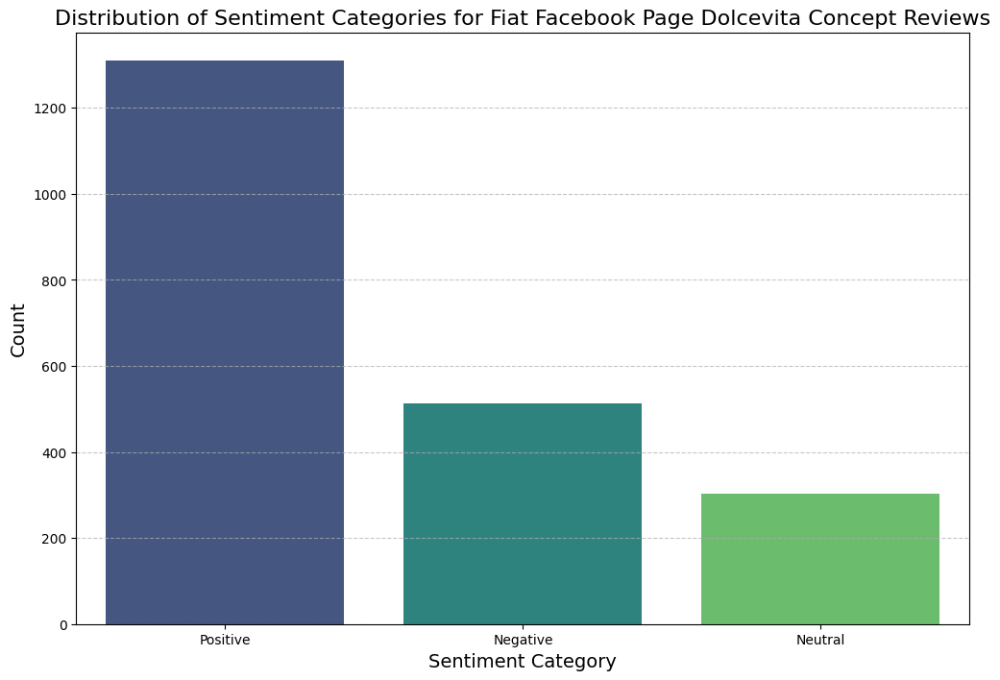

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the sentiment analyzed data
file_path = "sentiment_analyzed_comments_with_text_emojis_facebook_fiat_5.csv"
facebook1_data = pd.read_csv(file_path)

# Extract the star ratings from the sentiment labels
facebook1_data['star_rating'] = facebook1_data['sentiment'].apply(lambda x: int(x.split()[0]) if 'star' in x else None)

# Convert star ratings to sentiment categories
def star_to_sentiment(star_rating):
    if star_rating in [4, 5]:
        return 'Positive'
    elif star_rating == 3:
        return 'Neutral'
    elif star_rating in [1, 2]:
        return 'Negative'
    else:
        return None

facebook1_data['sentiment_category'] = facebook1_data['star_rating'].apply(star_to_sentiment)

# Count the occurrences of each sentiment category
sentiment_counts = facebook1_data['sentiment_category'].value_counts()

# Plot the results
plt.figure(figsize=(12, 8))
sns.barplot(x=sentiment_counts.index, y=sentiment_counts.values, palette='viridis')

# Set plot details
plt.title('Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)
plt.xlabel('Sentiment Category', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_category_distribution_fiat_facebook.png', dpi=300)
plt.show()

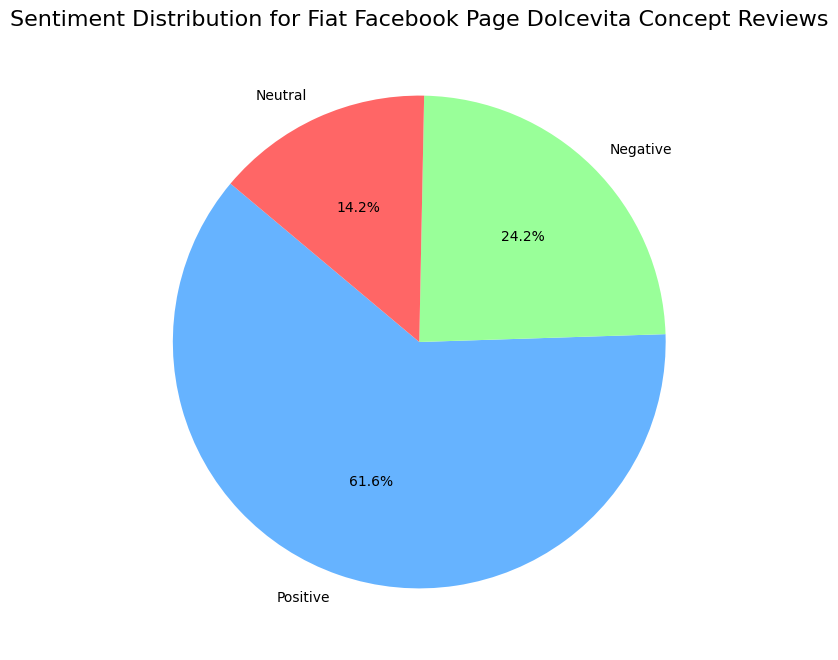

Results saved to sentiment_analyzed_with_sentiment_category_facebook_fiat_5_saved.csv


In [48]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the sentiment analyzed data
file_path = "sentiment_analyzed_comments_with_text_emojis_facebook_fiat_5.csv"
facebook1_data = pd.read_csv(file_path)

# Extract the star ratings from the sentiment labels
facebook1_data['star_rating'] = facebook1_data['sentiment'].apply(lambda x: int(x.split()[0]) if 'star' in x else None)

# Convert star ratings to sentiment categories
def star_to_sentiment(star_rating):
    if star_rating in [4, 5]:
        return 'Positive'
    elif star_rating == 3:
        return 'Neutral'
    elif star_rating in [1, 2]:
        return 'Negative'
    else:
        return None

facebook1_data['sentiment_category'] = facebook1_data['star_rating'].apply(star_to_sentiment)

# Count the occurrences of each sentiment category
sentiment_counts = facebook1_data['sentiment_category'].value_counts()

# Plot the results as a pie chart
plt.figure(figsize=(10, 8))
plt.pie(sentiment_counts, labels=sentiment_counts.index, autopct='%1.1f%%', startangle=140, colors=['#66b3ff','#99ff99','#ff6666'])

# Set plot details
plt.title('Sentiment Distribution for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)

# Save and display the plot
plt.savefig('sentiment_category_distribution_fiat_facebook_pie.png', dpi=300)
plt.show()

# Save the updated DataFrame with new columns to a new CSV file
output_file_path = "sentiment_analyzed_with_sentiment_category_facebook_fiat_5_saved.csv"
facebook1_data.to_csv(output_file_path, index=False)

print(f"Results saved to {output_file_path}")


2. VADER Approach

In [302]:
import pandas as pd
from textblob import TextBlob
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# Load the dataset
new_dataset = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
df = pd.read_csv(new_dataset)

# Ensure the 'cleaned_translated_comment' column is treated as a string
df['cleaned_translated_comment'] = df['cleaned_translated_comment'].astype(str)

# Apply TextBlob sentiment analysis to extract polarity and subjectivity
df[['polarity', 'subjectivity']] = df['cleaned_translated_comment'].apply(
    lambda Text: pd.Series(TextBlob(Text).sentiment))

# Initialize the SentimentIntensityAnalyzer
analyzer = SentimentIntensityAnalyzer()

# Apply VADER sentiment analysis
for index, row in df['cleaned_translated_comment'].items():  # Updated to use items() instead of iteritems()
    score = analyzer.polarity_scores(row)
    neg = score['neg']
    neu = score['neu']
    pos = score['pos']
    comp = score['compound']
    
    if neg > pos:
        df.loc[index, 'sentiment'] = "negative"
    elif pos > neg:
        df.loc[index, 'sentiment'] = "positive"
    else:
        df.loc[index, 'sentiment'] = "neutral"
        
    df.loc[index, 'neg'] = neg
    df.loc[index, 'neu'] = neu
    df.loc[index, 'pos'] = pos
    df.loc[index, 'compound'] = comp

# Save the updated DataFrame to a new CSV file
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_6.csv"
df.to_csv(sentiment_file_path, index=False)

# Display the first few rows to verify the changes
print(df[['cleaned_translated_comment', 'polarity', 'subjectivity', 'sentiment', 'neg', 'neu', 'pos', 'compound']].head())


               cleaned_translated_comment  polarity  subjectivity sentiment  \
0             looking dated need facelift  0.000000      0.000000   neutral   
1             looking dated need facelift  0.000000      0.000000   neutral   
2                   love fiat black heart  0.166667      0.516667  positive   
3  clough wish found fiat cute hate xoxox -0.150000      0.950000  positive   
4  clough wish found fiat cute hate xoxox -0.150000      0.950000  positive   

     neg    neu    pos  compound  
0  0.000  1.000  0.000    0.0000  
1  0.000  1.000  0.000    0.0000  
2  0.000  0.192  0.808    0.8555  
3  0.276  0.299  0.425    0.2500  
4  0.276  0.299  0.425    0.2500  


In [21]:
# Display the first 5 rows of the relevant columns in your DataFrame
# Save the updated DataFrame to a new CSV file
load_dataset = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_6.csv"
df = pd.read_csv(load_dataset)

df[["cleaned_translated_comment", "sentiment", "polarity", 
    "subjectivity", "neg", "neu", "pos"]].head(5)


,cleaned_translated_comment,sentiment,polarity,subjectivity,neg,neu,pos
0,looking dated need facelift,neutral,0.000000,0.000000,0.000,1.000,0.000
1,looking dated need facelift,neutral,0.000000,0.000000,0.000,1.000,0.000
2,love fiat black heart,positive,0.166667,0.516667,0.000,0.192,0.808
3,clough wish found fiat cute hate xoxox,positive,-0.150000,0.950000,0.276,0.299,0.425
4,clough wish found fiat cute hate xoxox,positive,-0.150000,0.950000,0.276,0.299,0.425


In [193]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import pandas as pd

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Convert to lowercase for consistency
    comment = comment.lower()
    
    # Custom rules to catch desire or unattainable wishes
    if any(phrase in comment for phrase in ["never", "if only", "but", "pricey", "sleepy face", "could change", "expensive", "help", "you should", "even", "link", "offer", "bring back", "charges", "no arm", "lost"]):
        return "negative"
    
    # Custom rule for specific positive context
    if any(phrase in comment for phrase in ["want bad", "need", "give world",  "very dated", "my next", "iconic", "legend", "lovely", "lovly", "last longer"]):
        return "positive"

    # Skip comments that are tagged persons only
    if 'tagged person' in comment:
        return None
    
    # Fallback to VADER analysis for other cases
    analyzer = SentimentIntensityAnalyzer()
    score = analyzer.polarity_scores(comment)
    
    if score['neg'] > score['pos']:
        return "negative"
    elif score['pos'] > score['neg']:
        return "positive"
    else:
        return "neutral"

# Load the dataset
df = pd.read_csv(r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_6.csv")

# Apply custom sentiment analysis, ignoring 'tagged person' comments
df['custom_sentiment'] = df['cleaned_translated_comment'].apply(custom_sentiment_analysis)

# Check the results
print(df[['cleaned_translated_comment', 'sentiment', 'custom_sentiment']].head())

# Save the updated DataFrame to a new CSV file
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df.to_csv(sentiment_file_path, index=False)


KeyboardInterrupt: 

In [190]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import pandas as pd

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Convert to lowercase for consistency
    comment = comment.lower()
    
    # Custom rules to catch phrases that indicate negative sentiment
    negative_phrases = ["never", "if only", "but", "pricey", "sleepy face", "could change", "expensive", "help", "you should", "even", "link", "offer", "bring back", "charges", "no arm", "lost",
                        "what the hell", "doesn't work", "don't like", "would love", "giraffe", "stinks", "fix", "died", "doesn't seem", "in the queue", "combustible", "scrap yard", "never seen", "why", 
                        "not be able to", "don't think so", "leaving", "disgusting", "washy", "breaks down"]
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    
    # Custom rule for specific positive context
    positive_phrases = ["want bad", "need", "give world", "very dated", "my next", "iconic", "legend", "lovely", "lovly", "last longer", "heart", "proud", "love", "can't wait",
                        "thank you", "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", "tagged person", "got few ideas", "this is the car", "it melts", "enough", 
                        "my lil", "best", "my little", "amazing", "lurrrrvve", "honoured", "great", "old"]
    if any(phrase in comment for phrase in positive_phrases):
        return "positive"
    
    # Custom rule for specific neutral context
    neutral_phrases = ["bright yellow", "slate grey"]
    if any(phrase in comment for phrase in neutral_phrases):
        return "neutral"

  
    
    # Fallback to VADER analysis for other cases
    analyzer = SentimentIntensityAnalyzer()
    score = analyzer.polarity_scores(comment)
    
    if score['neg'] > score['pos']:
        return "negative"
    elif score['pos'] > score['neg']:
        return "positive"
    else:
        return "neutral"

# Load the dataset
df = pd.read_csv(r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_6.csv")

# Apply custom sentiment analysis, ignoring 'tagged person' comments
df['custom_sentiment'] = df['cleaned_translated_comment'].apply(custom_sentiment_analysis)

# Check the results
print(df[['cleaned_translated_comment', 'sentiment', 'custom_sentiment']].head())

# Save the updated DataFrame to a new CSV file
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df.to_csv(sentiment_file_path, index=False)


               cleaned_translated_comment sentiment custom_sentiment
0             looking dated need facelift   neutral         positive
1             looking dated need facelift   neutral         positive
2                   love fiat black heart  positive         positive
3  clough wish found fiat cute hate xoxox  positive         positive
4  clough wish found fiat cute hate xoxox  positive         positive


In [192]:
import pandas as pd

# Read the updated DataFrame to a new CSV file 
df = pd.read_csv(r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv")

# Calculate the total number of positive, negative, and neutral comments
total_pos = df['custom_sentiment'].value_counts().get("positive", 0)
total_neg = df['custom_sentiment'].value_counts().get("negative", 0)
total_neu = df['custom_sentiment'].value_counts().get("neutral", 0)
total_comments = len(df)

# Print the percentages of each sentiment category
print("Total Positive Comments % : {:.2f}".format((total_pos / total_comments) * 100))
print("Total Negative Comments % : {:.2f}".format((total_neg / total_comments) * 100))
print("Total Neutral Comments % : {:.2f}".format((total_neu / total_comments) * 100))


Total Positive Comments % : 52.68
Total Negative Comments % : 14.02
Total Neutral Comments % : 33.30


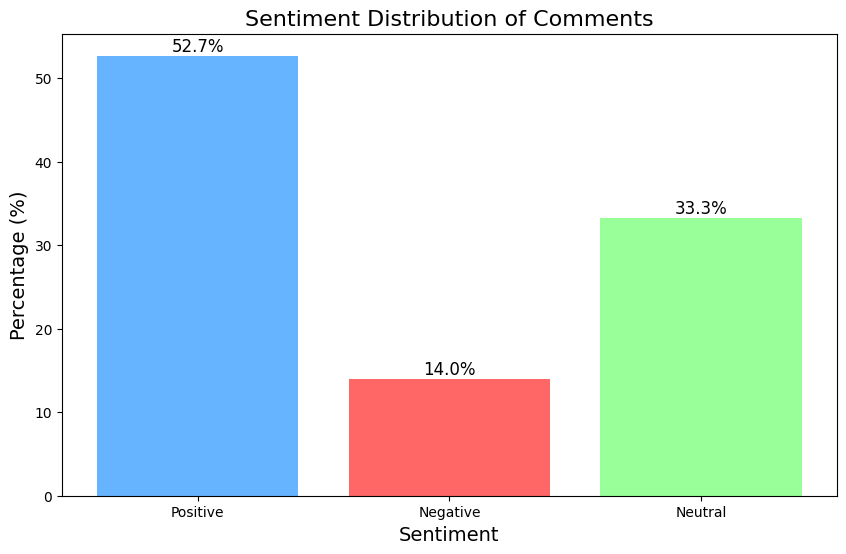

In [180]:
import matplotlib.pyplot as plt

# Calculate the total number of each sentiment
total_pos = len(df.loc[df['custom_sentiment'] == "positive"])
total_neg = len(df.loc[df['custom_sentiment'] == "negative"])
total_neu = len(df.loc[df['custom_sentiment'] == "neutral"])
total_comments = len(df)

# Labels and colors
mylabels = ["Positive", "Negative", "Neutral"]
mycolors = ["#66b3ff", "#ff6666", "#99ff99"]  # Light blue, light red, light green

# Calculate percentages
percentages = [total_pos / total_comments * 100, 
               total_neg / total_comments * 100, 
               total_neu / total_comments * 100]

# Plot the bar chart
plt.figure(figsize=(10, 6))
plt.bar(mylabels, percentages, color=mycolors)

# Add title and labels
plt.title('Sentiment Distribution of Comments', fontsize=16)
plt.xlabel('Sentiment', fontsize=14)
plt.ylabel('Percentage (%)', fontsize=14)

# Display the percentage values on the bars
for i, percentage in enumerate(percentages):
    plt.text(i, percentage + 0.5, f'{percentage:.1f}%', ha='center', fontsize=12)

# Show the bar chart
plt.show()


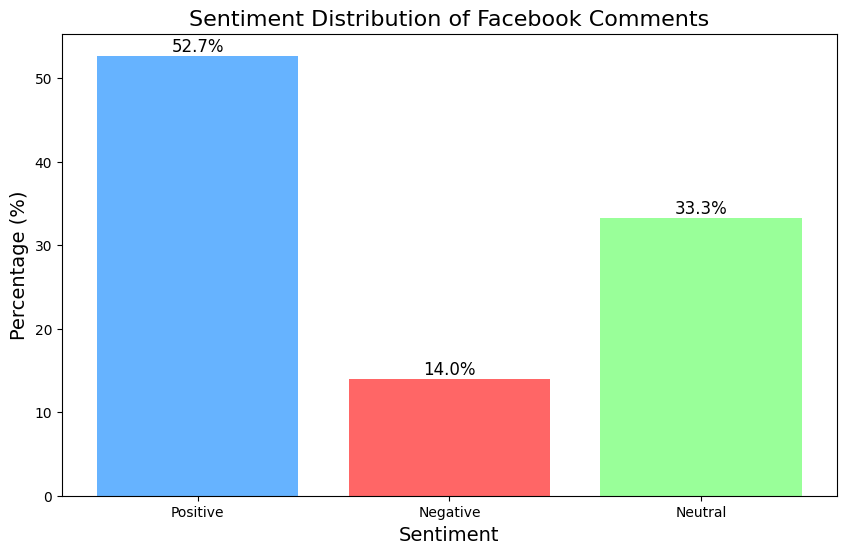

In [181]:
import matplotlib.pyplot as plt

# Calculate the total number of each sentiment
total_pos = len(df.loc[df['custom_sentiment'] == "positive"])
total_neg = len(df.loc[df['custom_sentiment'] == "negative"])
total_neu = len(df.loc[df['custom_sentiment'] == "neutral"])
total_comments = len(df)

# Labels and colors
mylabels = ["Positive", "Negative", "Neutral"]
mycolors = ["#66b3ff", "#ff6666", "#99ff99"]  # Light blue, light red, light green

# Calculate percentages
percentages = [total_pos / total_comments * 100, 
               total_neg / total_comments * 100, 
               total_neu / total_comments * 100]

# Plot the bar chart
plt.figure(figsize=(10, 6))
plt.bar(mylabels, percentages, color=mycolors)

# Add title and labels
plt.title('Sentiment Distribution of Facebook Comments', fontsize=16)
plt.xlabel('Sentiment', fontsize=14)
plt.ylabel('Percentage (%)', fontsize=14)

# Display the percentage values on the bars
for i, percentage in enumerate(percentages):
    plt.text(i, percentage + 0.5, f'{percentage:.1f}%', ha='center', fontsize=12)

# Show the bar chart
plt.show()


In [182]:
# Can you give me neutral comments?
# Filter for neutral comments
neutral_comments = df.loc[df['custom_sentiment'] == "neutral"]

# Display the first few neutral comments
print(neutral_comments[['cleaned_translated_comment']])

# If you want to save the neutral comments to a CSV file, you can use:
neutral_comments.to_csv('neutral_comments.csv', index=False)

# Or if you want to display all neutral comments, you can remove .head() or save to a file.

# can you give me positive comments?

positive_comments = df.loc[df['custom_sentiment'] == "positive"]

# Display the first few neutral comments
print(positive_comments[['cleaned_translated_comment']])

# If you want to save the neutral comments to a CSV file, you can use:
neutral_comments.to_csv('positive_comments.csv', index=False)


# can you give me negative comments?

negative_comments = df.loc[df['custom_sentiment'] == "negative"]

# Display the first few neutral comments
print(negative_comments[['cleaned_translated_comment']])

# If you want to save the neutral comments to a CSV file, you can use:
negative_comments.to_csv('negative_comments.csv', index=False)

                            cleaned_translated_comment
9                                new fiat sell belle x
10                          time fiat brought hybrid x
13                                new fiat panda panda
16                                                  xx
19                                      brigida varley
...                                                ...
2110                                 erm two week left
2111                                 erm two week left
2116            nobody reply unless site sleeping face
2118  thought relevance engine capacity fully electric
2125                                    gentleman brag

[708 rows x 1 columns]
                             cleaned_translated_comment
0                           looking dated need facelift
1                           looking dated need facelift
2                                 love fiat black heart
3                clough wish found fiat cute hate xoxox
4                clough wish found f

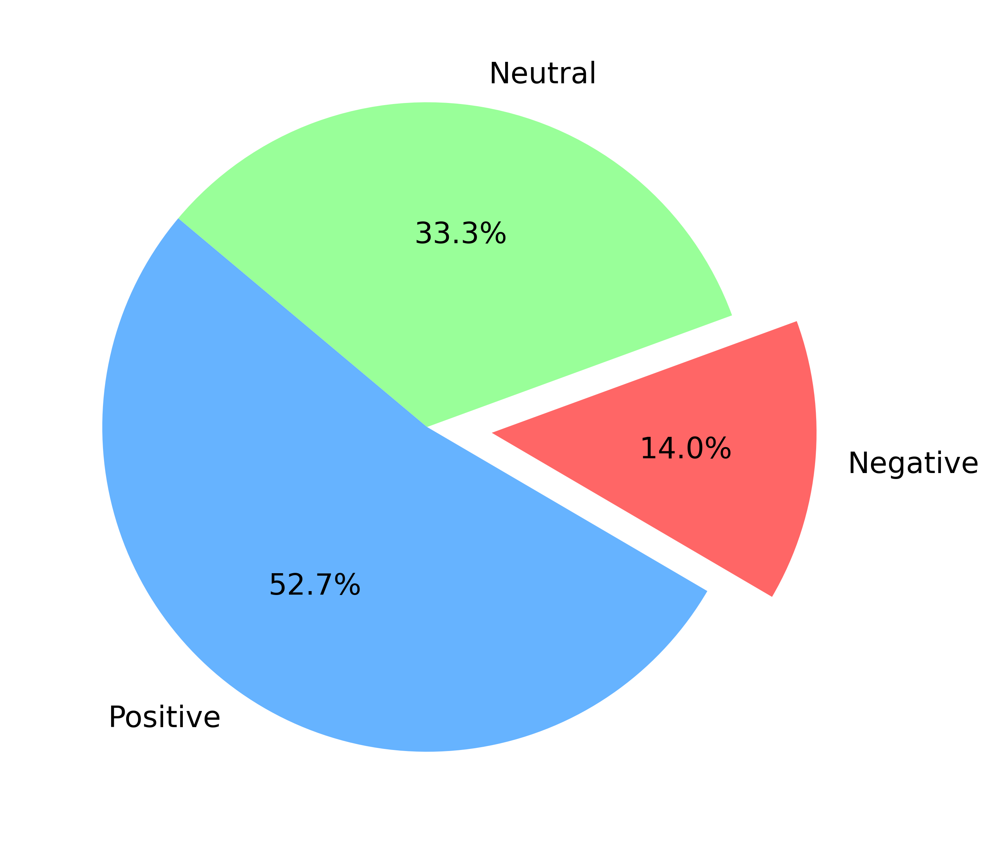

In [183]:
import matplotlib.pyplot as plt

# Calculate the total number of each sentiment
total_pos = len(df.loc[df['custom_sentiment'] == "positive"])
total_neg = len(df.loc[df['custom_sentiment'] == "negative"])
total_neu = len(df.loc[df['custom_sentiment'] == "neutral"])
total_comments = len(df)

# Labels and colors
mylabels = ["Positive", "Negative", "Neutral"]
mycolors = ["#66b3ff", "#ff6666", "#99ff99"]  # Light blue, light red, light green

# Calculate percentages
percentages = [total_pos / total_comments * 100, 
               total_neg / total_comments * 100, 
               total_neu / total_comments * 100]

# Set up the pie chart
plt.figure(figsize=(8, 5), dpi=600)
myexplode = [0, 0.2, 0]  # Explode the "Negative" slice

# Plot the pie chart with percentages
plt.pie(percentages, colors=mycolors, labels=mylabels, explode=myexplode, autopct='%1.1f%%', startangle=140)

# Display the pie chart
plt.show()


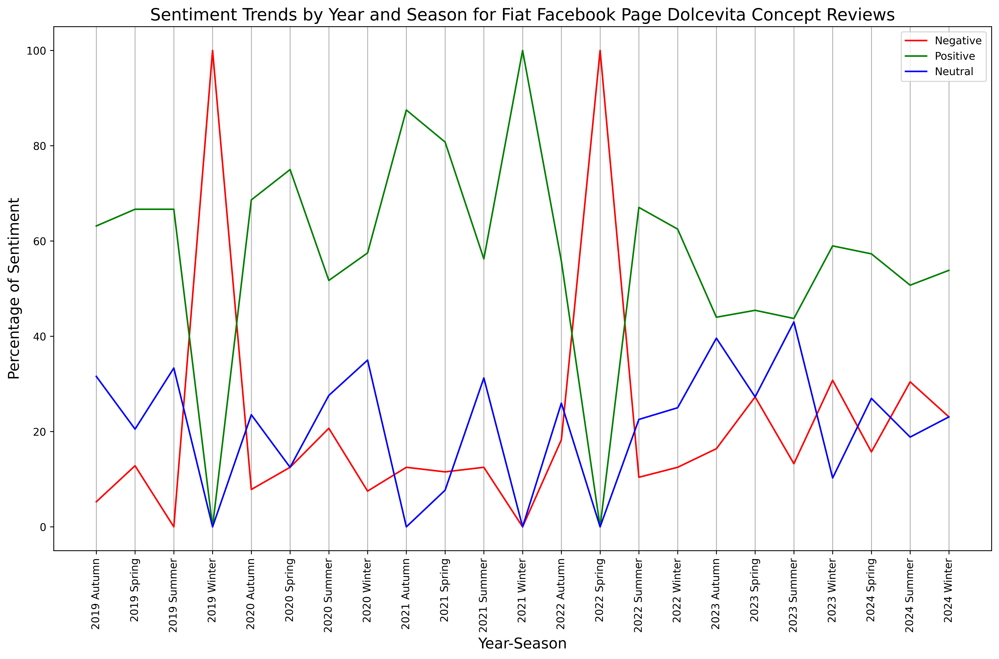

In [184]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"

facebook8_data = pd.read_csv(sentiment_file_path)

# Ensure there's a 'comment_date' column and extract the year and month
facebook8_data['year'] = pd.to_datetime(facebook8_data['comment_date']).dt.year
facebook8_data['month'] = pd.to_datetime(facebook8_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

# Apply the function to get the season
facebook8_data['season'] = facebook8_data['month'].apply(month_to_season)

# Combine year and season into a single column for grouping
facebook8_data['year_season'] = facebook8_data['year'].astype(str) + ' ' + facebook8_data['season']

# Initialize lists to store sentiment percentages per season-year
pos_list = []
neg_list = []
neu_list = []

# Loop through each unique year-season
for i in facebook8_data["year_season"].unique():
    temp = facebook8_data[facebook8_data["year_season"] == i]
    positive_temp = temp[temp["custom_sentiment"] == "positive"]
    negative_temp = temp[temp["custom_sentiment"] == "negative"]
    neutral_temp = temp[temp["custom_sentiment"] == "neutral"]
    
    pos_list.append(((positive_temp.shape[0] / temp.shape[0]) * 100, i))
    neg_list.append(((negative_temp.shape[0] / temp.shape[0]) * 100, i))
    neu_list.append(((neutral_temp.shape[0] / temp.shape[0]) * 100, i))

# Sort the lists by year_season
neu_list = sorted(neu_list, key=lambda x: x[1])
pos_list = sorted(pos_list, key=lambda x: x[1])
neg_list = sorted(neg_list, key=lambda x: x[1])

# Extract x and y coordinates for plotting
x_cord_neg = [i[1] for i in neg_list]
y_cord_neg = [i[0] for i in neg_list]

x_cord_pos = [i[1] for i in pos_list]
y_cord_pos = [i[0] for i in pos_list]

x_cord_neu = [i[1] for i in neu_list]
y_cord_neu = [i[0] for i in neu_list]

# Plot the sentiment trends over time
plt.figure(figsize=(16, 9), dpi=600)
plt.plot(x_cord_neg, y_cord_neg, label="Negative", color="red")
plt.plot(x_cord_pos, y_cord_pos, label="Positive", color="green")
plt.plot(x_cord_neu, y_cord_neu, label="Neutral", color="blue")

plt.xticks(rotation=90)
plt.grid(axis='x')
plt.legend()

# Title and labels
plt.title('Sentiment Trends by Year and Season for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)
plt.xlabel('Year-Season', fontsize=14)
plt.ylabel('Percentage of Sentiment', fontsize=14)

# Save and display the plot
plt.savefig('sentiment_trends_by_year_season_fiat_facebook_9.png', dpi=300)
plt.show()


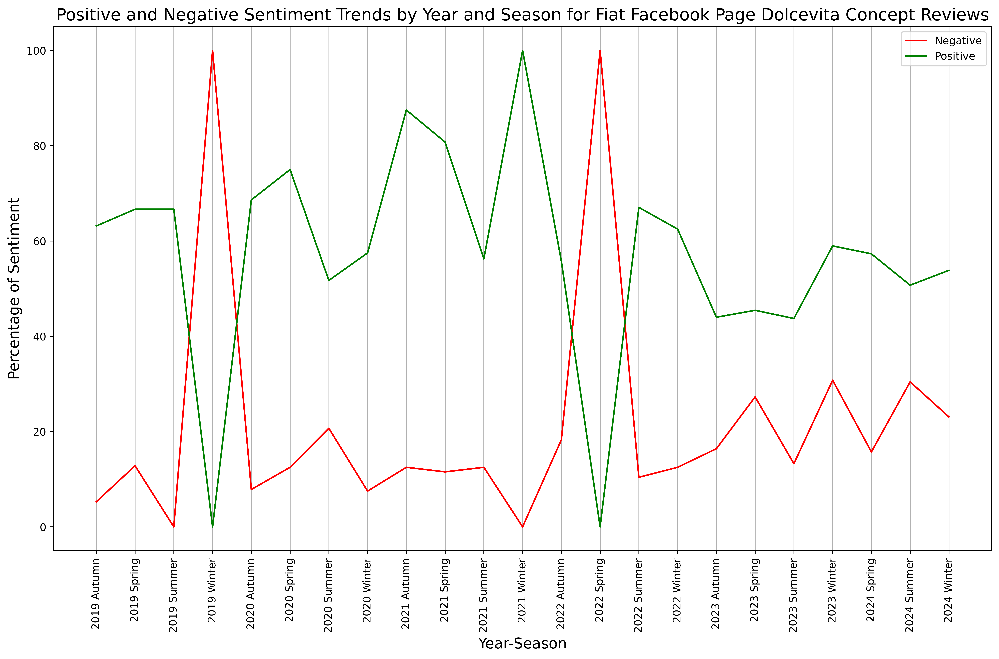

In [185]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"

facebook8_data = pd.read_csv(sentiment_file_path)

# Ensure there's a 'comment_date' column and extract the year and month
facebook8_data['year'] = pd.to_datetime(facebook8_data['comment_date']).dt.year
facebook8_data['month'] = pd.to_datetime(facebook8_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

# Apply the function to get the season
facebook8_data['season'] = facebook8_data['month'].apply(month_to_season)

# Combine year and season into a single column for grouping
facebook8_data['year_season'] = facebook8_data['year'].astype(str) + ' ' + facebook8_data['season']

# Initialize lists to store sentiment percentages per season-year
pos_list = []
neg_list = []

# Loop through each unique year-season
for i in facebook8_data["year_season"].unique():
    temp = facebook8_data[facebook8_data["year_season"] == i]
    positive_temp = temp[temp["custom_sentiment"] == "positive"]
    negative_temp = temp[temp["custom_sentiment"] == "negative"]
    
    pos_list.append(((positive_temp.shape[0] / temp.shape[0]) * 100, i))
    neg_list.append(((negative_temp.shape[0] / temp.shape[0]) * 100, i))

# Sort the lists by year_season
pos_list = sorted(pos_list, key=lambda x: x[1])
neg_list = sorted(neg_list, key=lambda x: x[1])

# Extract x and y coordinates for plotting
x_cord_neg = [i[1] for i in neg_list]
y_cord_neg = [i[0] for i in neg_list]

x_cord_pos = [i[1] for i in pos_list]
y_cord_pos = [i[0] for i in pos_list]

# Plot the sentiment trends over time (positive and negative only)
plt.figure(figsize=(16, 9), dpi=600)
plt.plot(x_cord_neg, y_cord_neg, label="Negative", color="red")
plt.plot(x_cord_pos, y_cord_pos, label="Positive", color="green")

plt.xticks(rotation=90)
plt.grid(axis='x')
plt.legend()

# Title and labels
plt.title('Positive and Negative Sentiment Trends by Year and Season for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)
plt.xlabel('Year-Season', fontsize=14)
plt.ylabel('Percentage of Sentiment', fontsize=14)

# Save and display the plot
plt.savefig('positive_negative_sentiment_trends_by_year_season_fiat_facebook_3.png', dpi=300)
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook8_data = pd.read_csv(sentiment_file_path)

# Ensure there's a 'comment_date' column and extract the year
facebook8_data['year'] = pd.to_datetime(facebook8_data['comment_date']).dt.year

# Initialize lists to store sentiment percentages per year
yearly_sentiment = []

# Loop through each unique year
for year in sorted(facebook8_data["year"].unique()):
    temp = facebook8_data[facebook8_data["year"] == year]
    positive_temp = temp[temp["custom_sentiment"] == "positive"]
    negative_temp = temp[temp["custom_sentiment"] == "negative"]
    
    pos_percentage = (positive_temp.shape[0] / temp.shape[0]) * 100
    neg_percentage = (negative_temp.shape[0] / temp.shape[0]) * 100
    
    yearly_sentiment.append({'year': year, 'positive': pos_percentage, 'negative': neg_percentage})

# Convert to DataFrame
yearly_sentiment_df = pd.DataFrame(yearly_sentiment)

# Calculate year-over-year percentage change
yearly_sentiment_df['positive_change'] = yearly_sentiment_df['positive'].pct_change() * 100
yearly_sentiment_df['negative_change'] = yearly_sentiment_df['negative'].pct_change() * 100

# Fill NaN values with 0 for the first year since there's no previous year to compare
yearly_sentiment_df = yearly_sentiment_df.fillna(0)

# Display the DataFrame
print(yearly_sentiment_df)

# Plotting the year-over-year change in sentiment percentages
plt.figure(figsize=(14, 8), dpi=300)
plt.bar(yearly_sentiment_df['year'] - 0.2, yearly_sentiment_df['positive_change'], width=0.4, label='Positive Change', color='#1f77b4')  # Blue color
plt.bar(yearly_sentiment_df['year'] + 0.2, yearly_sentiment_df['negative_change'], width=0.4, label='Negative Change', color='#ff7f0e')  # Orange color

plt.xlabel('Year')
plt.ylabel('Year-Over-Year Change (%)')
plt.title('Year-Over-Year Change in Positive and Negative Sentiment Percentages')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(yearly_sentiment_df['year'])
plt.legend()

# Save and display the plot
plt.savefig('year_over_year_change_sentiment_fiat_facebook.png', dpi=300)
plt.show()


   year   positive   negative  positive_change  negative_change
0  2019  63.878327   6.083650         0.000000         0.000000
1  2020  63.687151  10.055866        -0.299282        65.293296
2  2021  76.363636  10.909091        19.904306         8.484848
3  2022  61.937716  14.532872       -18.891086        33.217993
4  2023  44.824636  15.226689       -27.629498         4.774125
5  2024  54.385965  22.222222        21.330521        45.942572


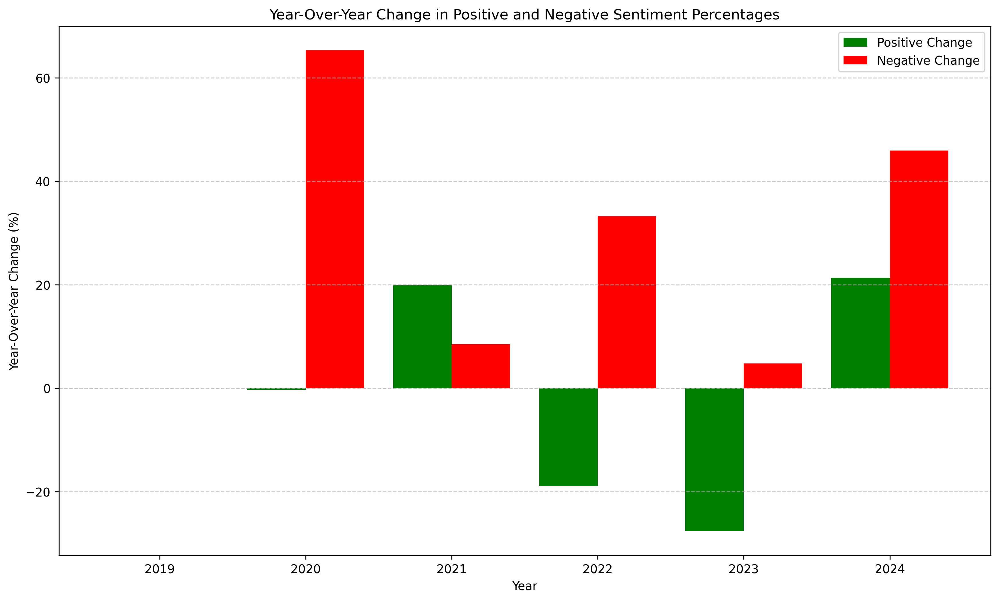

In [186]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook8_data = pd.read_csv(sentiment_file_path)

# Ensure there's a 'comment_date' column and extract the year
facebook8_data['year'] = pd.to_datetime(facebook8_data['comment_date']).dt.year

# Initialize lists to store sentiment percentages per year
yearly_sentiment = []

# Loop through each unique year
for year in sorted(facebook8_data["year"].unique()):
    temp = facebook8_data[facebook8_data["year"] == year]
    positive_temp = temp[temp["custom_sentiment"] == "positive"]
    negative_temp = temp[temp["custom_sentiment"] == "negative"]
    
    pos_percentage = (positive_temp.shape[0] / temp.shape[0]) * 100
    neg_percentage = (negative_temp.shape[0] / temp.shape[0]) * 100
    
    yearly_sentiment.append({'year': year, 'positive': pos_percentage, 'negative': neg_percentage})

# Convert to DataFrame
yearly_sentiment_df = pd.DataFrame(yearly_sentiment)

# Calculate year-over-year percentage change
yearly_sentiment_df['positive_change'] = yearly_sentiment_df['positive'].pct_change() * 100
yearly_sentiment_df['negative_change'] = yearly_sentiment_df['negative'].pct_change() * 100

# Fill NaN values with 0 for the first year since there's no previous year to compare
yearly_sentiment_df = yearly_sentiment_df.fillna(0)

# Display the DataFrame
print(yearly_sentiment_df)

# Plotting the year-over-year change in sentiment percentages
plt.figure(figsize=(14, 8), dpi=300)
plt.bar(yearly_sentiment_df['year'] - 0.2, yearly_sentiment_df['positive_change'], width=0.4, label='Positive Change', color='green')
plt.bar(yearly_sentiment_df['year'] + 0.2, yearly_sentiment_df['negative_change'], width=0.4, label='Negative Change', color='red')

plt.xlabel('Year')
plt.ylabel('Year-Over-Year Change (%)')
plt.title('Year-Over-Year Change in Positive and Negative Sentiment Percentages')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(yearly_sentiment_df['year'])
plt.legend()

# Save and display the plot
plt.savefig('year_over_year_change_sentiment_fiat_facebook.png', dpi=300)
plt.show()


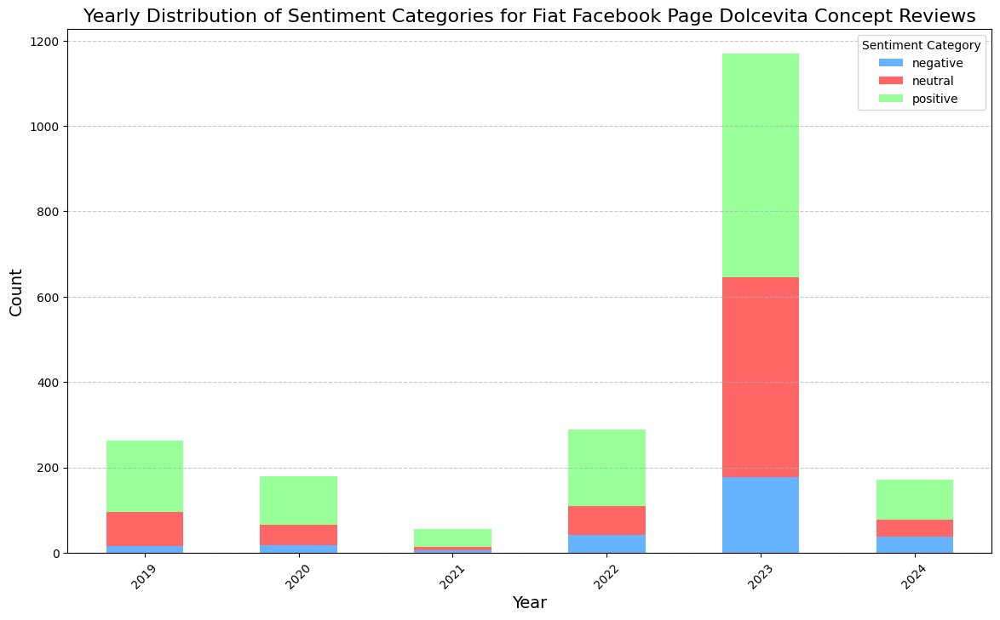

In [187]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the sentiment analyzed data
file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook1_data = pd.read_csv(file_path)

# Ensure there's a 'comment_date' column and extract the year
facebook1_data['year'] = pd.to_datetime(facebook1_data['comment_date']).dt.year

# Group the data by year and sentiment category, then count occurrences
sentiment_by_year = facebook1_data.groupby(['year', 'custom_sentiment']).size().unstack().fillna(0)

# Plot the results as a stacked bar chart
sentiment_by_year.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#66b3ff', '#ff6666', '#99ff99'])

# Set plot details
plt.title('Yearly Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Sentiment Category')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_category_distribution_by_year_fiat_2_facebook.png', dpi=300)
plt.show()


<Figure size 1400x800 with 0 Axes>

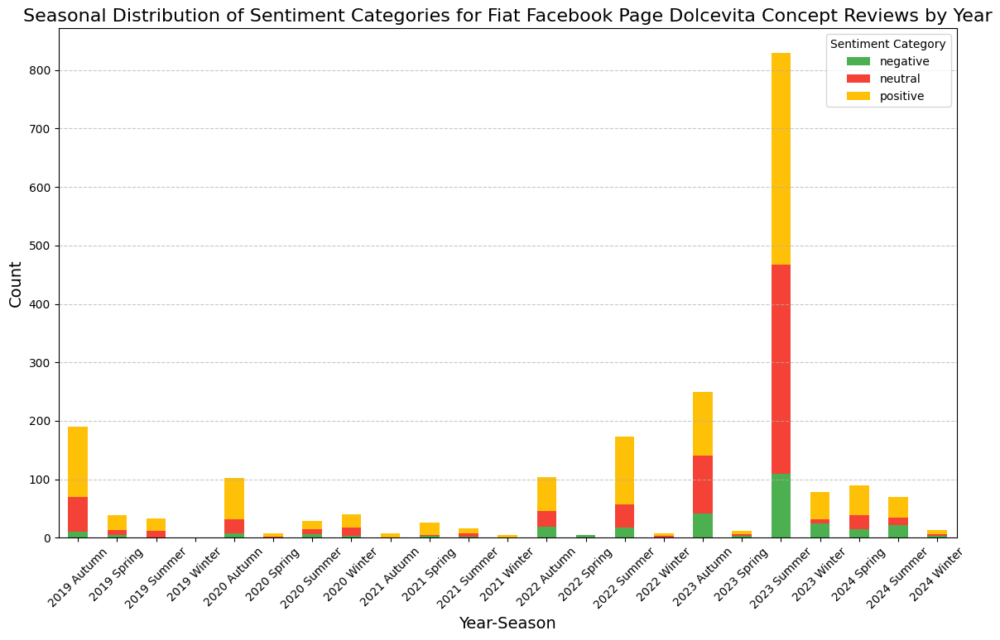

In [194]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the sentiment analyzed data
file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook1_data = pd.read_csv(file_path)

# Ensure there's a 'comment_date' column and extract the year and month
facebook1_data['year'] = pd.to_datetime(facebook1_data['comment_date']).dt.year
facebook1_data['month'] = pd.to_datetime(facebook1_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

facebook1_data['season'] = facebook1_data['month'].apply(month_to_season)

# Combine year and season into a single column for grouping
facebook1_data['year_season'] = facebook1_data['year'].astype(str) + ' ' + facebook1_data['season']

# Group the data by year_season and sentiment category, then count occurrences
sentiment_by_year_season = facebook1_data.groupby(['year_season', 'custom_sentiment']).size().unstack().fillna(0)

# Plot the results as a stacked bar chart
plt.figure(figsize=(14, 8))
sentiment_by_year_season.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#4CAF50', '#F44336', '#FFC107'])

# Set plot details
plt.title('Seasonal Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews by Year', fontsize=16)
plt.xlabel('Year-Season', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Sentiment Category')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_category_distribution_by_year_season_fiat_facebook.png', dpi=300)
plt.show()


custom_sentiment    negative    neutral    positive
year_season                                        
2019 Autumn         5.263158  31.578947   63.157895
2019 Spring        12.820513  20.512821   66.666667
2019 Summer         0.000000  33.333333   66.666667
2019 Winter       100.000000   0.000000    0.000000
2020 Autumn         7.843137  23.529412   68.627451
2020 Spring        12.500000  12.500000   75.000000
2020 Summer        20.689655  27.586207   51.724138
2020 Winter         7.500000  35.000000   57.500000
2021 Autumn        12.500000   0.000000   87.500000
2021 Spring        11.538462   7.692308   80.769231
2021 Summer        12.500000  31.250000   56.250000
2021 Winter         0.000000   0.000000  100.000000
2022 Autumn        18.269231  25.961538   55.769231
2022 Spring       100.000000   0.000000    0.000000
2022 Summer        10.404624  22.543353   67.052023
2022 Winter        12.500000  25.000000   62.500000
2023 Autumn        16.400000  39.600000   44.000000
2023 Spring 

<Figure size 1400x800 with 0 Axes>

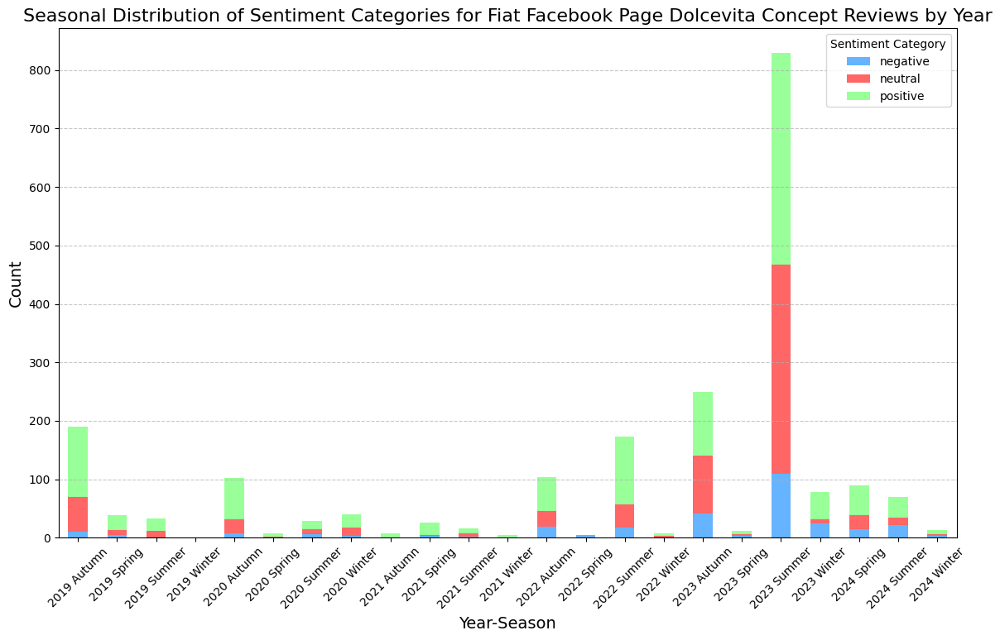

In [197]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the sentiment analyzed data
file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook1_data = pd.read_csv(file_path)

# Ensure there's a 'comment_date' column and extract the year and month
facebook1_data['year'] = pd.to_datetime(facebook1_data['comment_date']).dt.year
facebook1_data['month'] = pd.to_datetime(facebook1_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

facebook1_data['season'] = facebook1_data['month'].apply(month_to_season)

# Combine year and season into a single column for grouping
facebook1_data['year_season'] = facebook1_data['year'].astype(str) + ' ' + facebook1_data['season']

# Group the data by year_season and sentiment category, then count occurrences
sentiment_by_year_season = facebook1_data.groupby(['year_season', 'custom_sentiment']).size().unstack().fillna(0)

# Calculate percentages
sentiment_percentage = sentiment_by_year_season.div(sentiment_by_year_season.sum(axis=1), axis=0) * 100

# Display the percentage table
print(sentiment_percentage)

# Optionally, save the percentage table to a CSV file
sentiment_percentage.to_csv('sentiment_category_percentage_by_year_season_fiat_facebook.csv')

# Plot the results as a stacked bar chart
plt.figure(figsize=(14, 8))
sentiment_by_year_season.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#66b3ff', '#ff6666', '#99ff99'])

# Set plot details
plt.title('Seasonal Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews by Year', fontsize=16)
plt.xlabel('Year-Season', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Sentiment Category')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_category_distribution_by_year_season_fiat_facebook_4.png', dpi=300)
plt.show()


<Figure size 1400x800 with 0 Axes>

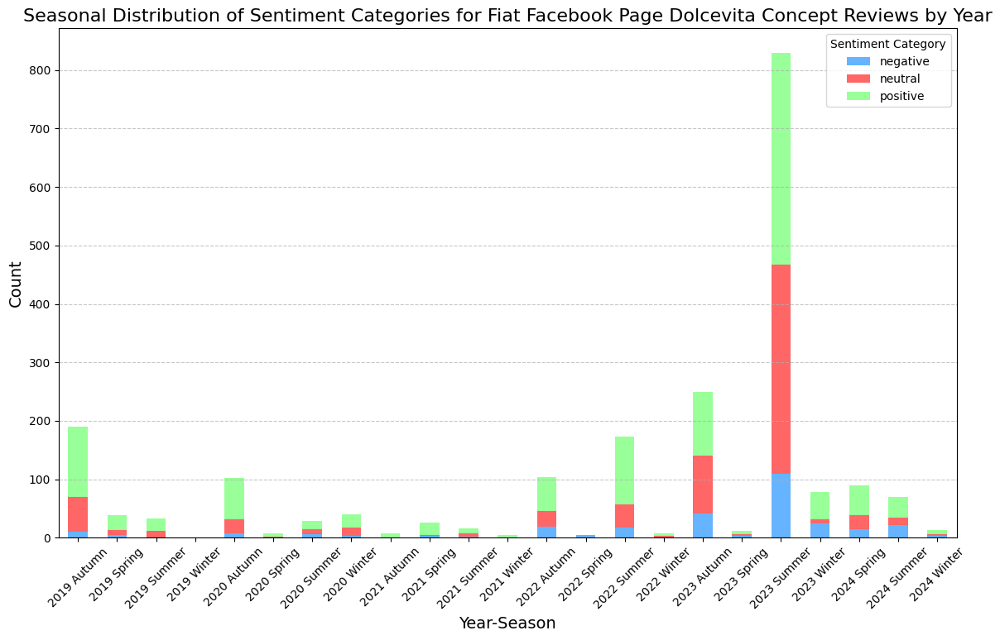

In [195]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the sentiment analyzed data
file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook1_data = pd.read_csv(file_path)

# Ensure there's a 'comment_date' column and extract the year and month
facebook1_data['year'] = pd.to_datetime(facebook1_data['comment_date']).dt.year
facebook1_data['month'] = pd.to_datetime(facebook1_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

facebook1_data['season'] = facebook1_data['month'].apply(month_to_season)

# Combine year and season into a single column for grouping
facebook1_data['year_season'] = facebook1_data['year'].astype(str) + ' ' + facebook1_data['season']

# Group the data by year_season and sentiment category, then count occurrences
sentiment_by_year_season = facebook1_data.groupby(['year_season', 'custom_sentiment']).size().unstack().fillna(0)

# Plot the results as a stacked bar chart
plt.figure(figsize=(14, 8))
sentiment_by_year_season.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#66b3ff', '#ff6666', '#99ff99'])

# Set plot details
plt.title('Seasonal Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews by Year', fontsize=16)
plt.xlabel('Year-Season', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Sentiment Category')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_category_distribution_by_year_season_fiat_facebook_4.png', dpi=300)
plt.show()


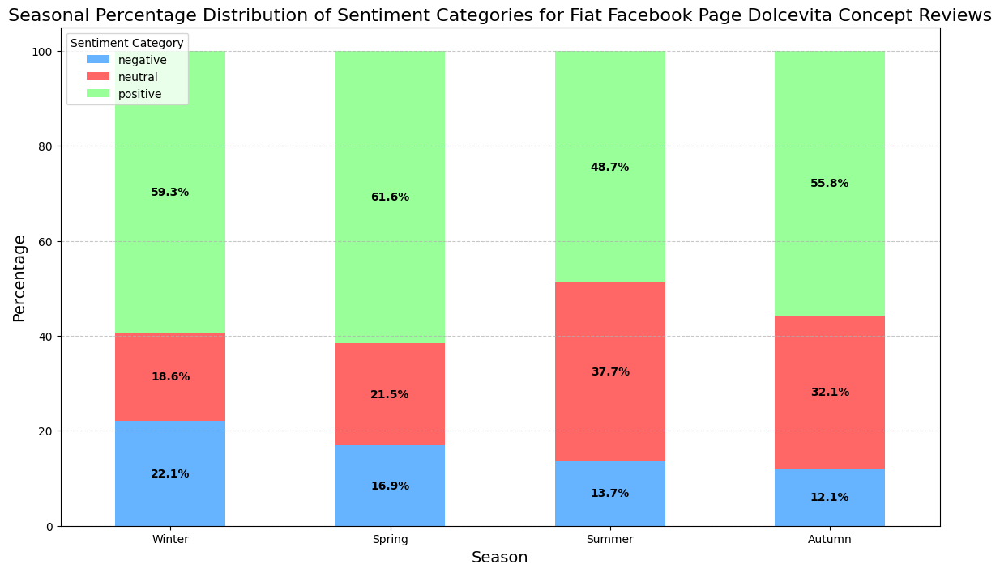

In [254]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the sentiment analyzed data
file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook1_data = pd.read_csv(file_path)

# Ensure there's a 'comment_date' column and extract the month
facebook1_data['month'] = pd.to_datetime(facebook1_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

facebook1_data['season'] = facebook1_data['month'].apply(month_to_season)

# Group the data by season and sentiment category, then count occurrences
sentiment_by_season = facebook1_data.groupby(['season', 'custom_sentiment']).size().unstack().fillna(0)

# Convert counts to percentages
sentiment_by_season_percentage = sentiment_by_season.div(sentiment_by_season.sum(axis=1), axis=0) * 100

# Plot the results as a stacked bar chart with percentages
sentiment_by_season_percentage = sentiment_by_season_percentage.reindex(['Winter', 'Spring', 'Summer', 'Autumn'])  # Ensure seasons are in order
ax = sentiment_by_season_percentage.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#66b3ff', '#ff6666', '#99ff99'])

# Annotate the bars with the percentage values
for p in ax.patches:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy() 
    if height > 0:  # Avoid printing 0% labels
        ax.annotate(f'{height:.1f}%', (x + width/2, y + height/2), ha='center', va='center', fontsize=10, color='black', weight='bold')

# Set plot details
plt.title('Seasonal Percentage Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)
plt.xlabel('Season', fontsize=14)
plt.ylabel('Percentage', fontsize=14)
plt.xticks(rotation=0)
plt.legend(title='Sentiment Category', loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_category_percentage_distribution_by_season_fiat_facebook.png', dpi=300)
plt.show()


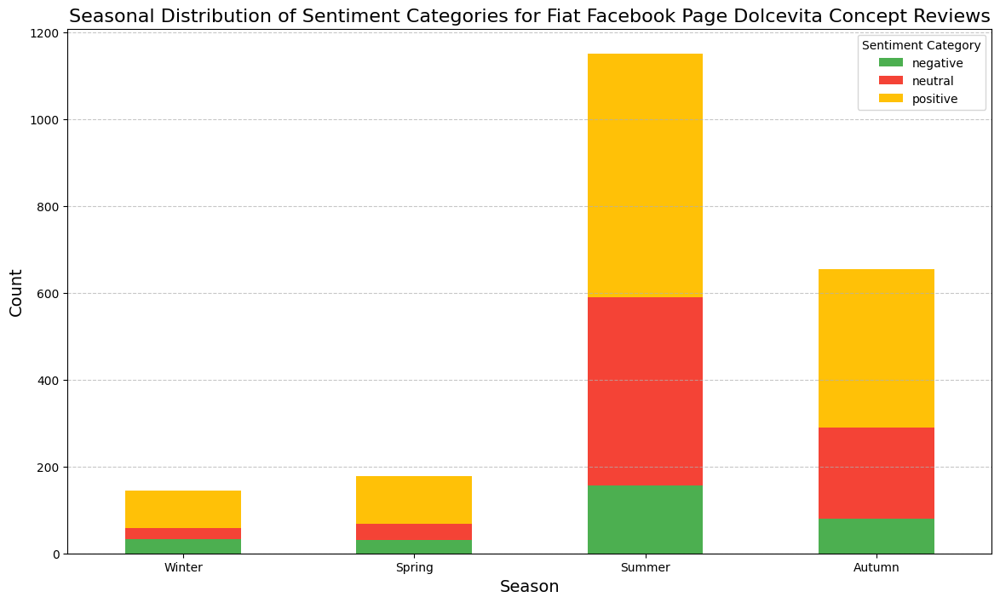

In [249]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the sentiment analyzed data
file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook1_data = pd.read_csv(file_path)

# Ensure there's a 'comment_date' column and extract the month
facebook1_data['month'] = pd.to_datetime(facebook1_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

facebook1_data['season'] = facebook1_data['month'].apply(month_to_season)

# Group the data by season and sentiment category, then count occurrences
sentiment_by_season = facebook1_data.groupby(['season', 'custom_sentiment']).size().unstack().fillna(0)

# Plot the results as a stacked bar chart
sentiment_by_season = sentiment_by_season.reindex(['Winter', 'Spring', 'Summer', 'Autumn'])  # Ensure seasons are in order
sentiment_by_season.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#4CAF50', '#F44336', '#FFC107'])

# Set plot details
plt.title('Seasonal Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews', fontsize=16)
plt.xlabel('Season', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=0)
plt.legend(title='Sentiment Category')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_category_distribution_by_season_fiat_facebook.png', dpi=300)
plt.show()


<Figure size 1400x800 with 0 Axes>

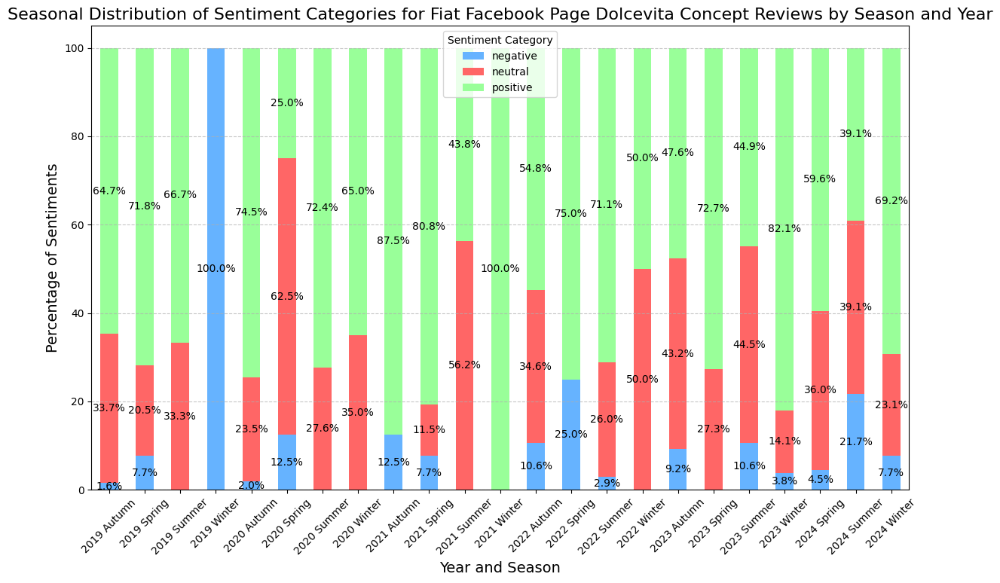

In [199]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the sentiment analyzed data
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
facebook_data = pd.read_csv(sentiment_file_path)

# Ensure there's a 'comment_date' column and extract the year and month
facebook_data['year'] = pd.to_datetime(facebook_data['comment_date']).dt.year
facebook_data['month'] = pd.to_datetime(facebook_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

facebook_data['season'] = facebook_data['month'].apply(month_to_season)

# Combine year and season into a single column for grouping
facebook_data['year_season'] = facebook_data['year'].astype(str) + ' ' + facebook_data['season']

# Group the data by year_season and sentiment category, then count occurrences
sentiment_by_year_season = facebook_data.groupby(['year_season', 'sentiment']).size().unstack().fillna(0)

# Calculate the percentages
sentiment_by_year_season_percent = sentiment_by_year_season.div(sentiment_by_year_season.sum(axis=1), axis=0) * 100

# Plot the results as a stacked bar chart
plt.figure(figsize=(14, 8))
ax = sentiment_by_year_season_percent.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#66b3ff', '#ff6666', '#99ff99'])

# Annotate the bars with percentage values
for p in ax.patches:
    width = p.get_width()
    height = p.get_height()
    x = p.get_x()
    y = p.get_y()
    if height > 0:  # Avoid placing text on bars with height zero
        ax.text(x + width / 2, y + height / 2, f'{height:.1f}%', ha='center', va='center', fontsize=10, color='black')

# Set plot details
plt.title('Seasonal Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews by Season and Year', fontsize=16)
plt.xlabel('Year and Season', fontsize=14)
plt.ylabel('Percentage of Sentiments', fontsize=14)
plt.xticks(rotation=45)  # Rotate labels to improve readability
plt.legend(title='Sentiment Category')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.savefig('sentiment_distribution_by_season_fiat_facebook.png', dpi=300)
plt.show()


            post_count  negative   neutral  positive
post_count    1.000000  0.900888  0.947325  0.977339
negative      0.900888  1.000000  0.991136  0.961407
neutral       0.947325  0.991136  1.000000  0.989413
positive      0.977339  0.961407  0.989413  1.000000


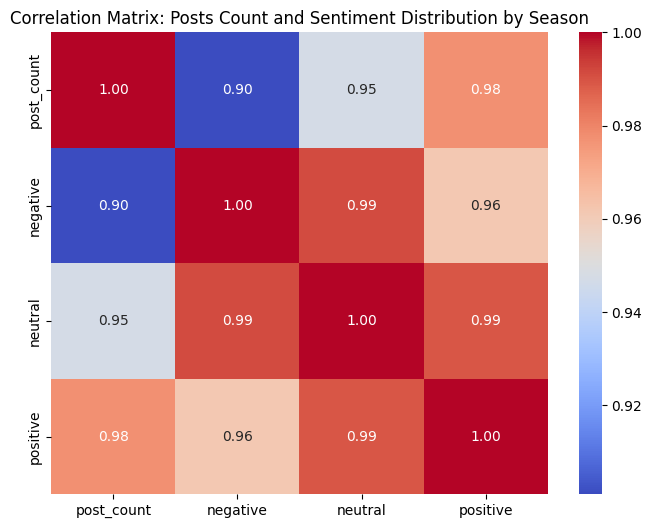

In [257]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset with post details
file_path_posts = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'  
df_posts = pd.read_csv(file_path_posts)

# Load the sentiment analyzed data
file_path_sentiment = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df_sentiment = pd.read_csv(file_path_sentiment)

# Convert 'comment_date' to datetime
df_posts['comment_date'] = pd.to_datetime(df_posts['comment_date'])
df_sentiment['comment_date'] = pd.to_datetime(df_sentiment['comment_date'])

# Extract the month and define the season in both datasets
df_posts['month'] = df_posts['comment_date'].dt.month
df_sentiment['month'] = df_sentiment['comment_date'].dt.month

def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

df_posts['season'] = df_posts['month'].apply(month_to_season)
df_sentiment['season'] = df_sentiment['month'].apply(month_to_season)

# Count the number of unique posts per season
posts_per_season = df_posts.groupby('season')['post_id'].nunique().reset_index(name='post_count')

# Calculate the sentiment distribution by season and count occurrences
sentiment_by_season = df_sentiment.groupby(['season', 'sentiment']).size().unstack().fillna(0)

# Merge the posts count and sentiment data
merged_data = posts_per_season.set_index('season').join(sentiment_by_season)

# Calculate the correlation matrix
correlation_matrix = merged_data.corr()

# Display the correlation matrix
print(correlation_matrix)

# Plot the correlation matrix
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix: Posts Count and Sentiment Distribution by Season')
plt.show()


There is a strong positive correlation between the number of posts (post_count) and all sentiment categories (negative, neutral, positive). This indicates that as the number of posts increases, the sentiment counts across all categories also tend to increase.


Cramér's V: 0.09


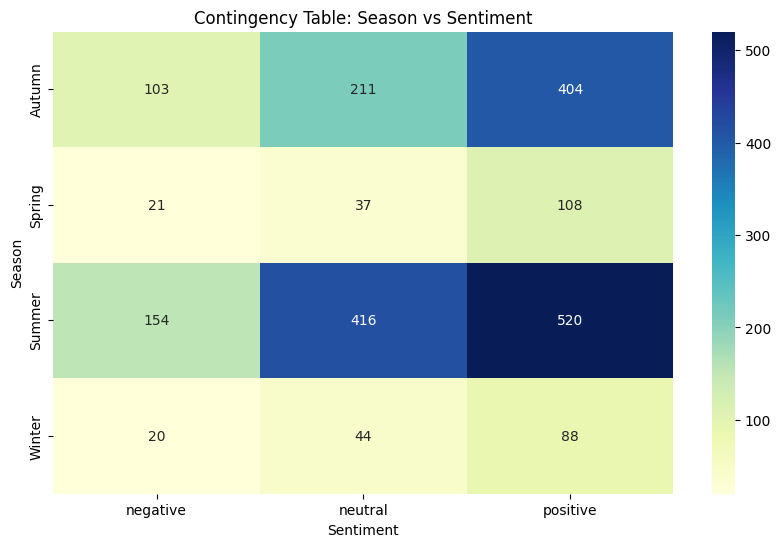

In [260]:
import pandas as pd
import numpy as np
from scipy.stats import chi2_contingency
import seaborn as sns
import matplotlib.pyplot as plt

# Load the dataset
file_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_new_dataset_4.csv'  
df_posts = pd.read_csv(file_path)


# Load the sentiment analyzed data
file_path_sentiment = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df_sentiment = pd.read_csv(file_path_sentiment)

# Convert 'comment_date' to datetime
df_posts['comment_date'] = pd.to_datetime(df_posts['comment_date'])

# Extract the month and define the season
df_posts['month'] = df_posts['comment_date'].dt.month

def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

df_posts['season'] = df_posts['month'].apply(month_to_season)

# Create a contingency table
contingency_table = pd.crosstab(df_posts['season'], df_sentiment['custom_sentiment'])

# Calculate Cramér's V
chi2, p, dof, ex = chi2_contingency(contingency_table)

n = contingency_table.sum().sum()
cramers_v = np.sqrt(chi2 / (n * (min(contingency_table.shape) - 1)))

print(f"Cramér's V: {cramers_v:.2f}")

# Plot the contingency table as a heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(contingency_table, annot=True, fmt="d", cmap="YlGnBu")
plt.title("Contingency Table: Season vs Sentiment")
plt.ylabel("Season")
plt.xlabel("Sentiment")
plt.show()


<Figure size 1400x800 with 0 Axes>

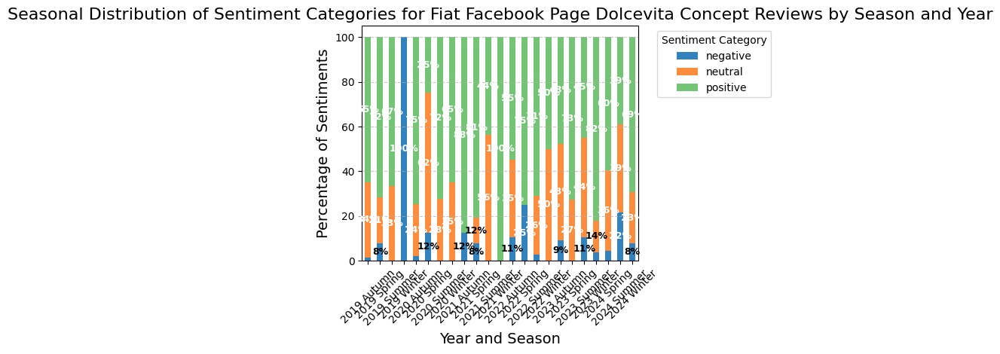

In [200]:
import matplotlib.pyplot as plt

plt.figure(figsize=(14, 8))
ax = sentiment_by_year_season_percent.plot(kind='bar', stacked=True, color=['#3182bd', '#fd8d3c', '#74c476'])
plt.title('Seasonal Distribution of Sentiment Categories for Fiat Facebook Page Dolcevita Concept Reviews by Season and Year', fontsize=16)
plt.xlabel('Year and Season', fontsize=14)
plt.ylabel('Percentage of Sentiments', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Sentiment Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Enhancing annotations
for rect in ax.patches:
    # Get rectangle bounds
    width, height = rect.get_width(), rect.get_height()
    x, y = rect.get_x(), rect.get_y()
    label_text = f'{height:.0f}%'  # the label text
    label_x = x + width / 2  # text x-position
    label_y = y + height / 2  # text y-position

    # Only add annotations if the height is sufficient to be visible
    if height > 5:  # Adjust this threshold based on your preference
        ax.text(label_x, label_y, label_text, ha='center', va='center', fontsize=9, color='white' if height > 20 else 'black', fontweight='bold')

plt.tight_layout()
plt.savefig('enhanced_sentiment_distribution.png', dpi=300)
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the sentiment analyzed data
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
youtube_data = pd.read_csv(file_path)

# Ensure there's a 'comment_date' column and extract the year and month
youtube_data['year'] = pd.to_datetime(youtube_data['comment_date']).dt.year
youtube_data['month'] = pd.to_datetime(youtube_data['comment_date']).dt.month

# Define the seasons based on the month
def month_to_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None

youtube_data['season'] = youtube_data['month'].apply(month_to_season)

# Combine year and season into a single column for grouping
youtube_data['year_season'] = youtube_data['year'].astype(str) + ' ' + youtube_data['season']

# Group the data by year_season and sentiment category, then count occurrences
sentiment_by_year_season = youtube_data.groupby(['year_season', 'sentiment']).size().unstack().fillna(0)

# Calculate the percentages
sentiment_by_year_season_percent = sentiment_by_year_season.div(sentiment_by_year_season.sum(axis=1), axis=0) * 100

# Plot the results as a stacked bar chart
plt.figure(figsize=(14, 8))
ax = sentiment_by_year_season_percent.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#66b3ff', '#ff6666', '#99ff99'])

# Annotate the bars with percentage values
for p in ax.patches:
    width = p.get_width()
    height = p.get_height()
    x = p.get_x()
    y = p.get_y()
    if height > 0:  # Avoid placing text on bars with height zero
        ax.text(x + width / 2, y + height / 2, f'{height:.1f}%', ha='center', va='center', fontsize=10, color='black')

# Set plot details
plt.title('Seasonal Distribution of Sentiment Categories for Volkswagen Golf Youtube Reviews by Season and Year', fontsize=16)
plt.xlabel

In [238]:
# Load the sentiment analyzed data
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
facebook_data = pd.read_csv(sentiment_file_path)

# Display the first few rows and column names to understand the structure of the DataFrame
print(facebook_data.head())  # Shows the first few rows of the DataFrame
print(facebook_data.columns)  # Lists all column names in the DataFrame


                                         comment_url  \
0  https://www.facebook.com/share/p/b5pfTf3arta9f...   
1  https://www.facebook.com/share/p/b5pfTf3arta9f...   
2  https://www.facebook.com/share/p/b5pfTf3arta9f...   
3  https://www.facebook.com/share/p/b5pfTf3arta9f...   
4  https://www.facebook.com/share/p/b5pfTf3arta9f...   

                comment_date  \
0  2024-05-20 16:18:18+00:00   
1  2024-05-20 16:18:18+00:00   
2  2024-05-21 15:40:44+00:00   
3  2024-05-21 12:55:10+00:00   
4  2024-05-21 12:55:10+00:00   

                                        facebook_url  likes_count  \
0  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
1  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
2  https://www.facebook.com/share/p/b5pfTf3arta9f...            0   
3  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   
4  https://www.facebook.com/share/p/b5pfTf3arta9f...            2   

                                           post_text  \

In [244]:
print(facebook_data.columns)


Index(['comment_url', 'comment_date', 'facebook_url', 'likes_count',
       'post_text', 'comment', 'post_id', 'cleaned_comment',
       'cleaned_comment_with_text_emojis', 'translated_comment',
       'tagged_person', 'tagged_person_flag', 'cleaned_translated_comment',
       'year', 'month', 'season', 'year_season'],
      dtype='object')


2. Topic Modeling on Sentiments

In [36]:
pip install pandas nltk scikit-learn gensim pyLDAvis


  Using cached pyLDAvis-3.4.1-py3-none-any.whl.metadata (4.2 kB)
  Using cached funcy-2.0-py2.py3-none-any.whl.metadata (5.9 kB)
Using cached pyLDAvis-3.4.1-py3-none-any.whl (2.6 MB)
Using cached funcy-2.0-py2.py3-none-any.whl (30 kB)
Note: you may need to restart the kernel to use updated packages.


In [34]:
pip install gensim


   ---------------------------------------- 0.0/24.0 MB ? eta -:--:--
   -- ------------------------------------- 1.3/24.0 MB 8.4 MB/s eta 0:00:03
   --- ------------------------------------ 2.4/24.0 MB 6.7 MB/s eta 0:00:04
   ----- ---------------------------------- 3.4/24.0 MB 5.8 MB/s eta 0:00:04
   ------- -------------------------------- 4.7/24.0 MB 5.8 MB/s eta 0:00:04
   ---------- ----------------------------- 6.3/24.0 MB 5.9 MB/s eta 0:00:03
   ------------ --------------------------- 7.3/24.0 MB 5.9 MB/s eta 0:00:03
   -------------- ------------------------- 8.7/24.0 MB 5.8 MB/s eta 0:00:03
   ---------------- ----------------------- 9.7/24.0 MB 5.8 MB/s eta 0:00:03
   ------------------ --------------------- 11.0/24.0 MB 5.7 MB/s eta 0:00:03
   -------------------- ------------------- 12.1/24.0 MB 5.7 MB/s eta 0:00:03
   --------------------- ------------------ 13.1/24.0 MB 5.7 MB/s eta 0:00:02
   ------------------------ --------------- 14.4/24.0 MB 5.7 MB/s eta 0:00:02
  

3. Roberta Model

In [ ]:
from transformers import AutoTokenizer
from transformers import AutoModelForSequenceClassification
from scipy.special import softmax

In [ ]:
MODEL = f"cardiffnlp/twitter-roberta-base-sentiment"
tokenizer = AutoTokenizer.from_pretrained(MODEL)
model = AutoModelForSequenceClassification.from_pretrained(MODEL)

In [ ]:
import pandas as pd
import torch
from transformers import RobertaTokenizer, RobertaForSequenceClassification
from scipy.special import softmax
from tqdm import tqdm

# Load the pre-trained model and tokenizer
tokenizer = RobertaTokenizer.from_pretrained('cardiffnlp/twitter-roberta-base-sentiment')
model = RobertaForSequenceClassification.from_pretrained('cardiffnlp/twitter-roberta-base-sentiment')

# Load the new dataset
new_dataset = r"C:\Users\melis\OneDrive\Desktop\ARP 3\cleaned_translated_comments_no_missing.csv"
df = pd.read_csv(new_dataset)

# Ensure the 'cleaned_translated_comment' column is treated as a string
df['cleaned_translated_comment'] = df['cleaned_translated_comment'].astype(str)

# Function to calculate sentiment using Roberta with truncation and padding
def get_roberta_sentiment(text):
    encoded_text = tokenizer(text, return_tensors='pt', padding=True, truncation=True, max_length=512)
    output = model(**encoded_text)
    scores = output.logits[0].detach().numpy()
    scores = softmax(scores)
    return {
        'roberta_neg': scores[0],
        'roberta_neu': scores[1],
        'roberta_pos': scores[2]
    }

# Apply the sentiment analysis to each row in the dataset
res = {}
for i, row in tqdm(df.iterrows(), total=len(df)):
    text = row['cleaned_translated_comment']
    myid = i  # Use the index as a unique identifier
    res[myid] = get_roberta_sentiment(text)

# Convert results to a DataFrame
roberta_df = pd.DataFrame(res).T.reset_index().rename(columns={'index': 'Index'})

# Determine the sentiment based on the highest score
roberta_df['sentiment'] = roberta_df[['roberta_neg', 'roberta_neu', 'roberta_pos']].idxmax(axis=1)
roberta_df['sentiment'] = roberta_df['sentiment'].map({
    'roberta_neg': 'Negative',
    'roberta_neu': 'Neutral',
    'roberta_pos': 'Positive'
})

# Merge the Roberta sentiment scores with the original dataset
df = df.reset_index().rename(columns={'index': 'Index'})  # Reset index to use as 'Index' column
merged_df = df.merge(roberta_df, on='Index', how='left')

# Save the merged DataFrame to a new CSV file
output_file_path = "sentiment_with_roberta_scores_and_labels.csv"
merged_df.to_csv(output_file_path, index=False)

print(f"Sentiment scores with Roberta model have been saved to {output_file_path}")


In [46]:
# Display the first 5 rows of the relevant columns in your DataFrame
df[["cleaned_translated_comment", "sentiment", "polarity", 
    "subjectivity", "neg", "neu", "pos"]].head(5)


,cleaned_translated_comment,sentiment,polarity,subjectivity,neg,neu,pos
0,looking dated need facelift,neutral,0.000000,0.000000,0.000,1.000,0.000
1,looking dated need facelift,neutral,0.000000,0.000000,0.000,1.000,0.000
2,love fiat black heart,positive,0.166667,0.516667,0.000,0.192,0.808
3,clough wish found fiat cute hate xoxox,positive,-0.150000,0.950000,0.276,0.299,0.425
4,clough wish found fiat cute hate xoxox,positive,-0.150000,0.950000,0.276,0.299,0.425


Choose the best model

In [66]:
import pandas as pd

# Load datasets generated from each model
roberta_df = pd.read_csv('sentiment_with_roberta_scores_and_labels.csv')
vader_df = pd.read_csv('sentiment_analyzed_comments_10_customized.csv')
star_df = pd.read_csv('sentiment_analyzed_with_sentiment_category_facebook_fiat_5_saved.csv')

# Rename columns to standardize
roberta_df = roberta_df.rename(columns={'sentiment': 'roberta_sentiment'})
vader_df = vader_df.rename(columns={'custom_sentiment': 'vader_sentiment'})
star_df = star_df.rename(columns={'sentiment_category': 'star_sentiment'})

# Merge datasets on the 'comment' column
merged_df = pd.merge(roberta_df[['comment', 'roberta_sentiment']],
                     vader_df[['comment', 'vader_sentiment']], on='comment', how='inner')
merged_df = pd.merge(merged_df, star_df[['comment', 'star_sentiment']], on='comment', how='inner')

# Define mapping dictionaries
roberta_mapping = {'Negative': 'negative', 'Positive': 'positive', 'Neutral': 'neutral'}
vader_mapping = {'negative': 'negative', 'neutral': 'neutral', 'positive': 'positive'}
star_mapping = {'Negative': 'negative', 'Positive': 'positive', 'Neutral': 'neutral'}

# Apply mappings to standardize labels
merged_df['roberta_sentiment'] = merged_df['roberta_sentiment'].map(roberta_mapping)
merged_df['vader_sentiment'] = merged_df['vader_sentiment'].map(vader_mapping)
merged_df['star_sentiment'] = merged_df['star_sentiment'].map(star_mapping)

# Define a function to calculate the consensus sentiment (majority voting)
def consensus_sentiment(row):
    sentiments = [row['roberta_sentiment'], row['vader_sentiment'], row['star_sentiment']]
    return max(set(sentiments), key=sentiments.count)

# Apply the consensus function to determine the 'true' sentiment
merged_df['true_sentiment'] = merged_df.apply(consensus_sentiment, axis=1)

# Print the distribution of predictions
print("Distribution of Roberta Sentiments:\n", merged_df['roberta_sentiment'].value_counts())
print("Distribution of VADER Sentiments:\n", merged_df['vader_sentiment'].value_counts())
print("Distribution of Star Rating Sentiments:\n", merged_df['star_sentiment'].value_counts())

# Import evaluation metrics from sklearn
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, confusion_matrix

# Function to evaluate model performance with zero_division to handle undefined metrics
def evaluate_model(true_labels, predictions, model_name):
    accuracy = accuracy_score(true_labels, predictions)
    precision, recall, f1, _ = precision_recall_fscore_support(true_labels, predictions, average='weighted', zero_division=0)
    cm = confusion_matrix(true_labels, predictions)

    print(f"\nPerformance metrics for {model_name}:")
    print(f"Accuracy: {accuracy:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1-Score: {f1:.2f}")
    print(f"Confusion Matrix:\n{cm}\n")


Distribution of Roberta Sentiments:
 roberta_sentiment
positive    18657
neutral     11137
negative      940
Name: count, dtype: int64
Distribution of VADER Sentiments:
 vader_sentiment
positive    22764
neutral      6608
negative     1362
Name: count, dtype: int64
Distribution of Star Rating Sentiments:
 star_sentiment
positive    24548
neutral      3632
negative     2554
Name: count, dtype: int64


In [65]:
def evaluate_model(true_labels, predictions, model_name):
    accuracy = accuracy_score(true_labels, predictions)
    precision, recall, f1, _ = precision_recall_fscore_support(true_labels, predictions, average='weighted', zero_division=0)
    cm = confusion_matrix(true_labels, predictions)

    print(f"\nPerformance metrics for {model_name}:")
    print(f"Accuracy: {accuracy:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1-Score: {f1:.2f}")
    print(f"Confusion Matrix:\n{cm}\n")

# Evaluate each model against the consensus 'true' sentiment
evaluate_model(merged_df['true_sentiment'], merged_df['roberta_sentiment'], 'Roberta')
evaluate_model(merged_df['true_sentiment'], merged_df['vader_sentiment'], 'VADER')
evaluate_model(merged_df['true_sentiment'], merged_df['star_sentiment'], 'Star Rating')


Performance metrics for Roberta:
Accuracy: 0.87
Precision: 0.91
Recall: 0.87
F1-Score: 0.87
Confusion Matrix:
[[  933  1228   152]
 [    2  7227     1]
 [    5  2682 18504]]


Performance metrics for VADER:
Accuracy: 0.92
Precision: 0.91
Recall: 0.92
F1-Score: 0.91
Confusion Matrix:
[[  838    33  1442]
 [  226  6570   434]
 [  298     5 20888]]


Performance metrics for Star Rating:
Accuracy: 0.85
Precision: 0.86
Recall: 0.85
F1-Score: 0.84
Confusion Matrix:
[[ 2065    80   168]
 [  312  3362  3556]
 [  177   190 20824]]



Overall Performance: Both Roberta and VADER perform very well with high accuracy, precision, and recall, making them strong candidates for sentiment analysis tasks. VADER has a slight edge in terms of overall accuracy. I will continue with Vader approach,


In [67]:
import pandas as pd
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer
from collections import Counter
import matplotlib.pyplot as plt

# Ensure you have the VADER lexicon
nltk.download('vader_lexicon')

# Initialize VADER sentiment intensity analyzer
sia = SentimentIntensityAnalyzer()

# Extract positive and negative words from the VADER lexicon
positive_words = {word for word, score in sia.lexicon.items() if score > 0}
negative_words = {word for word, score in sia.lexicon.items() if score < 0}

# Load the DataFrame
vader_df = pd.read_csv('sentiment_analyzed_comments_10_customized.csv')

# Function to count sentiment words in a text
def count_sentiment_words(text, sentiment_words):
    words = text.split()
    return sum(word in sentiment_words for word in words)

# Count positive and negative sentiment words in the DataFrame
positive_counts = []
negative_counts = []

for _, row in vader_df.iterrows():
    comment = row['comment']  # Adjust column name if necessary
    positive_counts.append(count_sentiment_words(comment, positive_words))
    negative_counts.append(count_sentiment_words(comment, negative_words))

# Aggregate counts
positive_word_counts = Counter([word for word in positive_words for comment in vader_df['comment'] if word in comment.split()])
negative_word_counts = Counter([word for word in negative_words for comment in vader_df['comment'] if word in comment.split()])

# Get the top 20 positive and negative words
top_positive_words = dict(positive_word_counts.most_common(20))
top_negative_words = dict(negative_word_counts.most_common(20))

# Prepare data for plotting
positive_words_list, positive_word_counts = zip(*top_positive_words.items()) if top_positive_words else ([], [])
negative_words_list, negative_word_counts = zip(*top_negative_words.items()) if top_negative_words else ([], [])


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Visualisation : Top 20 Positive and Negative Sentiment Words 

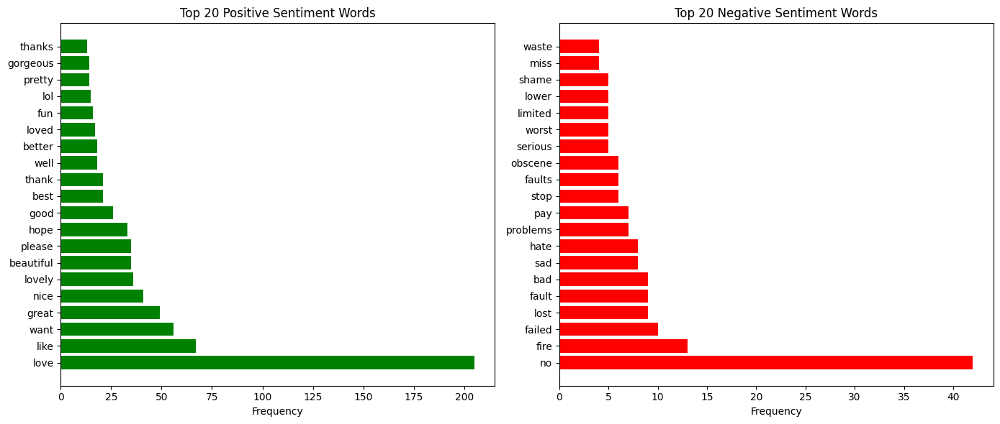

In [68]:
plt.figure(figsize=(14, 6))

# Positive sentiment words bar chart
plt.subplot(1, 2, 1)
plt.barh(positive_words_list, positive_word_counts, color='green')
plt.xlabel('Frequency')
plt.title('Top 20 Positive Sentiment Words')

# Negative sentiment words bar chart
plt.subplot(1, 2, 2)
plt.barh(negative_words_list, negative_word_counts, color='red')
plt.xlabel('Frequency')
plt.title('Top 20 Negative Sentiment Words')

plt.tight_layout()
plt.show()


2.2  Topic Modeling using LDA

When you need to segment, understand, and summarize a large collection of documents, topic modelling can be useful. Latent Dirichlet Allocation (LDA) is one of the ways to implement Topic Modelling. It is a generative probabilistic model in which each document is assumed to be consisting of a different proportion of topics.

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


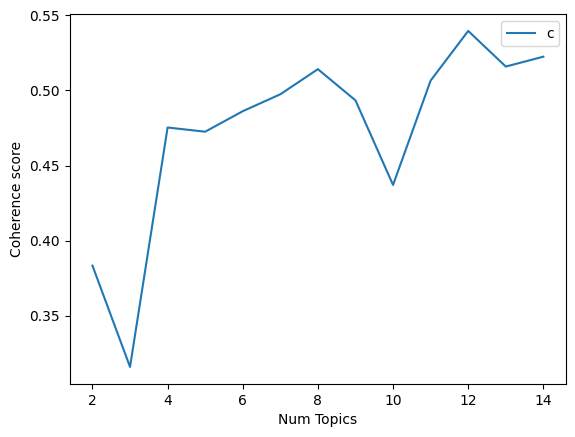

Optimal number of topics: 12
LDA model saved to C:\Users\melis\OneDrive\Desktop\ARP 3\lda_model_without_unrelated_words_facebook
(0, '0.048*"two" + 0.044*"left" + 0.043*"weeks" + 0.042*"erm" + 0.035*"electric" + 0.030*"years" + 0.022*"end" + 0.021*"anyway" + 0.021*"ho" + 0.021*"hey"')
(1, '0.058*"one" + 0.047*"range" + 0.034*"yard" + 0.031*"get" + 0.025*"got" + 0.023*"fiat" + 0.020*"ca" + 0.019*"look" + 0.019*"afford" + 0.018*"scrapyard"')
(2, '0.168*"person" + 0.162*"tagged" + 0.043*"want" + 0.037*"amazing" + 0.033*"one" + 0.032*"cute" + 0.027*"love" + 0.026*"wheels" + 0.026*"expensive" + 0.024*"next"')
(3, '0.022*"power" + 0.021*"electric" + 0.021*"car" + 0.018*"drive" + 0.017*"really" + 0.016*"even" + 0.015*"one" + 0.015*"small" + 0.014*"much" + 0.013*"cars"')
(4, '0.031*"avoid" + 0.023*"great" + 0.023*"bring" + 0.021*"states" + 0.021*"needed" + 0.021*"like" + 0.021*"retro" + 0.020*"commuter" + 0.015*"charge" + 0.015*"never"')
(5, '0.037*"park_nearest_scrap" + 0.037*"anything" + 0.0

In [72]:
import pandas as pd
import gensim
from gensim.models import Phrases
from gensim.models.phrases import Phraser
from gensim import corpora
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
import matplotlib.pyplot as plt

# Download stopwords if not already downloaded
nltk.download('stopwords')
nltk.download('punkt')

# Load the CSV file from your specified path
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df = pd.read_csv(file_path_csv)

# Preprocessing: Tokenization and removing stopwords
stop_words = set(stopwords.words('english'))
df['tokens'] = df['translated_comment'].apply(lambda x: [word for word in word_tokenize(str(x)) if word.isalpha() and word not in stop_words])

# Build bigrams and trigrams
bigram = Phrases(df['tokens'], min_count=5, threshold=100)  # Higher threshold fewer phrases.
trigram = Phrases(bigram[df['tokens']], threshold=100)  

bigram_mod = Phraser(bigram)
trigram_mod = Phraser(trigram)

# Create trigrams
df['trigrams'] = df['tokens'].apply(lambda x: trigram_mod[bigram_mod[x]])

# Skip the step to remove unrelated words
# Create Dictionary and Corpus
id2word = corpora.Dictionary(df['trigrams'])
corpus = [id2word.doc2bow(text) for text in df['trigrams']]

# Coherence test for various number of topics
coherence_values = []
model_list = []
topic_range = range(2, 15, 1)
random_seed = 24  # Set your random seed here

for num_topics in topic_range:
    model = LdaModel(corpus=corpus, id2word=id2word, num_topics=num_topics, random_state=random_seed, passes=10)
    model_list.append(model)
    coherencemodel = CoherenceModel(model=model, texts=df['trigrams'], dictionary=id2word, coherence='c_v')
    coherence_values.append(coherencemodel.get_coherence())

# Plot coherence scores
plt.plot(topic_range, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

# Select the model with the highest coherence score
optimal_num_topics = topic_range[coherence_values.index(max(coherence_values))]
print(f"Optimal number of topics: {optimal_num_topics}")

# Build the LDA model with the optimal number of topics
optimal_model = LdaModel(corpus=corpus, id2word=id2word, num_topics=optimal_num_topics, random_state=random_seed, passes=10)

# Save the LDA model
model_save_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\lda_model_without_unrelated_words_facebook'
optimal_model.save(model_save_path)
print(f"LDA model saved to {model_save_path}")

# Print the topics with the top 10 words
topics = optimal_model.print_topics(num_words=10)
topic_words_df = pd.DataFrame(topics, columns=["Topic", "Top Words"])
output_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3\facebook_topics_top_50_words_2.csv'
topic_words_df.to_csv(output_path, index=False)

for topic in topics:
    print(topic)


Remove unrelated words and after removing re-generate the topics 

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


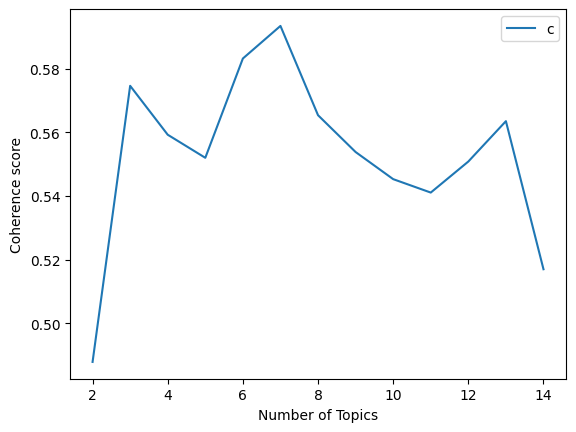

Optimal number of topics: 7
(0, '0.042*"range" + 0.039*"drive" + 0.025*"evs" + 0.025*"tackle" + 0.019*"style" + 0.018*"blue" + 0.018*"lovely" + 0.018*"states" + 0.015*"colour" + 0.014*"cost" + 0.011*"lost" + 0.011*"white" + 0.010*"dealer" + 0.010*"black" + 0.010*"rose" + 0.010*"gold" + 0.010*"gray" + 0.010*"upgrade" + 0.009*"problem" + 0.009*"group" + 0.009*"site" + 0.009*"address" + 0.009*"afford" + 0.009*"electric" + 0.009*"arbury" + 0.009*"couple" + 0.008*"visit" + 0.008*"solution" + 0.008*"impractical" + 0.007*"test" + 0.006*"yellow" + 0.005*"driving" + 0.004*"colours" + 0.004*"hit" + 0.004*"petrol" + 0.004*"little" + 0.003*"viable" + 0.003*"wheel" + 0.003*"failed" + 0.003*"post" + 0.003*"kerb" + 0.003*"manoeuvre" + 0.003*"reversed" + 0.003*"mirror" + 0.003*"checks" + 0.003*"lamp" + 0.003*"abarth" + 0.003*"due" + 0.003*"stick" + 0.003*"weighing"')
(1, '0.096*"beautiful" + 0.024*"red" + 0.019*"community" + 0.018*"colours" + 0.018*"punto" + 0.012*"range" + 0.011*"charge" + 0.011*"pri

In [151]:
import pandas as pd
import gensim
from gensim.models import Phrases
from gensim import corpora
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk

# Download stopwords if not already downloaded
nltk.download('stopwords')
nltk.download('punkt')

# Load the CSV file from your specified path
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df = pd.read_csv(file_path_csv)

# Tokenization and removing stopwords
stop_words = set(stopwords.words('english'))
df['tokens'] = df['translated_comment'].apply(lambda x: [word for word in word_tokenize(str(x)) if word.isalpha() and word.lower() not in stop_words])

# Define a function to create bigrams and trigrams
def make_bigrams_trigrams(texts):
    bigram = Phrases(texts, min_count=5, threshold=100)
    trigram = Phrases(bigram[texts], threshold=100)
    return trigram[bigram[texts]]

# Apply bigrams and trigrams
df['trigrams'] = df['tokens'].apply(lambda x: make_bigrams_trigrams([x])[0])

# Updated list of unrelated words for Fiat Dolce Vita car analysis
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])

# Remove unrelated words from the trigrams
df['filtered_trigrams'] = df['trigrams'].apply(lambda x: [word for word in x if word not in unrelated_words])

# Create Dictionary and Corpus again with the filtered trigrams
id2word = corpora.Dictionary(df['filtered_trigrams'])
corpus = [id2word.doc2bow(text) for text in df['filtered_trigrams']]

# Coherence test for various number of topics
coherence_values = []
model_list = []
topic_range = range(2, 15, 1)
random_seed = 24  # Set your random seed here

for num_topics in topic_range:
    model = LdaModel(corpus=corpus, 
                     id2word=id2word, 
                     num_topics=num_topics, 
                     random_state=random_seed, 
                     passes=10)
    model_list.append(model)
    coherencemodel = CoherenceModel(model=model, texts=df['filtered_trigrams'], dictionary=id2word, coherence='c_v')
    coherence_values.append(coherencemodel.get_coherence())

# Plot coherence scores to determine the optimal number of topics
plt.plot(topic_range, coherence_values)
plt.xlabel("Number of Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

# Select the model with the highest coherence score
optimal_num_topics = topic_range[coherence_values.index(max(coherence_values))]
print(f"Optimal number of topics: {optimal_num_topics}")

# Build the LDA model with the optimal number of topics
optimal_model = LdaModel(corpus=corpus, 
                         id2word=id2word, 
                         num_topics=optimal_num_topics, 
                         random_state=random_seed, 
                         passes=10)

# Print the topics with the top words
topics = optimal_model.print_topics(num_words=50)
topic_words_df = pd.DataFrame(topics, columns=["Topic", "Top Words"])

# Define output path correctly
output_path = 'Zdoc_topic_dist_facebook_comments_9.csv'
topic_words_df.to_csv(output_path, index=False)

# Display the topics
for topic in topics:
    print(topic)


In [102]:
import pandas as pd

topics = optimal_model.print_topics(num_words=50)

# Convert list of topics to a DataFrame
topic_words_df = pd.DataFrame(topics, columns=['Topic', 'Top Words'])

# Define the output path for the CSV file
output_path = 'C:\\Users\\melis\\OneDrive\\Desktop\\ARP 3\\topics_with_top_words_final_2.csv'

# Save the DataFrame to a CSV file
topic_words_df.to_csv(output_path, index=False)

print(f"Topics and their top words have been saved to {output_path}")


Topics and their top words have been saved to C:\Users\melis\OneDrive\Desktop\ARP 3\topics_with_top_words_final_2.csv


Make sure it's saving

In [ ]:
import pandas as pd
import gensim
from gensim.models import Phrases
from gensim import corpora
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk

# Download stopwords if not already downloaded
nltk.download('stopwords')
nltk.download('punkt')

# Load the CSV file from your specified path
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df = pd.read_csv(file_path_csv)

# Tokenization and removing stopwords
stop_words = set(stopwords.words('english'))
df['tokens'] = df['translated_comment'].apply(lambda x: [word for word in word_tokenize(str(x)) if word.isalpha() and word.lower() not in stop_words])

# Define a function to create bigrams and trigrams
def make_bigrams_trigrams(texts):
    bigram = Phrases(texts, min_count=5, threshold=100)
    trigram = Phrases(bigram[texts], threshold=100)
    return trigram[bigram[texts]]

# Apply bigrams and trigrams
df['trigrams'] = df['tokens'].apply(lambda x: make_bigrams_trigrams([x])[0])

# Updated list of unrelated words for Fiat Dolce Vita car analysis
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting","states","lost","little",
    "due", "weighing", "chassis", "excessive" , 

])

# Remove unrelated words from the trigrams
df['filtered_trigrams'] = df['trigrams'].apply(lambda x: [word for word in x if word not in unrelated_words])

# Create Dictionary and Corpus again with the filtered trigrams
id2word = corpora.Dictionary(df['filtered_trigrams'])
corpus = [id2word.doc2bow(text) for text in df['filtered_trigrams']]

# Coherence test for various number of topics
coherence_values = []
model_list = []
topic_range = range(2, 15, 1)
random_seed = 24  # Set your random seed here

for num_topics in topic_range:
    model = LdaModel(corpus=corpus, 
                     id2word=id2word, 
                     num_topics=num_topics, 
                     random_state=random_seed, 
                     passes=10)
    model_list.append(model)
    coherencemodel = CoherenceModel(model=model, texts=df['filtered_trigrams'], dictionary=id2word, coherence='c_v')
    coherence_values.append(coherencemodel.get_coherence())

# Plot coherence scores to determine the optimal number of topics
plt.plot(topic_range, coherence_values)
plt.xlabel("Number of Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

# Select the model with the highest coherence score
optimal_num_topics = topic_range[coherence_values.index(max(coherence_values))]
print(f"Optimal number of topics: {optimal_num_topics}")

# Build the LDA model with the optimal number of topics
optimal_model = LdaModel(corpus=corpus, 
                         id2word=id2word, 
                         num_topics=optimal_num_topics, 
                         random_state=random_seed, 
                         passes=10)

# Print the topics with the top words
topics = optimal_model.print_topics(num_words=50)
topic_words_df = pd.DataFrame(topics, columns=["Topic", "Top Words"])

# Define output path correctly
output_path = 'Zdoc_topic_dist_facebook_comments_9.csv'
topic_words_df.to_csv(output_path, index=False)

# Display the topics
for topic in topics:
    print(topic)

## Getting the comments for each topic 

In [103]:
# Extract the document-topic distribution for each comment
doc_topic_dist = optimal_model[corpus]

# Convert this distribution into a DataFrame
doc_topic_df = pd.DataFrame()

for i, row_list in enumerate(doc_topic_dist):
    row = [0] * optimal_num_topics
    for topic_num, prop in row_list:
        row[topic_num] = prop
    doc_topic_df = pd.concat([doc_topic_df, pd.Series(row)], axis=1)

doc_topic_df = doc_topic_df.T  # Transpose to get topics as columns
doc_topic_df.columns = [f"Topic_{i+1}" for i in range(optimal_num_topics)]  # Rename columns

# Save the document-topic distribution
doc_topic_dist_file = 'Zdoc_topic_dist_facebook_comments_final_2.csv'
doc_topic_df.to_csv(doc_topic_dist_file, index=False)

# Function to extract comments for each topic with their weights
def extract_comments_for_topics(doc_topic_df, comments, num_topics, output_prefix, threshold=0.3):
    for topic in range(num_topics):
        # Extract comments and their weights (probabilities) for this topic
        topic_comments_weights = [(comments[i], doc_topic_df.iloc[i, topic]) for i in range(len(comments)) if doc_topic_df.iloc[i, topic] > threshold]

        # Save the comments and their weights to a CSV file
        output_file = f"{output_prefix}_finaltopic_{topic + 1}_comments.csv"
        pd.DataFrame(topic_comments_weights, columns=["Comment", "Weight"]).to_csv(output_file, index=False)
        print(f"Comments and weights for Topic {topic + 1} saved to {output_file}")

# Extract comments for the identified topics
comments = df['translated_comment'].tolist()  # Use the original translated comments

extract_comments_for_topics(doc_topic_df, comments, optimal_num_topics, 'facebook_comments_final_2')

Comments and weights for Topic 1 saved to facebook_comments_final_2_finaltopic_1_comments.csv
Comments and weights for Topic 2 saved to facebook_comments_final_2_finaltopic_2_comments.csv
Comments and weights for Topic 3 saved to facebook_comments_final_2_finaltopic_3_comments.csv
Comments and weights for Topic 4 saved to facebook_comments_final_2_finaltopic_4_comments.csv
Comments and weights for Topic 5 saved to facebook_comments_final_2_finaltopic_5_comments.csv
Comments and weights for Topic 6 saved to facebook_comments_final_2_finaltopic_6_comments.csv
Comments and weights for Topic 7 saved to facebook_comments_final_2_finaltopic_7_comments.csv


Categorising the comments based on important level

In [112]:
import pandas as pd

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Range of topics ( we have files for topics 1 through 7)
topics = range(1, 8)

for topic_num in topics:
    try:
        # Load the comments for the current topic
        file_path = f'{directory_path}\\facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
        topic_df = pd.read_csv(file_path)

        # Calculate the mean and standard deviation for the weights
        mean_weight = topic_df['Weight'].mean()
        std_dev = topic_df['Weight'].std()

        # Define thresholds based on mean and standard deviation
        most_important_threshold = mean_weight + std_dev
        least_important_threshold = mean_weight - std_dev

        # Categorize the comments based on the thresholds
        most_important_comments = topic_df[topic_df['Weight'] > most_important_threshold]
        important_comments = topic_df[(topic_df['Weight'] <= most_important_threshold) & (topic_df['Weight'] >= least_important_threshold)]
        least_important_comments = topic_df[topic_df['Weight'] < least_important_threshold]

        # Save the categorized comments to CSV files
        most_important_comments.to_csv(f'{directory_path}\\FACEBOOK_most_important_comments_topic_{topic_num}.csv', index=False)
        important_comments.to_csv(f'{directory_path}\\FACEBOOK_important_comments_topic_{topic_num}.csv', index=False)
        least_important_comments.to_csv(f'{directory_path}\\FACEBOOK_least_important_comments_topic_{topic_num}.csv', index=False)

        print(f"Categorized comments for Topic {topic_num} have been saved.")
    
    except FileNotFoundError:
        print(f"File not found: {file_path}")

Categorized comments for Topic 1 have been saved.
Categorized comments for Topic 2 have been saved.
Categorized comments for Topic 3 have been saved.
Categorized comments for Topic 4 have been saved.
Categorized comments for Topic 5 have been saved.
Categorized comments for Topic 6 have been saved.
Categorized comments for Topic 7 have been saved.


Visualisation of Topic Distribution

Now that we have a trained model let’s visualize the topics for interpretability. To do so, we’ll use a popular visualization package, pyLDAvis which is designed to help interactively with:

1) Better understanding and interpreting individual topics, and
2) Better understanding the relationships between the topics.

In [105]:
# Select the model with the highest coherence score
optimal_num_topics = topic_range[coherence_values.index(max(coherence_values))]
print(f"Optimal number of topics: {optimal_num_topics}")

# Build the LDA model with the optimal number of topics
optimal_model = LdaModel(corpus=corpus, 
                         id2word=id2word, 
                         num_topics=optimal_num_topics, 
                         random_state=random_seed, 
                         passes=10)

# Create the pyLDAvis visualization
vis = pyLDAvis.gensim_models.prepare(optimal_model, corpus, id2word)

# Save the visualization to an HTML file
html_file_path = 'lda_visualization.html_final2_fiat_dolce_vita_facebook'
pyLDAvis.save_html(vis, html_file_path)

# Display the visualization in a notebook or a web browser
pyLDAvis.display(vis)

Optimal number of topics: 7


c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:39: DeprecationWarning:

Attribute n is deprecated and will be removed in Python 3.14; use value instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:38: DeprecationWarning:

ast.Num is deprecated and will be removed in Python 3.14; use ast.Constant instead

c:\Users\melis\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\_utils.py:39: DeprecationWarning:

Attribute n is deprecated and will be removed in Python 3.14; use value instead



Visualisation : Weights of Topic Distrubition

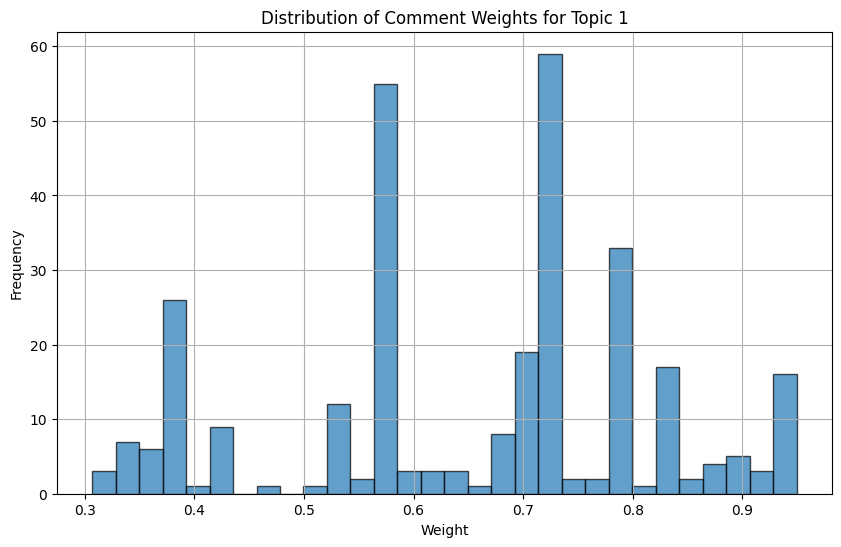

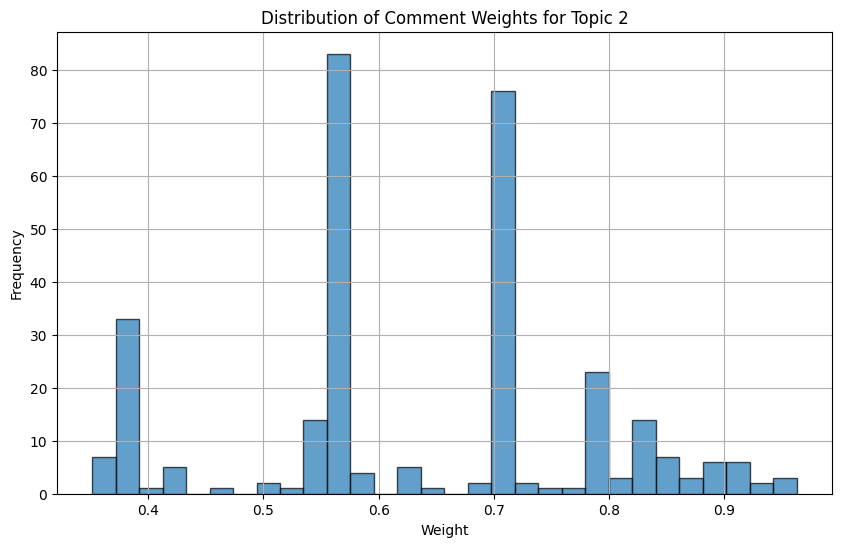

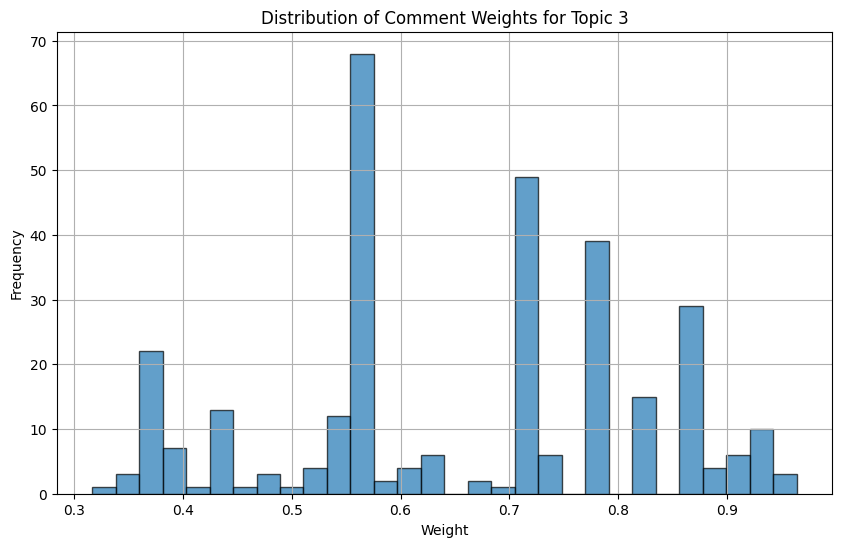

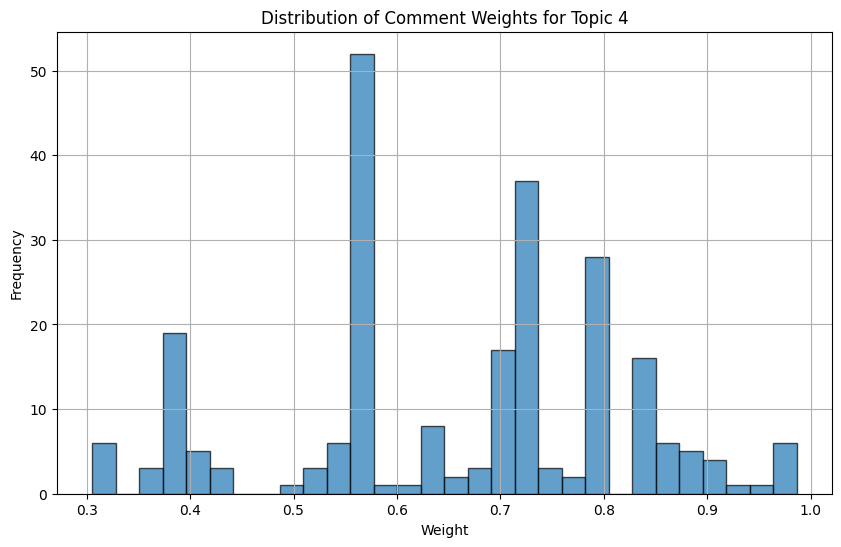

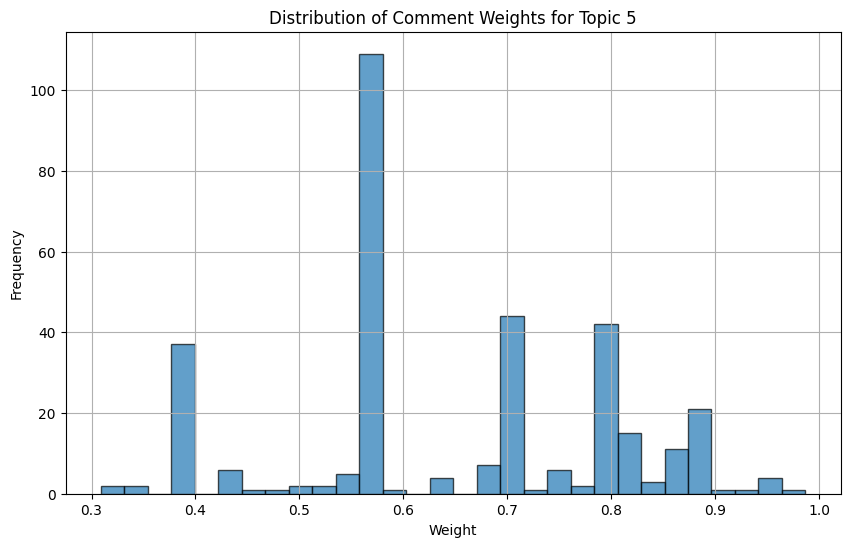

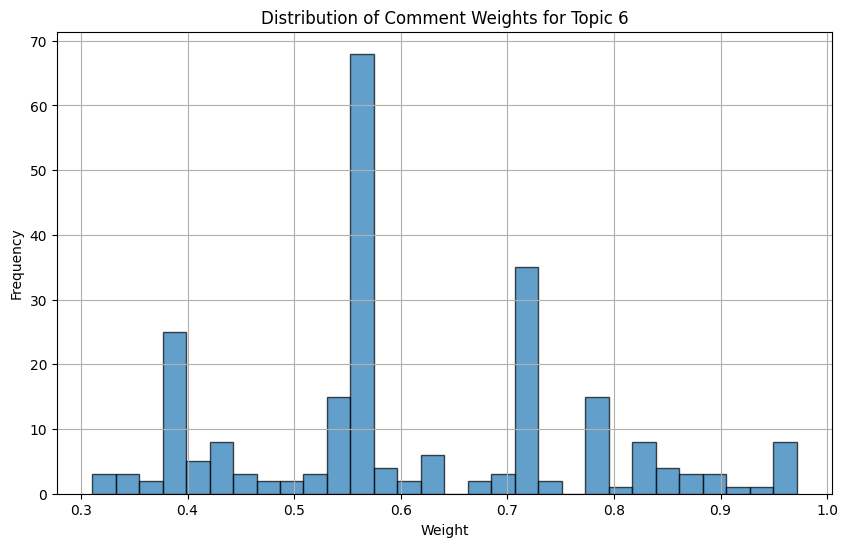

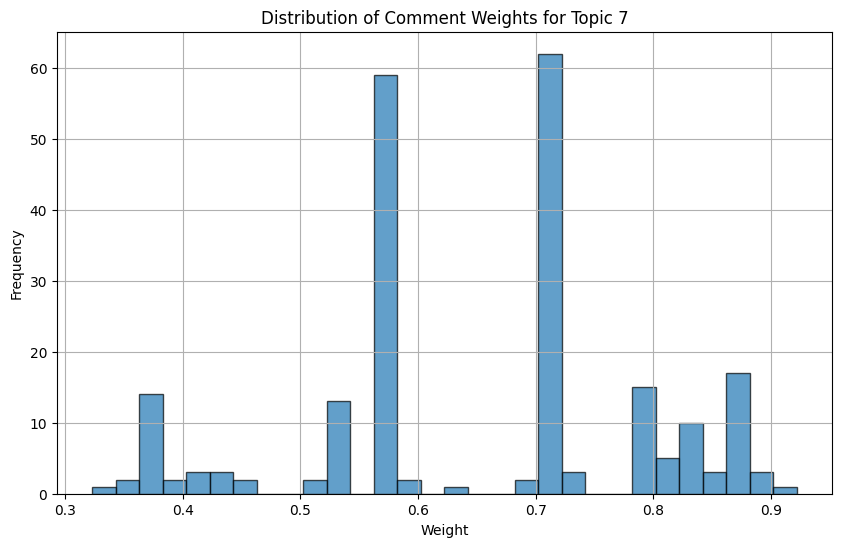

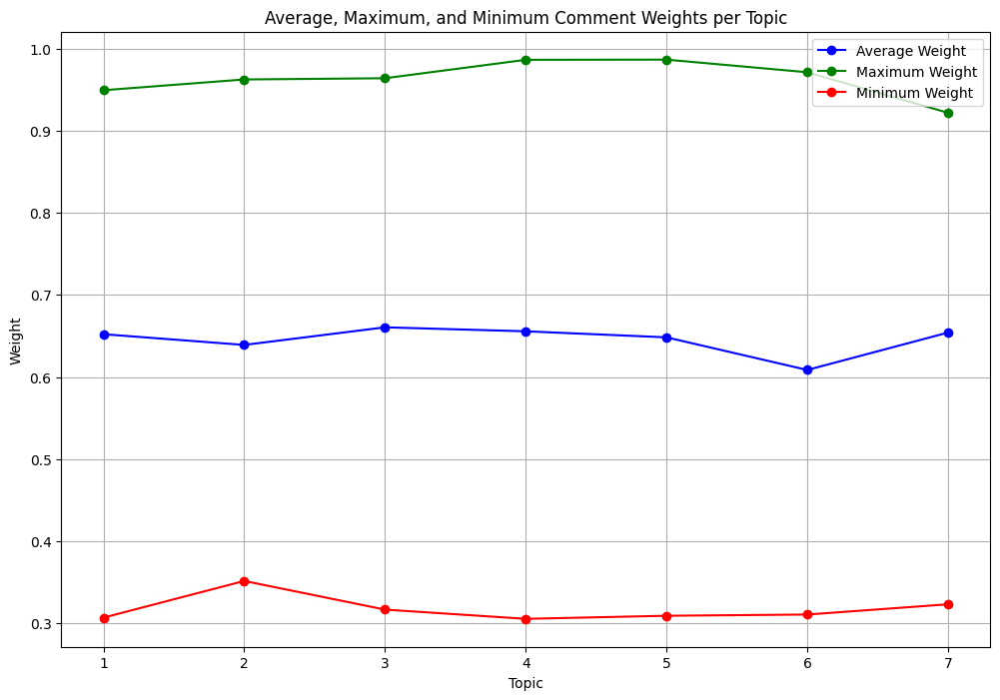

In [113]:
import pandas as pd
import matplotlib.pyplot as plt

# List of topic CSV files
topic_files = [f'facebook_comments_final_2_finaltopic_{i+1}_comments.csv' for i in range(optimal_num_topics)]

# Initialize lists to store the computed values
topic_averages = []
topic_maximums = []
topic_minimums = []

# Process each topic file
for i, topic_file in enumerate(topic_files):
    # Load the data
    df_topic = pd.read_csv(topic_file)
    
    # Calculate average, maximum, and minimum weights
    avg_weight = df_topic['Weight'].mean()
    max_weight = df_topic['Weight'].max()
    min_weight = df_topic['Weight'].min()
    
    # Append the calculated values to the lists
    topic_averages.append(avg_weight)
    topic_maximums.append(max_weight)
    topic_minimums.append(min_weight)
    
    # Plot histogram
    plt.figure(figsize=(10, 6))
    plt.hist(df_topic['Weight'], bins=30, alpha=0.7, edgecolor='black')
    plt.title(f'Distribution of Comment Weights for Topic {i+1}')
    plt.xlabel('Weight')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

# Plot line charts for average, maximum, and minimum weights
plt.figure(figsize=(12, 8))

# Plot average weights
plt.plot(range(1, optimal_num_topics + 1), topic_averages, marker='o', label='Average Weight', color='blue')

# Plot maximum weights
plt.plot(range(1, optimal_num_topics + 1), topic_maximums, marker='o', label='Maximum Weight', color='green')

# Plot minimum weights
plt.plot(range(1, optimal_num_topics + 1), topic_minimums, marker='o', label='Minimum Weight', color='red')

# Add titles and labels
plt.title('Average, Maximum, and Minimum Comment Weights per Topic')
plt.xlabel('Topic')
plt.ylabel('Weight')
plt.xticks(range(1, optimal_num_topics + 1))  # Set x-ticks to be the topic numbers
plt.grid(True)
plt.legend()

# Show the plot
plt.show()


Visualisations: Analysing LDA model results

In [114]:
# Get the topic distribution for each document in the corpus
doc_topics = optimal_model.get_document_topics(corpus, minimum_probability=0)

# Aggregate the topic proportions across all documents
topic_weights = [0] * optimal_num_topics

for doc in doc_topics:
    for topic_num, prop in doc:
        topic_weights[topic_num] += prop

# Normalize the weights to get the overall proportion of each topic
total_weight = sum(topic_weights)
topic_weights = [weight / total_weight for weight in topic_weights]

# Display the topic weights
for i, weight in enumerate(topic_weights):
    print(f"Topic {i}: {weight:.4f}")


Topic 0: 0.1504
Topic 1: 0.1486
Topic 2: 0.1550
Topic 3: 0.1337
Topic 4: 0.1574
Topic 5: 0.1281
Topic 6: 0.1267


In [115]:
# Extract the topic weights directly from the pyLDAvis object
topic_weights_from_vis = vis.topic_coordinates['Freq'] / 100  # Freq is given in percentage

# Display the topic weights
for i, weight in enumerate(topic_weights_from_vis, start=1):
    print(f"Topic {i}: {weight:.4f}")


Topic 1: 0.1600
Topic 2: 0.1545
Topic 3: 0.1531
Topic 4: 0.1515
Topic 5: 0.1458
Topic 6: 0.1272
Topic 7: 0.1078


Labeling the topics

In [117]:
# Trained LDA model from Gensim
topics = optimal_model.print_topics(num_words=10)  # Change num_words to display more or fewer words

# Display the topics
for i, topic in topics:
    print(f"Topic {i}: {topic}")


Topic 0: 0.042*"range" + 0.039*"drive" + 0.025*"evs" + 0.025*"tackle" + 0.019*"style" + 0.018*"blue" + 0.018*"lovely" + 0.018*"states" + 0.015*"colour" + 0.014*"cost"
Topic 1: 0.096*"beautiful" + 0.024*"red" + 0.019*"community" + 0.018*"colours" + 0.018*"punto" + 0.012*"range" + 0.011*"charge" + 0.011*"prices" + 0.010*"land" + 0.010*"waste"
Topic 2: 0.068*"park" + 0.041*"yard" + 0.032*"scrap" + 0.023*"charge" + 0.018*"engine" + 0.017*"retro" + 0.016*"electric" + 0.015*"green" + 0.014*"home" + 0.010*"front"
Topic 3: 0.036*"house" + 0.029*"park" + 0.028*"outside" + 0.025*"trips" + 0.017*"panda" + 0.012*"brand" + 0.011*"charger" + 0.011*"problems" + 0.011*"cross" + 0.010*"van"
Topic 4: 0.064*"drive" + 0.063*"expensive" + 0.047*"cute" + 0.039*"lounge" + 0.039*"afford" + 0.039*"wheels" + 0.037*"fashionable" + 0.029*"colour" + 0.019*"look" + 0.009*"lil"
Topic 5: 0.049*"faults" + 0.036*"garage" + 0.034*"fault" + 0.032*"photos" + 0.032*"audio" + 0.032*"signs" + 0.028*"ice" + 0.024*"electric" +

                                               Topic  Number of Comments
0    Vehicle Range, Cost Efficiency, and Performance                 304
1                 Aesthetic Design and Visual Appeal                 306
2  Parking, Durability, and Environmental Conside...                 312
3  Practicality, Usability, and Charging Infrastr...                 239
4  Cost-Effectiveness, Color Preferences, and Lif...                 331
5  Maintenance, Performance, and Long-Term Reliab...                 237
6  Electric and Hybrid Vehicles: Sustainability a...                 225


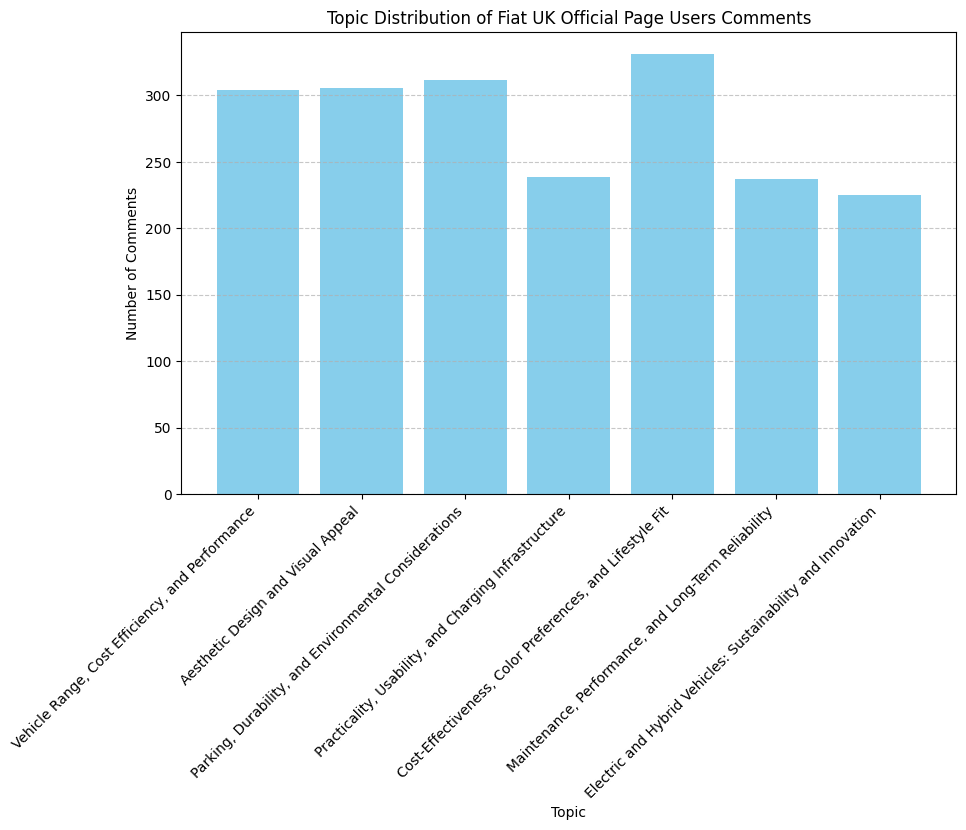

In [141]:
import pandas as pd
import os
import matplotlib.pyplot as plt

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics 
topics = [1, 2, 3, 4, 5, 6, 7]  
# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}



# Initialize a dictionary to hold the counts of comments per topic
topic_counts = {}

# Iterate through each topic file
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    # Check if the file exists
    if os.path.exists(file_path):
        # Load the data
        topic_df = pd.read_csv(file_path)
        
        # Count the number of comments
        num_comments = len(topic_df)
        
        # Store the count in the dictionary
        topic_counts[topic_names[topic_num]] = num_comments
    else:
        print(f'File for topic {topic_names[topic_num]} not found.')

# Convert the dictionary to a DataFrame for better visualization
topic_distribution_df = pd.DataFrame(list(topic_counts.items()), columns=['Topic', 'Number of Comments'])

# Display the DataFrame
print(topic_distribution_df)

# Plot the distribution
plt.figure(figsize=(10, 6))
plt.bar(topic_distribution_df['Topic'], topic_distribution_df['Number of Comments'], color='skyblue')
plt.xlabel('Topic')
plt.ylabel('Number of Comments')
plt.title('Topic Distribution of Fiat UK Official Page Users Comments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


Different colours options:

                                               Topic  Number of Comments
4  Cost-Effectiveness, Color Preferences, and Lif...                 331
2  Parking, Durability, and Environmental Conside...                 312
1                 Aesthetic Design and Visual Appeal                 306
0    Vehicle Range, Cost Efficiency, and Performance                 304
3  Practicality, Usability, and Charging Infrastr...                 239
5  Maintenance, Performance, and Long-Term Reliab...                 237
6  Electric and Hybrid Vehicles: Sustainability a...                 225


C:\Users\melis\AppData\Local\Temp\ipykernel_8372\1500660369.py:55: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



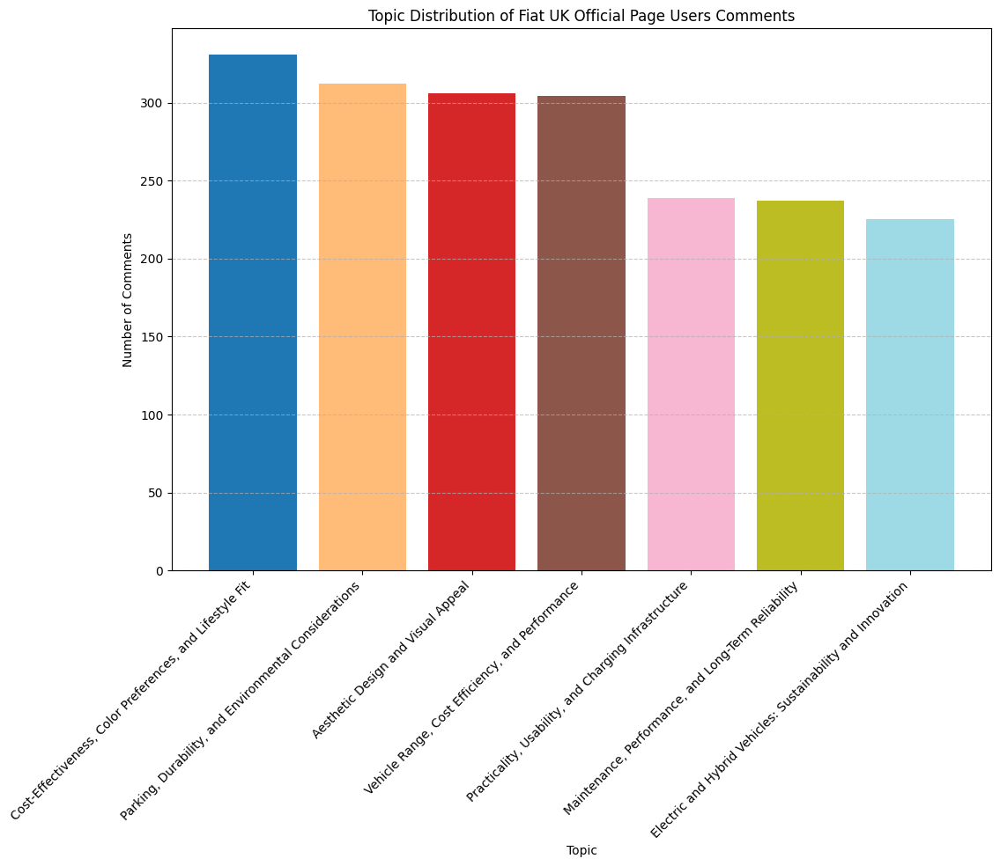

In [140]:
import pandas as pd
import os
import matplotlib.pyplot as plt

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics (adjusted to 7 topics)
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}




# Initialize a dictionary to hold the counts of comments per topic
topic_counts = {}

# Iterate through each topic file
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    # Check if the file exists
    if os.path.exists(file_path):
        # Load the data
        topic_df = pd.read_csv(file_path)
        
        # Count the number of comments
        num_comments = len(topic_df)
        
        # Store the count in the dictionary
        topic_counts[topic_names[topic_num]] = num_comments
    else:
        print(f'File for topic {topic_names[topic_num]} not found.')

# Convert the dictionary to a DataFrame for better visualization
topic_distribution_df = pd.DataFrame(list(topic_counts.items()), columns=['Topic', 'Number of Comments'])

# Sort the DataFrame in descending order of the number of comments
topic_distribution_df = topic_distribution_df.sort_values(by='Number of Comments', ascending=False)

# Display the DataFrame
print(topic_distribution_df)

# Define a list of colors for each bar
colors = plt.cm.get_cmap('tab20', len(topic_distribution_df))  # Get a colormap with enough distinct colors

# Plot the distribution with each bar a different color
plt.figure(figsize=(12, 8))
plt.bar(topic_distribution_df['Topic'], topic_distribution_df['Number of Comments'], color=colors.colors)
plt.xlabel('Topic')
plt.ylabel('Number of Comments')
plt.title('Topic Distribution of Fiat UK Official Page Users Comments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


                                               Topic  Number of Comments
4  Cost-Effectiveness, Color Preferences, and Lif...                 331
2  Parking, Durability, and Environmental Conside...                 312
1                 Aesthetic Design and Visual Appeal                 306
0    Vehicle Range, Cost Efficiency, and Performance                 304
3  Practicality, Usability, and Charging Infrastr...                 239
5  Maintenance, Performance, and Long-Term Reliab...                 237
6  Electric and Hybrid Vehicles: Sustainability a...                 225


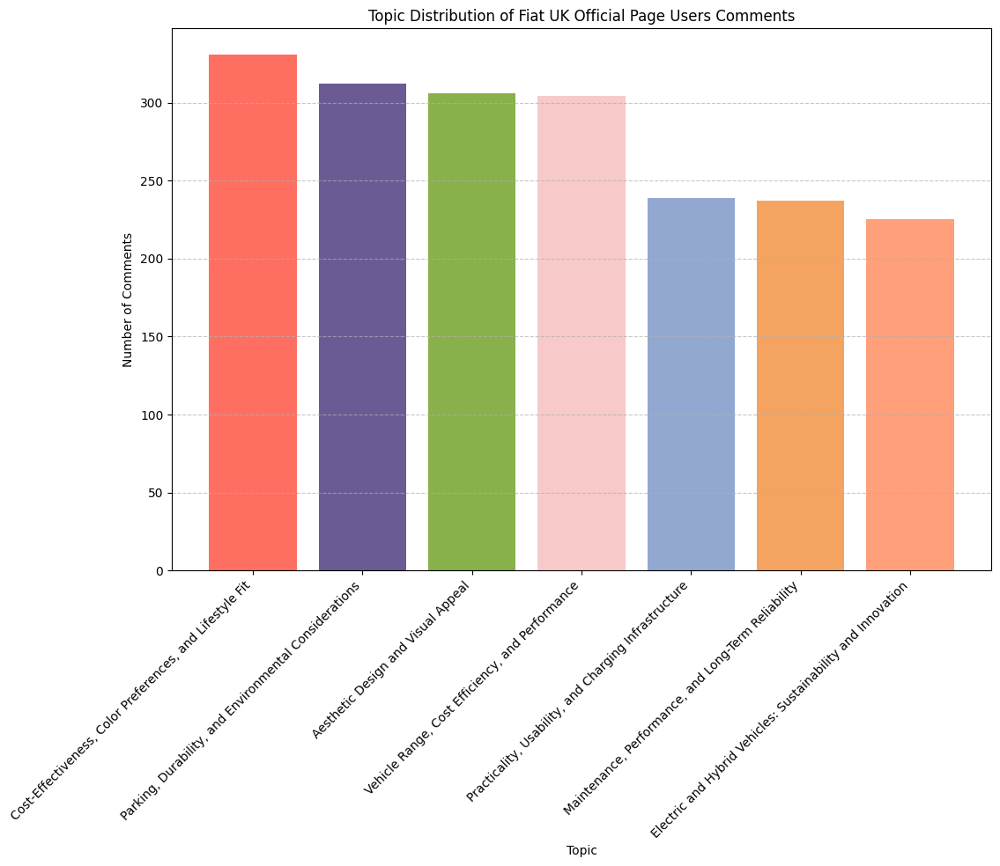

In [139]:
import pandas as pd
import os
import matplotlib.pyplot as plt

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics (adjusted to 7 topics)
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}



# Initialize a dictionary to hold the counts of comments per topic
topic_counts = {}

# Iterate through each topic file
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    # Check if the file exists
    if os.path.exists(file_path):
        # Load the data
        topic_df = pd.read_csv(file_path)
        
        # Count the number of comments
        num_comments = len(topic_df)
        
        # Store the count in the dictionary
        topic_counts[topic_names[topic_num]] = num_comments
    else:
        print(f'File for topic {topic_names[topic_num]} not found.')

# Convert the dictionary to a DataFrame for better visualization
topic_distribution_df = pd.DataFrame(list(topic_counts.items()), columns=['Topic', 'Number of Comments'])

# Sort the DataFrame in descending order of the number of comments
topic_distribution_df = topic_distribution_df.sort_values(by='Number of Comments', ascending=False)

# Display the DataFrame
print(topic_distribution_df)

# Define a list of joyful, vibrant colors for each bar
joyful_colors = ['#FF6F61', '#6B5B95', '#88B04B', '#F7CAC9', '#92A8D1', '#F4A460', '#FFA07A']

# Plot the distribution with each bar a different color
plt.figure(figsize=(12, 8))
plt.bar(topic_distribution_df['Topic'], topic_distribution_df['Number of Comments'], color=joyful_colors)
plt.xlabel('Topic')
plt.ylabel('Number of Comments')
plt.title('Topic Distribution of Fiat UK Official Page Users Comments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


                                               Topic  Number of Comments
4  Cost-Effectiveness, Color Preferences, and Lif...                 331
2  Parking, Durability, and Environmental Conside...                 312
1                 Aesthetic Design and Visual Appeal                 306
0    Vehicle Range, Cost Efficiency, and Performance                 304
3  Practicality, Usability, and Charging Infrastr...                 239
5  Maintenance, Performance, and Long-Term Reliab...                 237
6  Electric and Hybrid Vehicles: Sustainability a...                 225


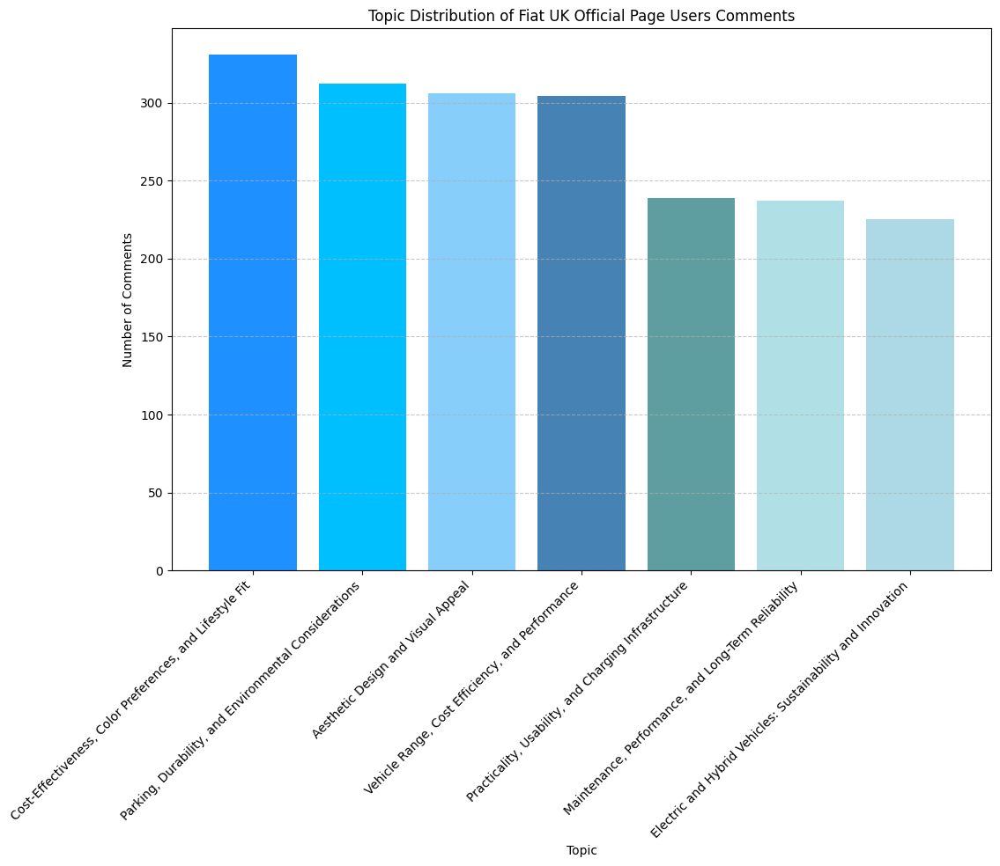

In [138]:
import pandas as pd
import os
import matplotlib.pyplot as plt

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics (adjusted to 7 topics)
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}


# Initialize a dictionary to hold the counts of comments per topic
topic_counts = {}

# Iterate through each topic file
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    # Check if the file exists
    if os.path.exists(file_path):
        # Load the data
        topic_df = pd.read_csv(file_path)
        
        # Count the number of comments
        num_comments = len(topic_df)
        
        # Store the count in the dictionary
        topic_counts[topic_names[topic_num]] = num_comments
    else:
        print(f'File for topic {topic_names[topic_num]} not found.')

# Convert the dictionary to a DataFrame for better visualization
topic_distribution_df = pd.DataFrame(list(topic_counts.items()), columns=['Topic', 'Number of Comments'])

# Sort the DataFrame in descending order of the number of comments
topic_distribution_df = topic_distribution_df.sort_values(by='Number of Comments', ascending=False)

# Display the DataFrame
print(topic_distribution_df)

# Define a list of blue tones for each bar
blue_tones = ['#1E90FF', '#00BFFF', '#87CEFA', '#4682B4', '#5F9EA0', '#B0E0E6', '#ADD8E6']

# Plot the distribution with each bar a different color
plt.figure(figsize=(12, 8))
plt.bar(topic_distribution_df['Topic'], topic_distribution_df['Number of Comments'], color=blue_tones)
plt.xlabel('Topic')
plt.ylabel('Number of Comments')
plt.title('Topic Distribution of Fiat UK Official Page Users Comments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


                                               Topic  Number of Comments
4  Cost-Effectiveness, Color Preferences, and Lif...                 331
2  Parking, Durability, and Environmental Conside...                 312
1                 Aesthetic Design and Visual Appeal                 306
0    Vehicle Range, Cost Efficiency, and Performance                 304
3  Practicality, Usability, and Charging Infrastr...                 239
5  Maintenance, Performance, and Long-Term Reliab...                 237
6  Electric and Hybrid Vehicles: Sustainability a...                 225


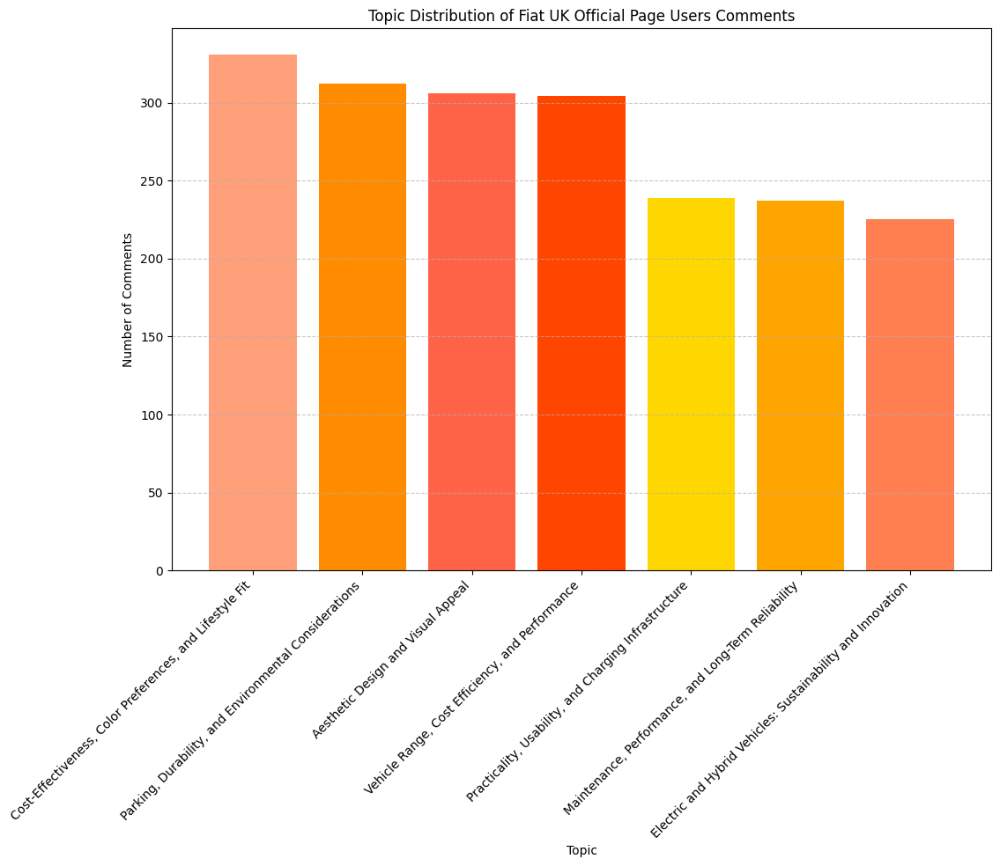

In [137]:
import pandas as pd
import os
import matplotlib.pyplot as plt

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics (adjusted to 7 topics)
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}


# Initialize a dictionary to hold the counts of comments per topic
topic_counts = {}

# Iterate through each topic file
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    # Check if the file exists
    if os.path.exists(file_path):
        # Load the data
        topic_df = pd.read_csv(file_path)
        
        # Count the number of comments
        num_comments = len(topic_df)
        
        # Store the count in the dictionary
        topic_counts[topic_names[topic_num]] = num_comments
    else:
        print(f'File for topic {topic_names[topic_num]} not found.')

# Convert the dictionary to a DataFrame for better visualization
topic_distribution_df = pd.DataFrame(list(topic_counts.items()), columns=['Topic', 'Number of Comments'])

# Sort the DataFrame in descending order of the number of comments
topic_distribution_df = topic_distribution_df.sort_values(by='Number of Comments', ascending=False)

# Display the DataFrame
print(topic_distribution_df)

# Define a list of orange tones for each bar
orange_tones = ['#FFA07A', '#FF8C00', '#FF6347', '#FF4500', '#FFD700', '#FFA500', '#FF7F50']

# Plot the distribution with each bar a different color
plt.figure(figsize=(12, 8))
plt.bar(topic_distribution_df['Topic'], topic_distribution_df['Number of Comments'], color=orange_tones)
plt.xlabel('Topic')
plt.ylabel('Number of Comments')
plt.title('Topic Distribution of Fiat UK Official Page Users Comments')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


3. Mixture of Topic Modelling and Sentiment Analysis

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


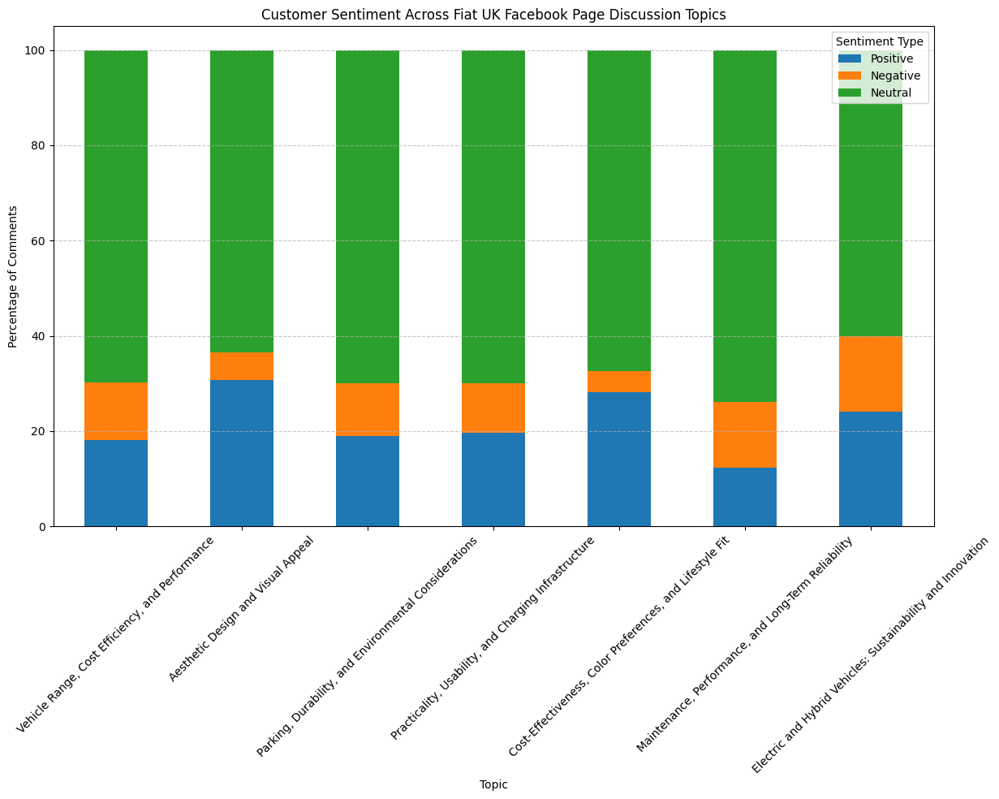

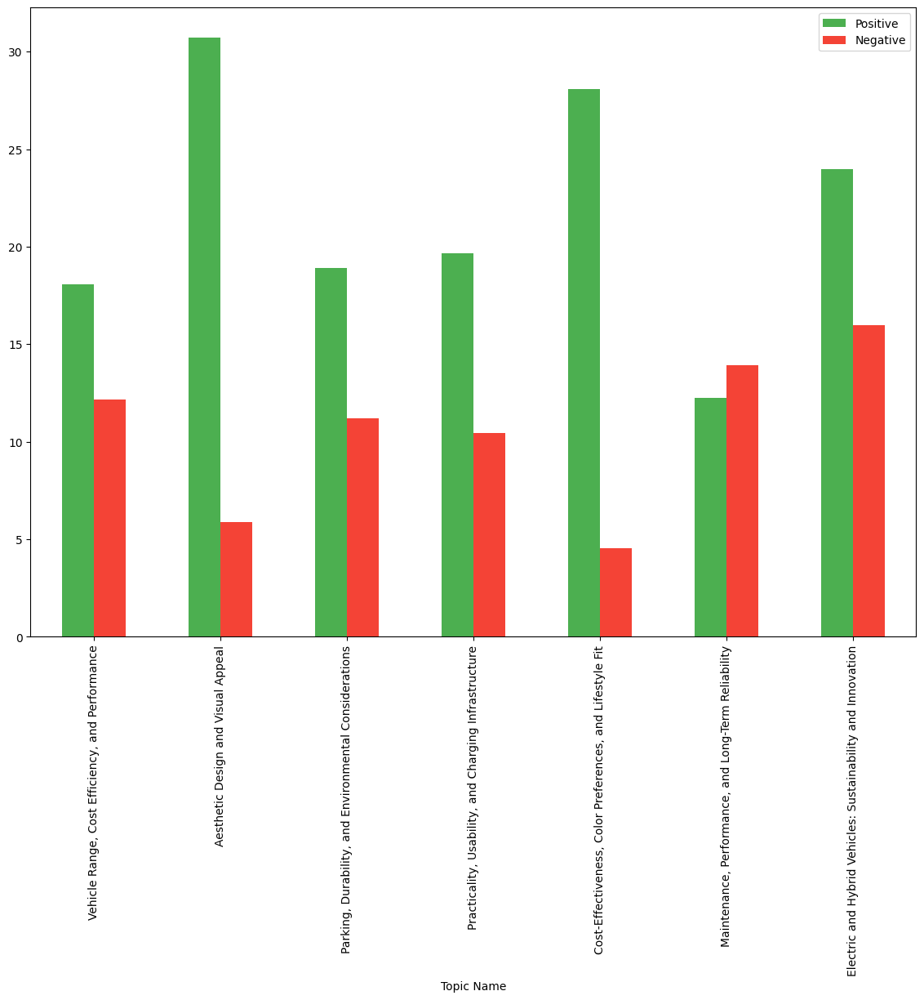

In [142]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Download necessary NLTK data
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Function to clean comments and remove unrelated words
def clean_and_filter(comment):
    words = word_tokenize(comment.lower())
    return " ".join([word for word in words if word.isalpha() and word not in unrelated_words])

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': [], 'Neutral': []}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:  # Avoid division by zero
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(sentiments['positive'] / total * 100)
        data['Negative'].append(sentiments['negative'] / total * 100)
        data['Neutral'].append(sentiments['neutral'] / total * 100)

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
df.plot(kind='bar', stacked=True, figsize=(14, 8))
plt.xlabel('Topic')
plt.ylabel('Percentage of Comments')
plt.title('Customer Sentiment Across Fiat UK Facebook Page Discussion Topics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Sentiment Type')
plt.xticks(rotation=45)
plt.show()

ax = df[['Positive', 'Negative']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336'])  # Increased height to 10



[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


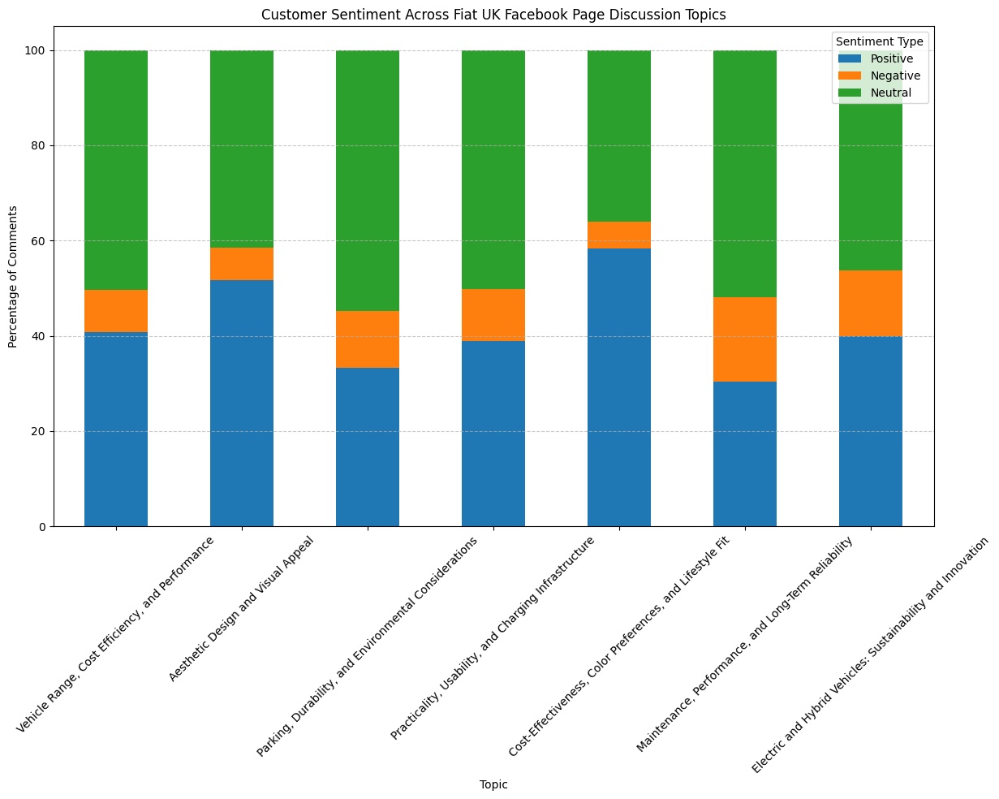

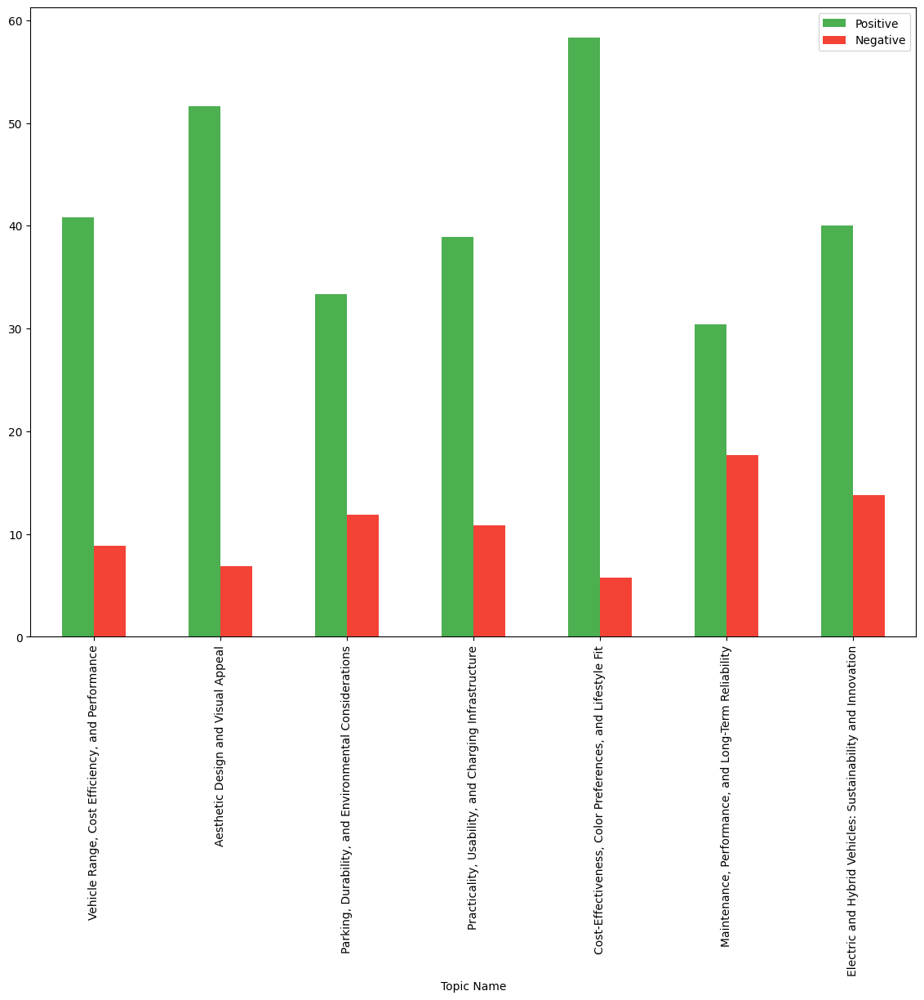

In [166]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Download necessary NLTK data
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Function to clean comments and remove unrelated words
def clean_and_filter(comment):
    words = word_tokenize(comment.lower())
    return " ".join([word for word in words if word.isalpha()])

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Create an empty DataFrame to store all comments with their topics
all_comments_df = pd.DataFrame()

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        topic_df['Topic'] = topic_name  # Add a new column for the topic name
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
        
        # Append the data for this topic to the all_comments_df
        all_comments_df = pd.concat([all_comments_df, topic_df], ignore_index=True)
    else:
        print(f'File for topic {topic_name} not found.')

# Save the concatenated DataFrame with topics to a new CSV file
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized_topics.csv"
all_comments_df.to_csv(file_path_csv, index=False)

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': [], 'Neutral': []}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:  # Avoid division by zero
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(sentiments['positive'] / total * 100)
        data['Negative'].append(sentiments['negative'] / total * 100)
        data['Neutral'].append(sentiments['neutral'] / total * 100)

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
df.plot(kind='bar', stacked=True, figsize=(14, 8))
plt.xlabel('Topic')
plt.ylabel('Percentage of Comments')
plt.title('Customer Sentiment Across Fiat UK Facebook Page Discussion Topics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Sentiment Type')
plt.xticks(rotation=45)

# Save the plot
plt.savefig(r'C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_distribution_across_topics.png', dpi=300)
plt.show()

# Plotting positive and negative sentiment distribution separately
ax = df[['Positive', 'Negative']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336'])

# Save the plot
plt.savefig(r'C:\Users\melis\OneDrive\Desktop\ARP 3\positive_vs_negative_sentiment_across_topics.png', dpi=300)
plt.show()


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


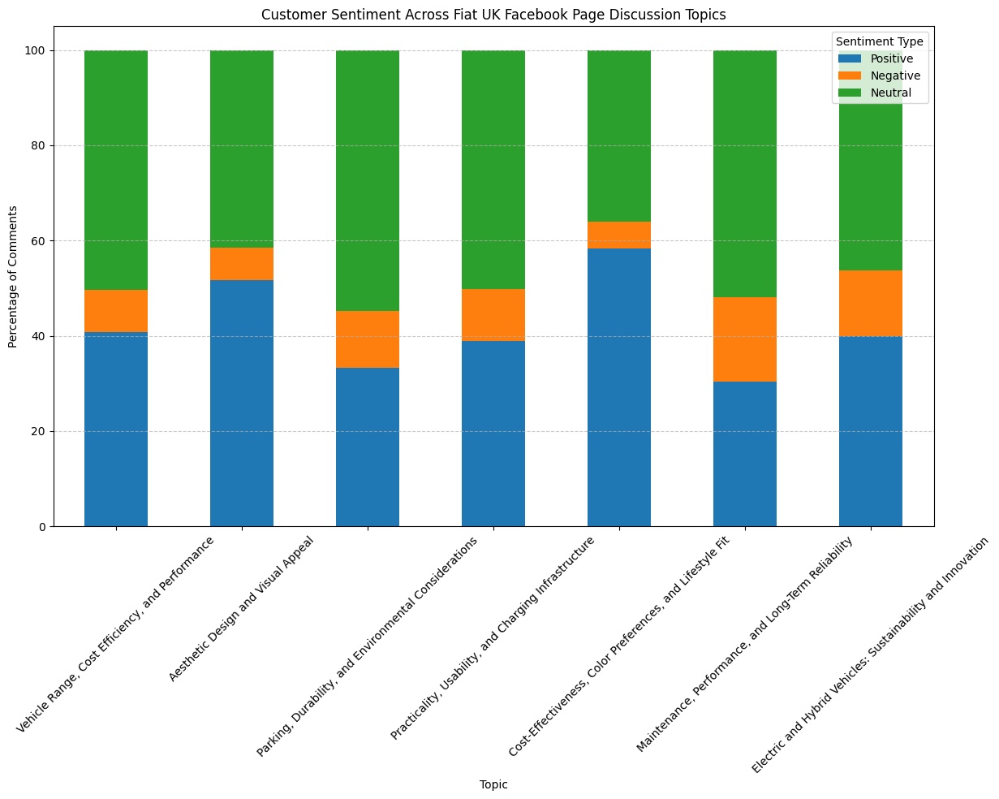

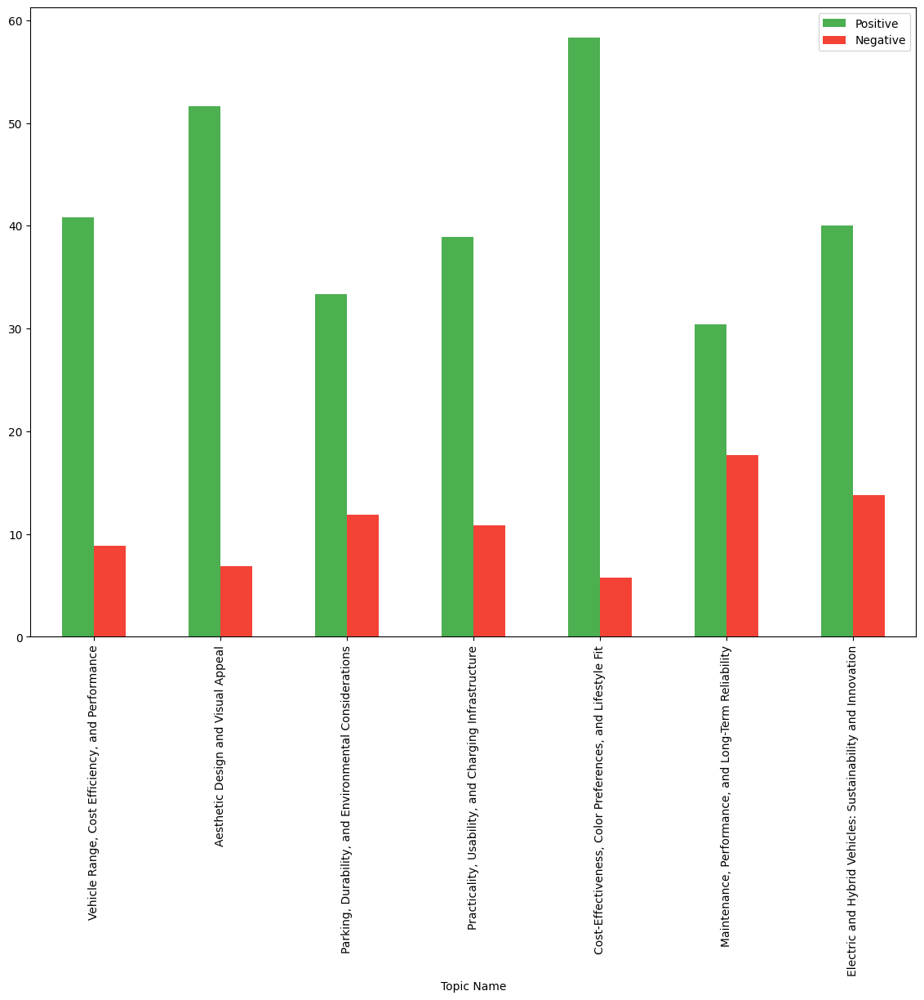

In [167]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Download necessary NLTK data
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Function to clean comments and remove unrelated words
def clean_and_filter(comment):
    words = word_tokenize(comment.lower())
    return " ".join([word for word in words if word.isalpha()])

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Create an empty DataFrame to store all comments with their topics
all_comments_df = pd.DataFrame()

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        topic_df['Topic'] = topic_name  # Add a new column for the topic name
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
        
        # Append the data for this topic to the all_comments_df
        all_comments_df = pd.concat([all_comments_df, topic_df], ignore_index=True)
    else:
        print(f'File for topic {topic_name} not found.')

# Save the concatenated DataFrame with topics to a new CSV file
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
all_comments_df.to_csv(file_path_csv, index=False)

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': [], 'Neutral': []}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:  # Avoid division by zero
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(sentiments['positive'] / total * 100)
        data['Negative'].append(sentiments['negative'] / total * 100)
        data['Neutral'].append(sentiments['neutral'] / total * 100)

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
df.plot(kind='bar', stacked=True, figsize=(14, 8))
plt.xlabel('Topic')
plt.ylabel('Percentage of Comments')
plt.title('Customer Sentiment Across Fiat UK Facebook Page Discussion Topics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Sentiment Type')
plt.xticks(rotation=45)

# Save the plot
plt.savefig(r'C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_distribution_across_topics.png', dpi=300)
plt.show()

# Plotting positive and negative sentiment distribution separately
ax = df[['Positive', 'Negative']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336'])

# Save the plot
plt.savefig(r'C:\Users\melis\OneDrive\Desktop\ARP 3\positive_vs_negative_sentiment_across_topics.png', dpi=300)
plt.show()


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


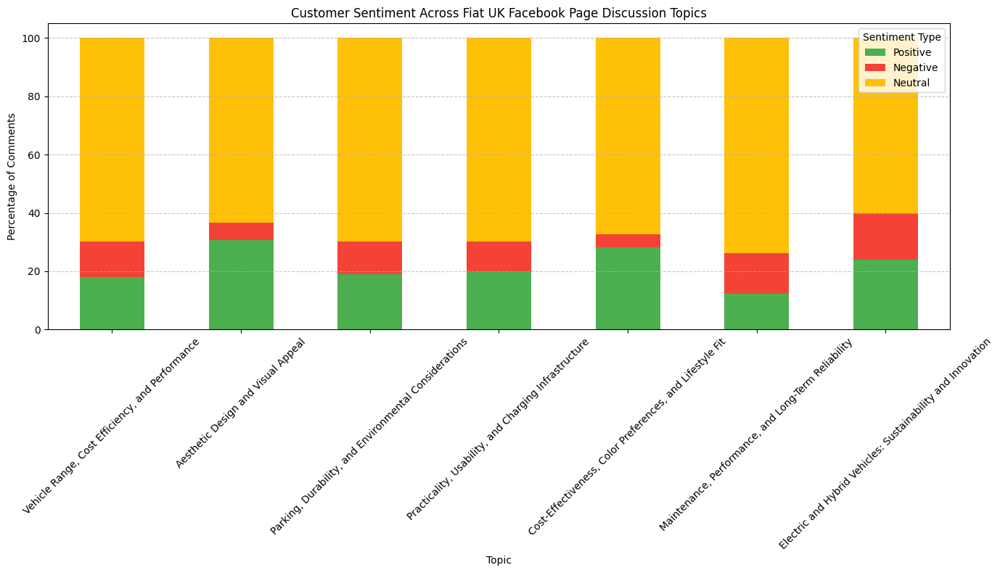

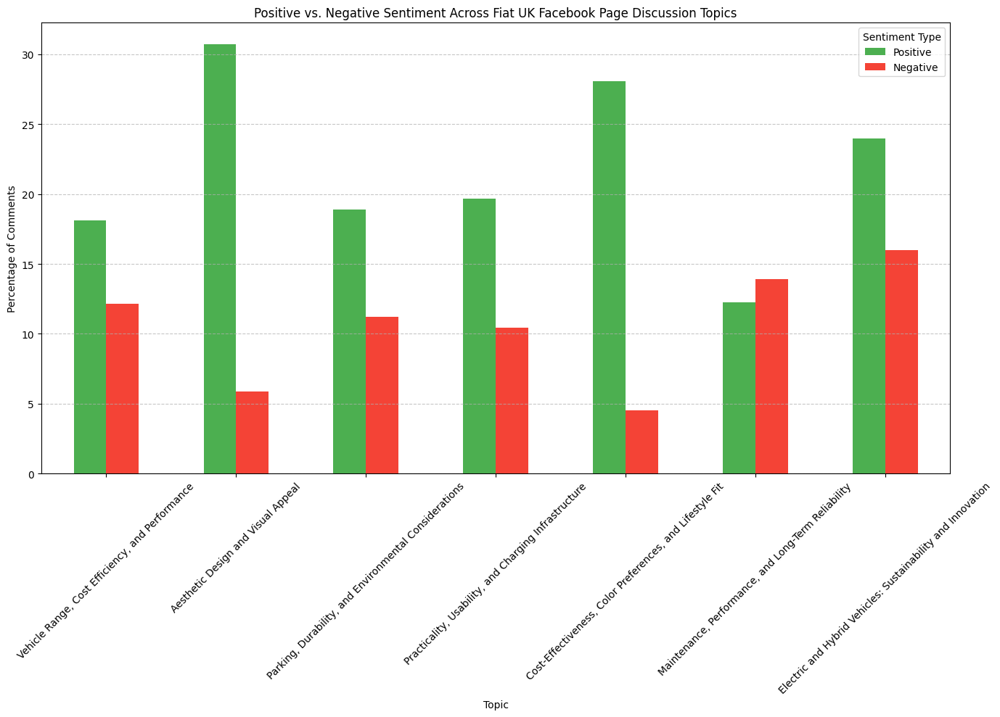

In [148]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Download necessary NLTK data
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()



# Function to clean comments and remove unrelated words
def clean_and_filter(comment):
    words = word_tokenize(comment.lower())
    return " ".join([word for word in words if word.isalpha() and word not in unrelated_words])

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': [], 'Neutral': []}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:  # Avoid division by zero
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(sentiments['positive'] / total * 100)
        data['Negative'].append(sentiments['negative'] / total * 100)
        data['Neutral'].append(sentiments['neutral'] / total * 100)

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
df.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#4CAF50', '#F44336', '#FFC107'])
plt.xlabel('Topic')
plt.ylabel('Percentage of Comments')
plt.title('Customer Sentiment Across Fiat UK Facebook Page Discussion Topics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Sentiment Type')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plotting positive and negative sentiment distribution separately
ax = df[['Positive', 'Negative']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336'])  # Increased height to 10
plt.xlabel('Topic')
plt.ylabel('Percentage of Comments')
plt.title('Positive vs. Negative Sentiment Across Fiat UK Facebook Page Discussion Topics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Sentiment Type')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


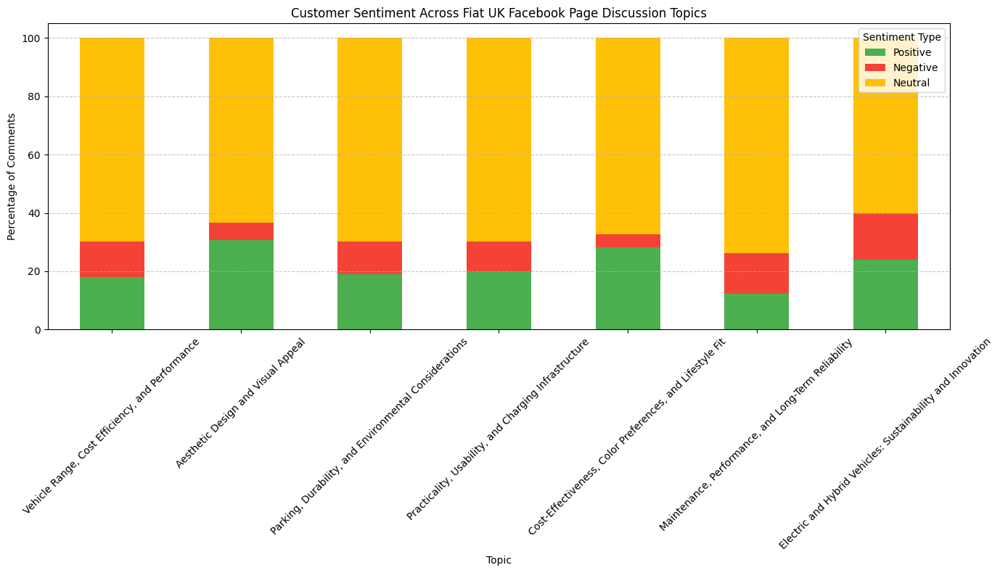

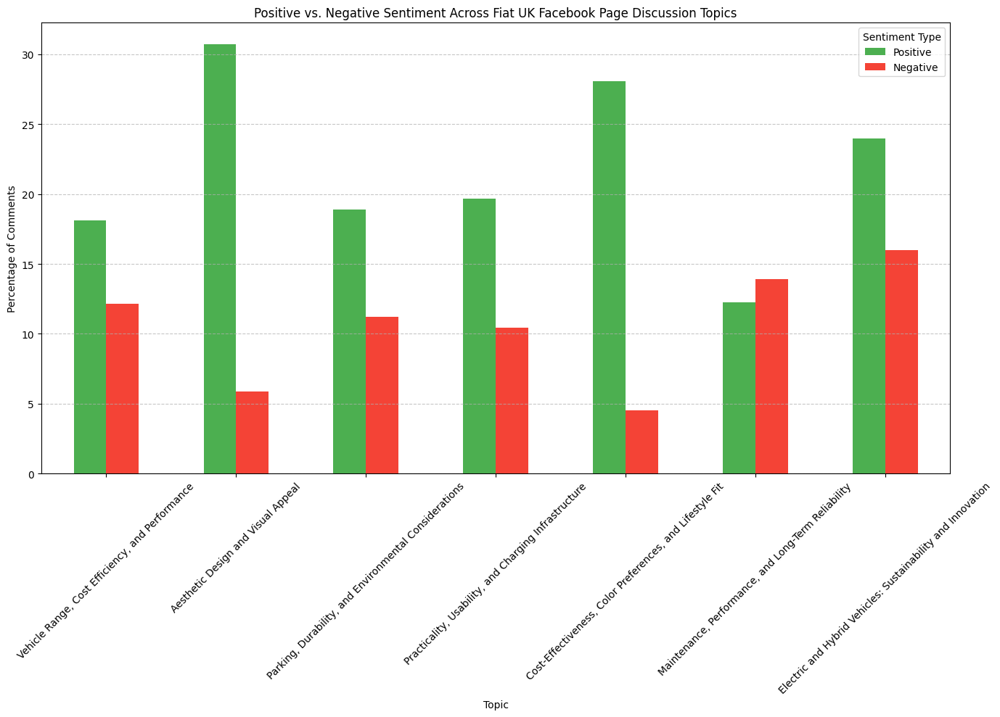

In [149]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Download necessary NLTK data
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()


# Function to clean comments and remove unrelated words
def clean_and_filter(comment):
    words = word_tokenize(comment.lower())
    return " ".join([word for word in words if word.isalpha() and word not in unrelated_words])

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': [], 'Neutral': []}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:  # Avoid division by zero
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(sentiments['positive'] / total * 100)
        data['Negative'].append(sentiments['negative'] / total * 100)
        data['Neutral'].append(sentiments['neutral'] / total * 100)

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
df.plot(kind='bar', stacked=True, figsize=(14, 8), color=['#4CAF50', '#F44336', '#FFC107'])
plt.xlabel('Topic')
plt.ylabel('Percentage of Comments')
plt.title('Customer Sentiment Across Fiat UK Facebook Page Discussion Topics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Sentiment Type')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plotting positive and negative sentiment distribution separately
ax = df[['Positive', 'Negative']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336'])  # Increased height to 10
plt.xlabel('Topic')
plt.ylabel('Percentage of Comments')
plt.title('Positive vs. Negative Sentiment Across Fiat UK Facebook Page Discussion Topics')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Sentiment Type')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [151]:
# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Print out the percentage results
for topic, sentiments in sentiment_counts.items():
    total_comments = sentiments['total']
    if total_comments > 0:
        positive_percent = (sentiments['positive'] / total_comments) * 100
        negative_percent = (sentiments['negative'] / total_comments) * 100
        neutral_percent = (sentiments['neutral'] / total_comments) * 100
        print(f"Topic {topic_names[topic]}:")
        print(f"   Positive: {positive_percent:.2f}%")
        print(f"   Negative: {negative_percent:.2f}%")
        print(f"   Neutral: {neutral_percent:.2f}%")
    else:
        print(f"Topic {topic_names[topic]} has no comments.")


Topic Vehicle Range, Cost Efficiency, and Performance:
   Positive: 18.09%
   Negative: 12.17%
   Neutral: 69.74%
Topic Aesthetic Design and Visual Appeal:
   Positive: 30.72%
   Negative: 5.88%
   Neutral: 63.40%
Topic Parking, Durability, and Environmental Considerations:
   Positive: 18.91%
   Negative: 11.22%
   Neutral: 69.87%
Topic Practicality, Usability, and Charging Infrastructure:
   Positive: 19.67%
   Negative: 10.46%
   Neutral: 69.87%
Topic Cost-Effectiveness, Color Preferences, and Lifestyle Fit:
   Positive: 28.10%
   Negative: 4.53%
   Neutral: 67.37%
Topic Maintenance, Performance, and Long-Term Reliability:
   Positive: 12.24%
   Negative: 13.92%
   Neutral: 73.84%
Topic Electric and Hybrid Vehicles: Sustainability and Innovation:
   Positive: 24.00%
   Negative: 16.00%
   Neutral: 60.00%


Positive vs Negative Sentiment Discussions per Topic

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


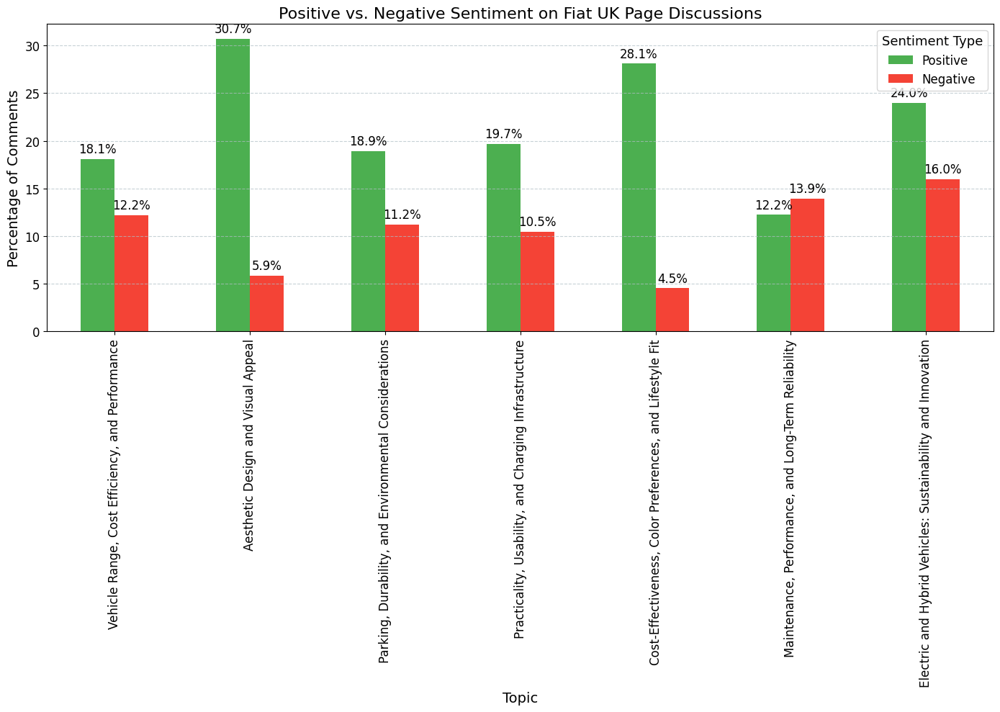

Ratios of Positive to Negative Sentiments:
Vehicle Range, Cost Efficiency, and Performance: 1.49
Aesthetic Design and Visual Appeal: 5.22
Parking, Durability, and Environmental Considerations: 1.69
Practicality, Usability, and Charging Infrastructure: 1.88
Cost-Effectiveness, Color Preferences, and Lifestyle Fit: 6.20
Maintenance, Performance, and Long-Term Reliability: 0.88
Electric and Hybrid Vehicles: Sustainability and Innovation: 1.50


In [152]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Ensure the VADER lexicon and the punkt tokenizer are downloaded
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}
# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()


# Function to clean comments and remove unrelated words
def clean_and_filter(comment):
    words = word_tokenize(comment.lower())
    return " ".join([word for word in words if word.isalpha() and word not in unrelated_words])

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': []}
ratios = {}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:
        pos_percentage = sentiments['positive'] / total * 100
        neg_percentage = sentiments['negative'] / total * 100
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(pos_percentage)
        data['Negative'].append(neg_percentage)
        # Calculate and store ratio of Positive to Negative sentiments
        ratios[topic_names[topic]] = pos_percentage / max(neg_percentage, 1)  # Avoid division by zero

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
ax = df[['Positive', 'Negative']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336'])  # Increased height to 10
plt.xlabel('Topic', fontsize=14)
plt.ylabel('Percentage of Comments', fontsize=14)
plt.title('Positive vs. Negative Sentiment on Fiat UK Page Discussions', fontsize=16)
plt.grid(axis='y', linestyle='--', alpha=0.7, color='#B0BEC5')  # Soft grey grid lines

# Adding percentages on top of the bars without bold text
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'center', 
                xytext = (0, 10), 
                textcoords = 'offset points',
                fontsize=12, color='black')  # Regular text annotations

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sentiment Type', fontsize=12, title_fontsize='13')
plt.tight_layout()
plt.show()

# Print the ratios of Positive to Negative sentiments for each topic
print("Ratios of Positive to Negative Sentiments:")
for topic, ratio in ratios.items():
    print(f"{topic}: {ratio:.2f}")


General Sentiment Distribution Across Topics 

In [ ]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Ensure the VADER lexicon and the punkt tokenizer are downloaded
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Updated list of unrelated words for Fiat Dolce Vita car analysis

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Convert to lowercase for consistency
    comment = comment.lower()
    
    # Custom rules to catch phrases that indicate negative sentiment
    negative_phrases = ["never", "if only", "but", "pricey", "sleepy face", "could change", "expensive", "help", "you should", "even", "link", "offer", "bring back", "charges", "no arm", "lost",
                        "what the hell", "doesn't work", "don't like", "would love", "giraffe", "stinks", "fix", "died", "doesn't seem", "in the queue", "combustible", "scrap yard", "never seen", "why", 
                        "not be able to", "don't think so", "leaving", "disgusting", "washy", "breaks down"]
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    
    # Custom rule for specific positive context
    positive_phrases = ["want bad", "need", "give world", "very dated", "my next", "iconic", "legend", "lovely", "lovly", "last longer", "heart", "proud", "love", "can't wait",
                        "thank you", "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", "tagged person", "got few ideas", "this is the car", "it melts", "enough", 
                        "my lil", "best", "my little", "amazing", "lurrrrvve", "honoured", "great", "old", "person", "tagged"]
    if any(phrase in comment for phrase in positive_phrases):
        return "positive"
    
    # Custom rule for specific neutral context
    neutral_phrases = ["bright yellow", "slate grey"]
    if any(phrase in comment for phrase in neutral_phrases):
        return "neutral"

  

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': [], 'Neutral': []}
ratios = {}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:
        pos_percentage = sentiments['positive'] / total * 100
        neg_percentage = sentiments['negative'] / total * 100
        neu_percentage = sentiments['neutral'] / total * 100
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(pos_percentage)
        data['Negative'].append(neg_percentage)
        data['Neutral'].append(neu_percentage)
        # Calculate and store ratio of Positive to Negative sentiments
        ratios[topic_names[topic]] = pos_percentage / max(neg_percentage, 1)  # Avoid division by zero

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
ax = df[['Positive', 'Negative', 'Neutral']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336', '#FFC107'])  # Added Neutral color
plt.xlabel('Topic', fontsize=14)
plt.ylabel('Percentage of Comments', fontsize=14)
plt.title('Positive vs. Negative vs. Neutral Sentiment on Fiat UK Page Discussions', fontsize=16)
plt.grid(axis='y', linestyle='--', alpha=0.7, color='#B0BEC5')  # Soft grey grid lines

# Adding percentages on top of the bars without bold text
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'center', 
                xytext = (0, 10), 
                textcoords = 'offset points',
                fontsize=12, color='black')  # Regular text annotations

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sentiment Type', fontsize=12, title_fontsize='13')
plt.tight_layout()
plt.show()

# Print the ratios of Positive to Negative sentiments for each topic
print("Ratios of Positive to Negative Sentiments:")
for topic, ratio in ratios.items():
    print(f"{topic}: {ratio:.2f}")


In [203]:
import pandas as pd
import os
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk

# Ensure the VADER lexicon is downloaded
nltk.download('vader_lexicon')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Normalize the comment
    comment = comment.lower().replace('.', '').replace(',', '').replace('!', '').replace('?', '')

    # Define phrases
    negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help", 
        "even", "offer", "bring back", "doesn't work", "don't like", "would love", 
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen", 
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend", 
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you", 
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", 
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"
    ]

    # Check for custom phrases
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        return "positive"
    
    # Fallback to VADER analysis
    scores = sid.polarity_scores(comment)
    if scores['compound'] > 0.05:
        return "positive"
    elif scores['compound'] < -0.05:
        return "negative"
    else:
        return "neutral"

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = os.path.join(directory_path, f'facebook_comments_final_2_finaltopic_{topic_num}_comments.csv')
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        print(f'Analyzing {topic_name}...')
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            print(f'Comment: {comment[:30]}... Sentiment: {sentiment}')
    else:
        print(f'File for topic {topic_name} not found.')


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Analyzing Vehicle Range, Cost Efficiency, and Performance...
Comment: erin grace wykes... Sentiment: positive
Comment: its time fiat brought out a hy... Sentiment: neutral
Comment: olly holmes nice don't tell ru... Sentiment: positive
Comment: old petrol one. electric is us... Sentiment: positive
Comment: i have a hybrid 500 absolutely... Sentiment: negative
Comment: i had a test drive of an elect... Sentiment: negative
Comment: i had a test drive of an elect... Sentiment: negative
Comment: i had a test drive of an elect... Sentiment: negative
Comment: i had a test drive of an elect... Sentiment: negative
Comment: i had a test drive of an elect... Sentiment: negative
Comment: i had a test drive of an elect... Sentiment: negative
Comment: i had a test drive of an elect... Sentiment: negative
Comment: ade pope... Sentiment: neutral
Comment: front looks good, back and sid... Sentiment: positive
Comment: angie needham... Sentiment: positive
Comment: tagged person whitby... Sentiment: neutr

In [207]:
import pandas as pd
import os
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk

# Ensure the VADER lexicon is downloaded
nltk.download('vader_lexicon')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

def preprocess_text(comment):
    # Normalize the comment
    return comment.lower().replace('.', '').replace(',', '').replace('!', '').replace('?', '')

def check_phrases(comment, phrases):
    return any(phrase in comment for phrase in phrases)

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    comment = preprocess_text(comment)
    # Define phrases
    negative_phrases = ["never", "expensive", "breaks down", "doesn't work"]
    positive_phrases = ["love", "best", "amazing", "thank you"]

    # Enhanced checks for phrases
    if check_phrases(comment, negative_phrases):
        return "negative"
    elif check_phrases(comment, positive_phrases):
        return "positive"

    # Fallback to VADER analysis
    scores = sid.polarity_scores(comment)
    return "positive" if scores['compound'] > 0.05 else "negative" if scores['compound'] < -0.05 else "neutral"

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = os.path.join(directory_path, f'facebook_comments_final_2_finaltopic_{topic_num}_comments.csv')
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        print(f'Analyzing {topic_name}...')
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            print(f'Comment: {comment[:50]}... Sentiment: {sentiment}')
    else:
        print(f'File for topic {topic_name} not found.')


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Analyzing Vehicle Range, Cost Efficiency, and Performance...
Comment: erin grace wykes... Sentiment: positive
Comment: its time fiat brought out a hybrid 500x... Sentiment: neutral
Comment: olly holmes nice don't tell ruby ... Sentiment: positive
Comment: old petrol one. electric is useless to me unless y... Sentiment: negative
Comment: i have a hybrid 500 absolutely love it but not sur... Sentiment: negative
Comment: i had a test drive of an electric 500. it was very... Sentiment: neutral
Comment: i had a test drive of an electric 500. it was very... Sentiment: neutral
Comment: i had a test drive of an electric 500. it was very... Sentiment: neutral
Comment: i had a test drive of an electric 500. it was very... Sentiment: neutral
Comment: i had a test drive of an electric 500. it was very... Sentiment: neutral
Comment: i had a test drive of an electric 500. it was very... Sentiment: neutral
Comment: i had a test drive of an electric 500. it was very... Sentiment: neutral
Comment: ade 

In [211]:
def custom_sentiment_analysis(comment):
    # Normalize the comment by converting to lowercase
    comment = comment.lower()

    # Define phrases
    negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help",
        "even", "offer", "bring back", "doesn't work", "don't like", "would love",
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen",
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend",
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you",
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved",
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"
    ]

    # Check for custom phrases
    if any(phrase in comment for phrase in negative_phrases):
        print(f"Detected negative phrase in comment: '{comment}'")
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        print(f"Detected positive phrase in comment: '{comment}'")
        return "positive"
    
    # If no custom phrases match, categorize as neutral
    print(f"No specific phrases detected, defaulting to neutral for comment: '{comment}'")
    return "neutral"

# Example usage of the function with a sample comment
sample_comment = "This car is expensive but I would love it in navy blue."
sample_sentiment = custom_sentiment_analysis(sample_comment)
print(f"Sentiment for sample comment: {sample_sentiment}")


Detected negative phrase in comment: 'this car is expensive but i would love it in navy blue.'
Sentiment for sample comment: negative


In [212]:
def custom_sentiment_analysis(comment):
    # Normalize the comment by converting to lowercase
    comment = comment.lower()

    # Define phrases
    negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help",
        "even", "offer", "bring back", "doesn't work", "don't like",
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen",
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend",
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you",
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved",
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old",
        "would love"
    ]

    # Check for custom phrases
    if any(phrase in comment for phrase in negative_phrases):
        print(f"Detected negative phrase in comment: '{comment}'")
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        print(f"Detected positive phrase in comment: '{comment}'")
        return "positive"
    
    # If no custom phrases match, categorize as neutral
    print(f"No specific phrases detected, defaulting to neutral for comment: '{comment}'")
    return "neutral"

# Example usage of the function with a sample comment
sample_comment = "This car is expensive but I would love it in navy blue."
sample_sentiment = custom_sentiment_analysis(sample_comment)
print(f"Sentiment for sample comment: {sample_sentiment}")


Detected negative phrase in comment: 'this car is expensive but i would love it in navy blue.'
Sentiment for sample comment: negative


In [213]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Ensure the VADER lexicon and the punkt tokenizer are downloaded
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Define the clean and filter function
def clean_and_filter(comment):
    # Convert comment to lowercase to handle case insensitivity
    comment = comment.lower()
    # Tokenize the comment
    words = word_tokenize(comment)
    # List of unrelated words for filtering
    unrelated_words = ["buy", "sale", "discount", "promotion", "ad"]
    # Filtering out unrelated words
    filtered_words = [word for word in words if word not in unrelated_words]
    # Join words back into string
    return ' '.join(filtered_words)

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Clean and filter comment
    comment = clean_and_filter(comment)
    # Custom lists of phrases to detect specific sentiments
    negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help", 
        "even", "offer", "bring back", "doesn't work", "don't like", "would love", 
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen", 
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend", 
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you", 
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", 
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"
    ]
    # Evaluate phrases
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        return "positive"
    # Fallback to VADER analysis if no custom phrases match
    scores = sid.polarity_scores(comment)
    return "positive" if scores['compound'] > 0.05 else "negative" if scores['compound'] < -0.05 else "neutral"

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            sentiment_counts[topic_num][sentiment] += 1
            sentiment_counts[topic_num]['total'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Plotting, visualization, and additional code follow as in the previous example...


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


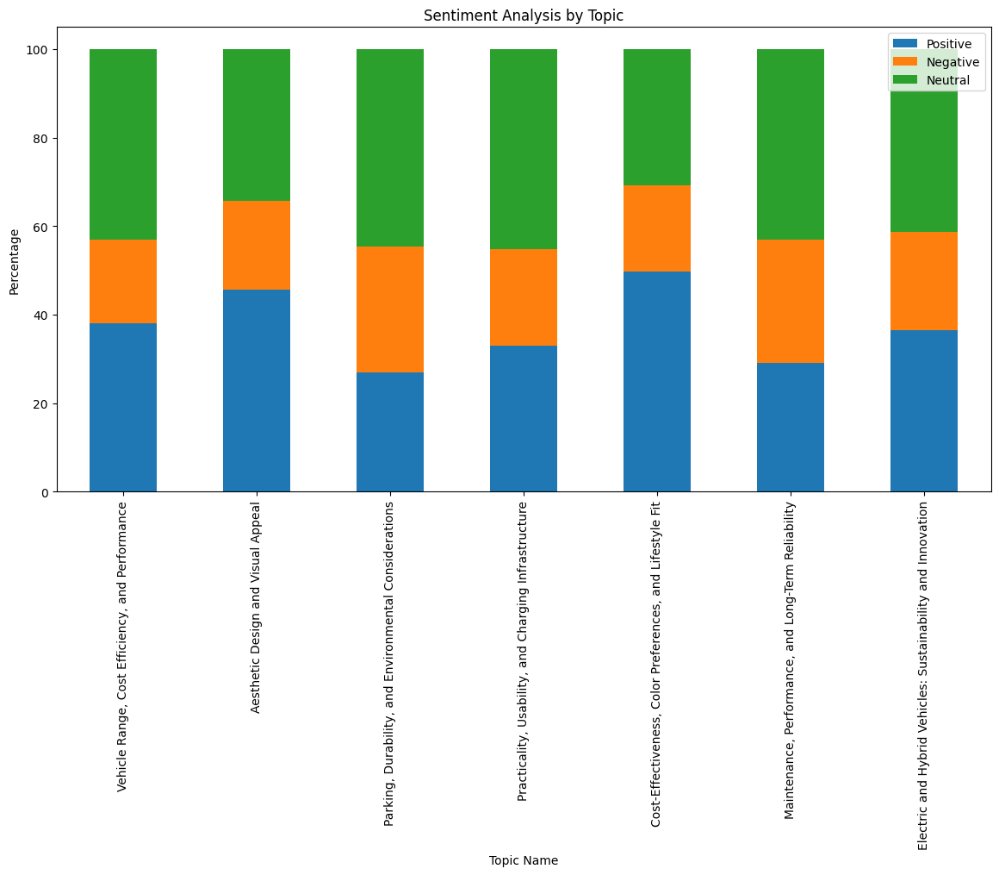

In [202]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk

# Ensure the VADER lexicon is downloaded
nltk.download('vader_lexicon')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Convert to lowercase for consistency
    comment = comment.lower()
    
    # Custom rules to catch specific sentiments
    negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help", 
        "even", "offer", "bring back", "doesn't work", "don't like", "would love", 
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen", 
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend", 
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you", 
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", 
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"
    ]

    # First, check for any custom phrases that may indicate a specific sentiment
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        return "positive"
    
    # If no custom phrases match, use VADER to analyze sentiment
    scores = sid.polarity_scores(comment)
    if scores['compound'] > 0.05:
        return "positive"
    elif scores['compound'] < -0.05:
        return "negative"
    else:
        return "neutral"

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = os.path.join(directory_path, f'facebook_comments_final_2_finaltopic_{topic_num}_comments.csv')
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            sentiment_counts[topic_num][sentiment] += 1
            sentiment_counts[topic_num]['total'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Save the results to a CSV file
result_df = pd.DataFrame([
    {
        'Topic Name': topic_names[topic],
        'Positive': (counts['positive'] / counts['total']) * 100 if counts['total'] > 0 else 0,
        'Negative': (counts['negative'] / counts['total']) * 100 if counts['total'] > 0 else 0,
        'Neutral': (counts['neutral'] / counts['total']) * 100 if counts['total'] > 0 else 0
    }
    for topic, counts in sentiment_counts.items()
])
result_df.to_csv(os.path.join(directory_path, 'sentiment_analysis_results__.csv'), index=False)

# Optionally plot the results
result_df.set_index('Topic Name').plot(kind='bar', stacked=True, figsize=(14, 7))
plt.title('Sentiment Analysis by Topic')
plt.ylabel('Percentage')
plt.show()


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


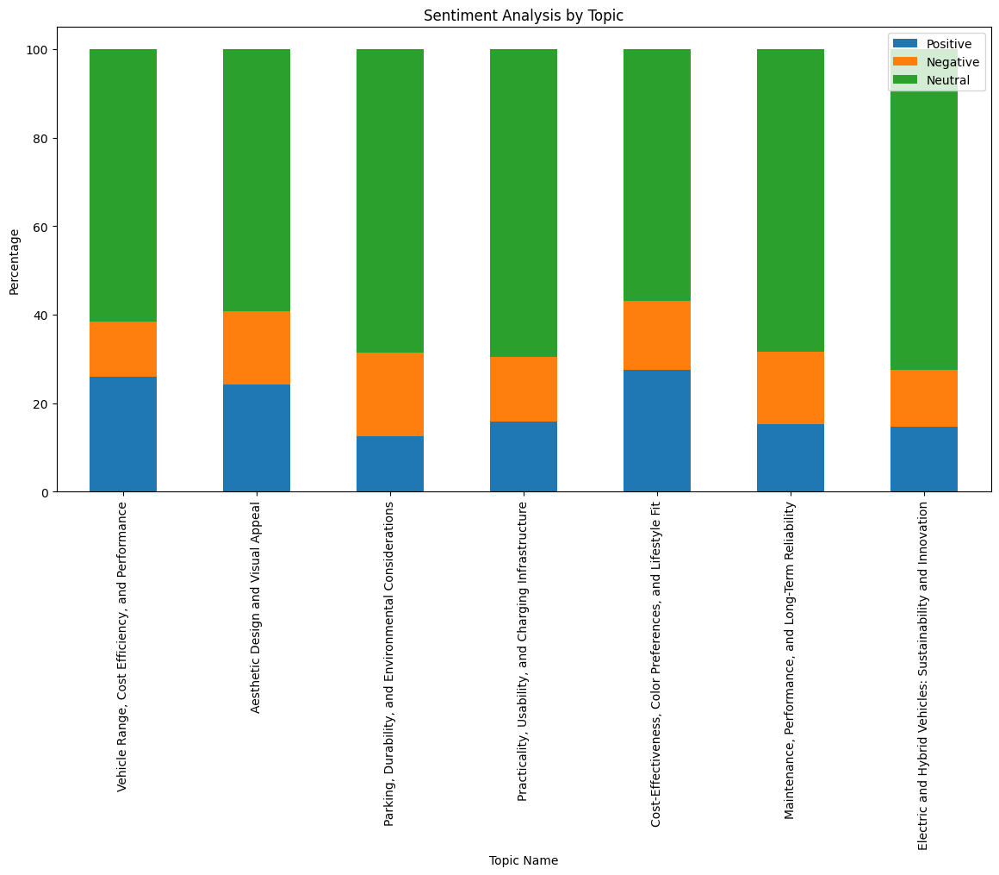

In [201]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk

# Ensure the VADER lexicon is downloaded
nltk.download('vader_lexicon')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Convert to lowercase for consistency
    comment = comment.lower()
    
    # Custom rules to catch specific sentiments
    negative_phrases = ["never", "if only", "but", "pricey", "could change", "expensive", "help", "even", "offer", "bring back", "doesn't work", "don't like", "would love", "stinks", "fix", "died", "combustible", "scrap yard", "never seen", "not be able to", "leaving", "disgusting", "washy", "breaks down"]
    positive_phrases = ["want bad", "need", "give world", "very dated", "my next", "iconic", "legend", "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you", "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"]

    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        return "positive"
    else:
        return "neutral"  # Default to neutral if no keywords match

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = os.path.join(directory_path, f'facebook_comments_final_2_finaltopic_{topic_num}_comments.csv')
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            sentiment_counts[topic_num][sentiment] += 1
            sentiment_counts[topic_num]['total'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Save the results to a CSV file
result_df = pd.DataFrame([
    {
        'Topic Name': topic_names[topic],
        'Positive': (counts['positive'] / counts['total']) * 100 if counts['total'] > 0 else 0,
        'Negative': (counts['negative'] / counts['total']) * 100 if counts['total'] > 0 else 0,
        'Neutral': (counts['neutral'] / counts['total']) * 100 if counts['total'] > 0 else 0
    }
    for topic, counts in sentiment_counts.items()
])
result_df.to_csv(os.path.join(directory_path, 'sentiment_analysis_results_.csv'), index=False)

# Optionally plot the results
result_df.set_index('Topic Name').plot(kind='bar', stacked=True, figsize=(14, 7))
plt.title('Sentiment Analysis by Topic')
plt.ylabel('Percentage')
plt.show()


In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import pandas as pd

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Convert to lowercase for consistency
    comment = comment.lower()
    
    # Custom rules to catch phrases that indicate negative sentiment
    negative_phrases = ["never", "if only", "but", "pricey", "sleepy face", "could change", "expensive", "help", "you should", "even", "link", "offer", "bring back", "charges", "no arm", "lost",
                        "what the hell", "doesn't work", "don't like", "would love", "giraffe", "stinks", "fix", "died", "doesn't seem", "in the queue", "combustible", "scrap yard", "never seen", "why", 
                        "not be able to", "don't think so", "leaving", "disgusting", "washy", "breaks down"]
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    
    # Custom rule for specific positive context
    positive_phrases = ["want bad", "need", "give world", "very dated", "my next", "iconic", "legend", "lovely", "lovly", "last longer", "heart", "proud", "love", "can't wait",
                        "thank you", "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", "tagged person", "got few ideas", "this is the car", "it melts", "enough", 
                        "my lil", "best", "my little", "amazing", "lurrrrvve", "honoured", "great", "old"]
    if any(phrase in comment for phrase in positive_phrases):
        return "positive"
    
    # Custom rule for specific neutral context
    neutral_phrases = ["bright yellow", "slate grey"]
    if any(phrase in comment for phrase in neutral_phrases):
        return "neutral"

  
    
    # Fallback to VADER analysis for other cases
    analyzer = SentimentIntensityAnalyzer()
    score = analyzer.polarity_scores(comment)
    
    if score['neg'] > score['pos']:
        return "negative"
    elif score['pos'] > score['neg']:
        return "positive"
    else:
        return "neutral"

# Load the dataset
df = pd.read_csv(r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_6.csv")

# Apply custom sentiment analysis, ignoring 'tagged person' comments
df['custom_sentiment'] = df['cleaned_translated_comment'].apply(custom_sentiment_analysis)

# Check the results
print(df[['cleaned_translated_comment', 'sentiment', 'custom_sentiment']].head())

# Save the updated DataFrame to a new CSV file
sentiment_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"
df.to_csv(sentiment_file_path, index=False)

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


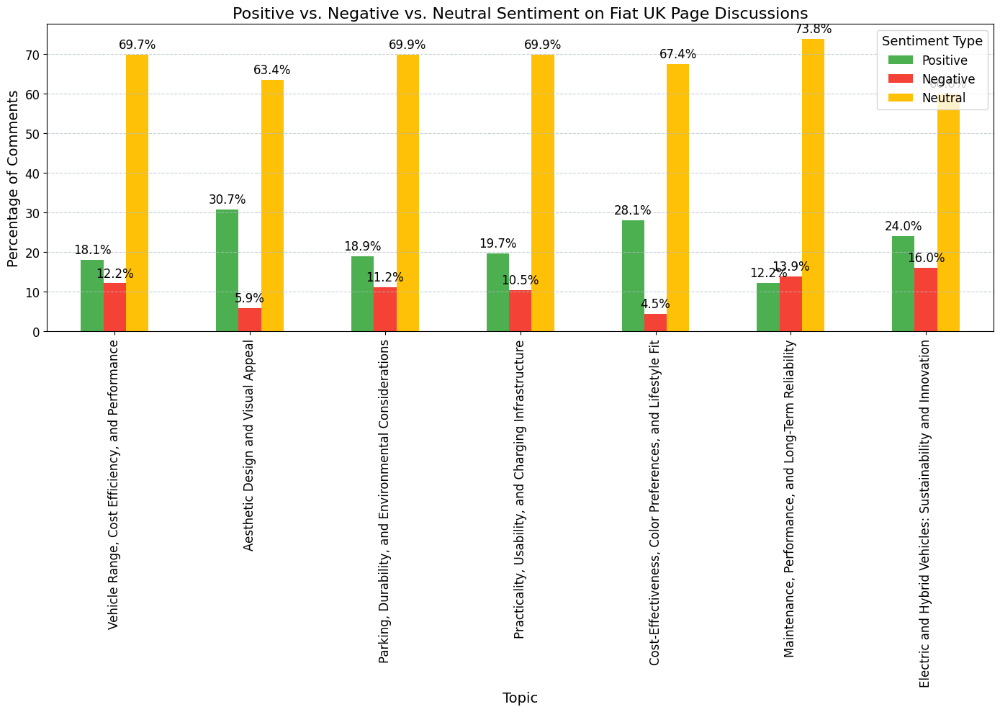

Ratios of Positive to Negative Sentiments:
Vehicle Range, Cost Efficiency, and Performance: 1.49
Aesthetic Design and Visual Appeal: 5.22
Parking, Durability, and Environmental Considerations: 1.69
Practicality, Usability, and Charging Infrastructure: 1.88
Cost-Effectiveness, Color Preferences, and Lifestyle Fit: 6.20
Maintenance, Performance, and Long-Term Reliability: 0.88
Electric and Hybrid Vehicles: Sustainability and Innovation: 1.50


In [153]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Ensure the VADER lexicon and the punkt tokenizer are downloaded
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Updated list of unrelated words for Fiat Dolce Vita car analysis


# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            sentiment_counts[topic_num]['total'] += 1
            if scores['compound'] > 0.05:
                sentiment_counts[topic_num]['positive'] += 1
            elif scores['compound'] < -0.05:
                sentiment_counts[topic_num]['negative'] += 1
            else:
                sentiment_counts[topic_num]['neutral'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Prepare data for visualization
data = {'Topic Name': [], 'Positive': [], 'Negative': [], 'Neutral': []}
ratios = {}
for topic, sentiments in sentiment_counts.items():
    total = sentiments['total']
    if total > 0:
        pos_percentage = sentiments['positive'] / total * 100
        neg_percentage = sentiments['negative'] / total * 100
        neu_percentage = sentiments['neutral'] / total * 100
        data['Topic Name'].append(topic_names[topic])
        data['Positive'].append(pos_percentage)
        data['Negative'].append(neg_percentage)
        data['Neutral'].append(neu_percentage)
        # Calculate and store ratio of Positive to Negative sentiments
        ratios[topic_names[topic]] = pos_percentage / max(neg_percentage, 1)  # Avoid division by zero

# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
ax = df[['Positive', 'Negative', 'Neutral']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336', '#FFC107'])  # Added Neutral color
plt.xlabel('Topic', fontsize=14)
plt.ylabel('Percentage of Comments', fontsize=14)
plt.title('Positive vs. Negative vs. Neutral Sentiment on Fiat UK Page Discussions', fontsize=16)
plt.grid(axis='y', linestyle='--', alpha=0.7, color='#B0BEC5')  # Soft grey grid lines

# Adding percentages on top of the bars without bold text
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'center', 
                xytext = (0, 10), 
                textcoords = 'offset points',
                fontsize=12, color='black')  # Regular text annotations

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sentiment Type', fontsize=12, title_fontsize='13')
plt.tight_layout()
plt.show()

# Print the ratios of Positive to Negative sentiments for each topic
print("Ratios of Positive to Negative Sentiments:")
for topic, ratio in ratios.items():
    print(f"{topic}: {ratio:.2f}")


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


                                                Topic  negative  neutral  \
0                  Aesthetic Design and Visual Appeal        18      194   
1                  Aesthetic Design and Visual Appeal        18      194   
2                  Aesthetic Design and Visual Appeal        18      194   
3                  Aesthetic Design and Visual Appeal        18      194   
4                  Aesthetic Design and Visual Appeal        18      194   
...                                               ...       ...      ...   
1949  Vehicle Range, Cost Efficiency, and Performance        37      212   
1950  Vehicle Range, Cost Efficiency, and Performance        37      212   
1951  Vehicle Range, Cost Efficiency, and Performance        37      212   
1952  Vehicle Range, Cost Efficiency, and Performance        37      212   
1953  Vehicle Range, Cost Efficiency, and Performance        37      212   

      positive                                            Comment Sentiment  
0        

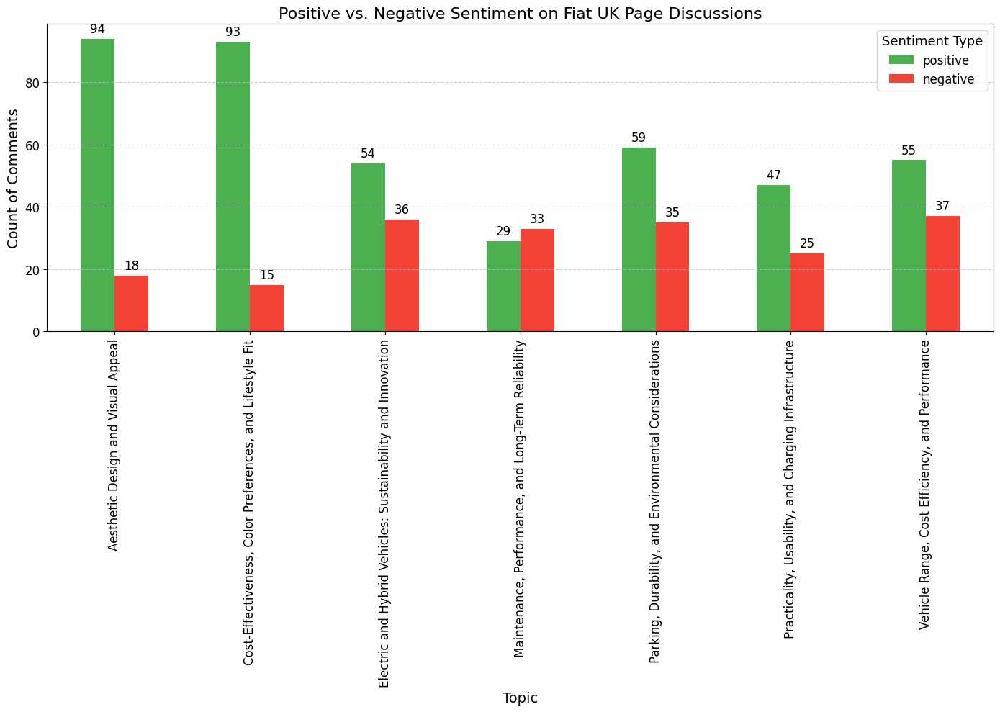

Updated file saved to: C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_with_topics.csv

Comments with positive sentiment:

happy birthday fiat from a proud 500e owner!
my smile! need to get a nicer pic on a sunny day … collection day it rained but not on my parade
my smile! need to get a nicer pic on a sunny day … collection day it rained but not on my parade
i had a fiat 600 and enjoyed the service in 64-66
congratulations and best wishes to you fiat
beautiful
omg i love this, surely i cant go for another swap, fiat 500c no. 4 !!!!! tagged person
beautiful 
i wish you could somehow turn it into a four door. that would be a brilliant idea 
500 minutes tops
got mine today. here is sexy 
my lovely fiat 500l trekking!
my lovely fiat 500l trekking!
my lovely fiat 500l trekking!
beautiful
my punto easy getting old. why did you stop making them?! perfect car for me. tried a 500 for a year. went back to punto
oh! it is sexy stuart
beautiful
huge space even i could do that
yo

In [154]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Ensure the VADER lexicon and the punkt tokenizer are downloaded
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Dictionary to store sentiment data
sentiment_data = []

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            filtered_comment = clean_and_filter(comment)
            scores = sid.polarity_scores(filtered_comment)
            
            if scores['compound'] > 0.05:
                sentiment_type = 'positive'
            elif scores['compound'] < -0.05:
                sentiment_type = 'negative'
            else:
                sentiment_type = 'neutral'
                
            # Store the topic, comment, and sentiment type
            sentiment_data.append({
                'Topic': topic_name,
                'Comment': comment,
                'Sentiment': sentiment_type
            })
    else:
        print(f'File for topic {topic_name} not found.')

# Convert sentiment data to a DataFrame
sentiment_df = pd.DataFrame(sentiment_data)

# Create pivot table to count the number of each type of sentiment per topic
pivot_table = sentiment_df.pivot_table(index='Topic', columns='Sentiment', aggfunc='size', fill_value=0)

# Merge with the previous data 
merged_df = pd.merge(pivot_table.reset_index(), sentiment_df, on='Topic', how='inner')

# Display the merged DataFrame
print(merged_df)

# Plotting the sentiment distribution
ax = pivot_table[['positive', 'negative']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336'])
plt.xlabel('Topic', fontsize=14)
plt.ylabel('Count of Comments', fontsize=14)
plt.title('Positive vs. Negative Sentiment on Fiat UK Page Discussions', fontsize=16)
plt.grid(axis='y', linestyle='--', alpha=0.7, color='#B0BEC5')

# Adding count annotations on top of the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize=12, color='black')

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sentiment Type', fontsize=12, title_fontsize='13')
plt.tight_layout()
plt.show()

# Saving the merged DataFrame to a CSV
output_file_path = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_with_topics.csv"
merged_df.to_csv(output_file_path, index=False)
print(f"Updated file saved to: {output_file_path}")

# Output comments grouped by sentiment type
for sentiment in ['positive', 'negative', 'neutral']:
    print(f"\nComments with {sentiment} sentiment:\n")
    comments = merged_df[merged_df['Sentiment'] == sentiment]['Comment'].tolist()
    for comment in comments:
        print(comment)


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


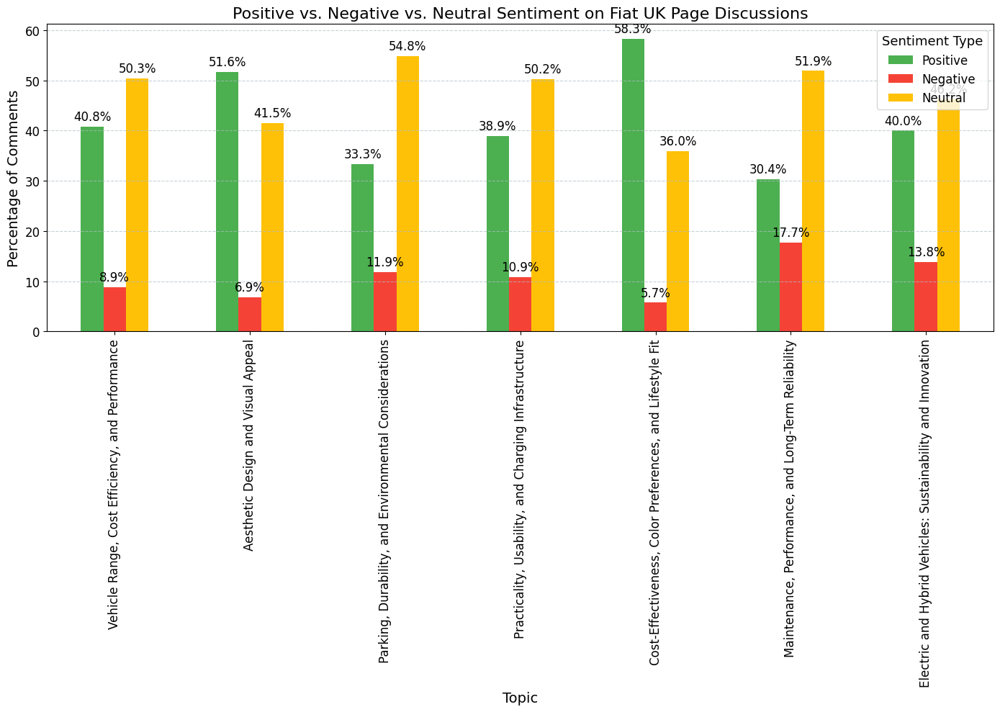

Ratios of Positive to Negative Sentiments:
Vehicle Range, Cost Efficiency, and Performance: 1.49
Aesthetic Design and Visual Appeal: 5.22
Parking, Durability, and Environmental Considerations: 1.69
Practicality, Usability, and Charging Infrastructure: 1.88
Cost-Effectiveness, Color Preferences, and Lifestyle Fit: 6.20
Maintenance, Performance, and Long-Term Reliability: 0.88
Electric and Hybrid Vehicles: Sustainability and Innovation: 1.50


In [214]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Ensure the VADER lexicon and the punkt tokenizer are downloaded
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Define the clean and filter function
def clean_and_filter(comment):
    # Convert comment to lowercase to handle case insensitivity
    comment = comment.lower()
    # Tokenize the comment
    words = word_tokenize(comment)
    # List of unrelated words for filtering
    unrelated_words = ["buy", "sale", "discount", "promotion", "ad"]
    # Filtering out unrelated words
    filtered_words = [word for word in words if word not in unrelated_words]
    # Join words back into string
    return ' '.join(filtered_words)

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Clean and filter comment
    comment = clean_and_filter(comment)
    # Custom lists of phrases to detect specific sentiments
    negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help", 
        "even", "offer", "bring back", "doesn't work", "don't like", "would love", 
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen", 
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend", 
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you", 
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", 
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"
    ]
    # Evaluate phrases
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        return "positive"
    # Fallback to VADER analysis if no custom phrases match
    scores = sid.polarity_scores(comment)
    return "positive" if scores['compound'] > 0.05 else "negative" if scores['compound'] < -0.05 else "neutral"

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            sentiment_counts[topic_num][sentiment] += 1
            sentiment_counts[topic_num]['total'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Plotting, visualization, and additional code follow as in the previous example...
# Plotting the sentiment distribution
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)
ax = df[['Positive', 'Negative', 'Neutral']].plot(kind='bar', figsize=(14, 10), color=['#4CAF50', '#F44336', '#FFC107'])  # Added Neutral color
plt.xlabel('Topic', fontsize=14)
plt.ylabel('Percentage of Comments', fontsize=14)
plt.title('Positive vs. Negative vs. Neutral Sentiment on Fiat UK Page Discussions', fontsize=16)
plt.grid(axis='y', linestyle='--', alpha=0.7, color='#B0BEC5')  # Soft grey grid lines

# Adding percentages on top of the bars without bold text
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'center', 
                xytext = (0, 10), 
                textcoords = 'offset points',
                fontsize=12, color='black')  # Regular text annotations

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Sentiment Type', fontsize=12, title_fontsize='13')
plt.tight_layout()
plt.show()

# Print the ratios of Positive to Negative sentiments for each topic
print("Ratios of Positive to Negative Sentiments:")
for topic, ratio in ratios.items():
    print(f"{topic}: {ratio:.2f}")


<Figure size 2000x1200 with 0 Axes>

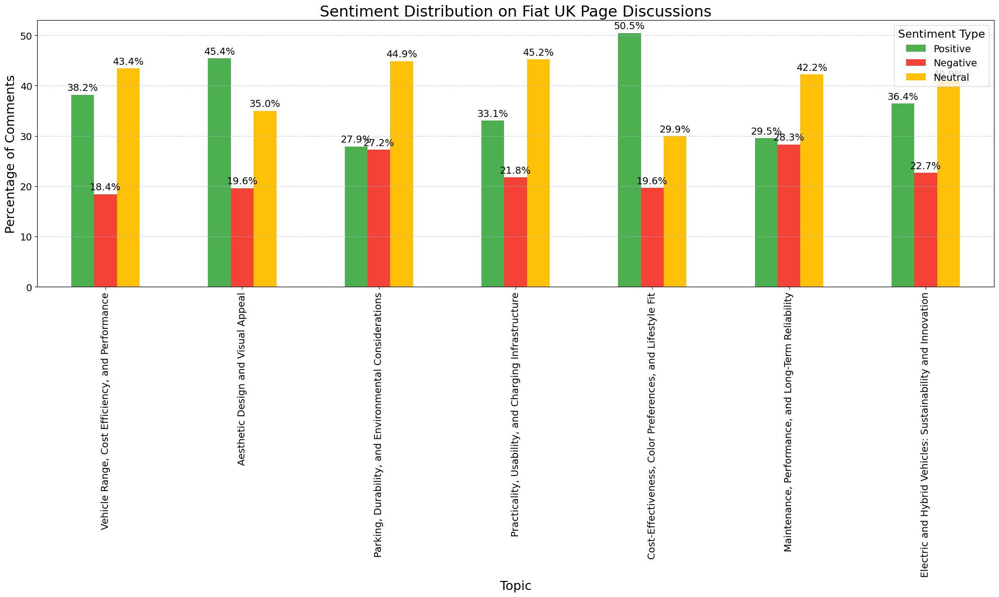

Ratios of Positive to Negative Sentiments:
Vehicle Range, Cost Efficiency, and Performance: 2.07
Aesthetic Design and Visual Appeal: 2.32
Parking, Durability, and Environmental Considerations: 1.02
Practicality, Usability, and Charging Infrastructure: 1.52
Cost-Effectiveness, Color Preferences, and Lifestyle Fit: 2.57
Maintenance, Performance, and Long-Term Reliability: 1.04
Electric and Hybrid Vehicles: Sustainability and Innovation: 1.61

Ratios of Positive to Neutral Sentiments:
Vehicle Range, Cost Efficiency, and Performance: 0.88
Aesthetic Design and Visual Appeal: 1.30
Parking, Durability, and Environmental Considerations: 0.62
Practicality, Usability, and Charging Infrastructure: 0.73
Cost-Effectiveness, Color Preferences, and Lifestyle Fit: 1.69
Maintenance, Performance, and Long-Term Reliability: 0.70
Electric and Hybrid Vehicles: Sustainability and Innovation: 0.89

Ratios of Negative to Neutral Sentiments:
Vehicle Range, Cost Efficiency, and Performance: 0.42
Aesthetic Desig

In [275]:
# Prepare data for plotting (including positive, negative, and neutral)
data = []
for topic_num, counts in sentiment_counts.items():
    if counts['total'] > 0:  # Avoid division by zero
        pos_percent = counts['positive'] / counts['total'] * 100
        neg_percent = counts['negative'] / counts['total'] * 100
        neu_percent = counts['neutral'] / counts['total'] * 100
        data.append({
            'Topic Name': topic_names[topic_num],
            'Positive': pos_percent,
            'Negative': neg_percent,
            'Neutral': neu_percent
        })

# Create DataFrame for plotting
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)

  negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help", 
        "even", "offer", "bring back", "doesn't work", "don't like", "would love", 
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen", 
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend", 
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you", 
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", 
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"
    ]

# Plotting the sentiment distribution (including Positive, Negative, and Neutral)
plt.figure(figsize=(20, 12))  # Increase the figure size for better visualization
ax = df[['Positive', 'Negative', 'Neutral']].plot(kind='bar', figsize=(20, 12), color=['#4CAF50', '#F44336', '#FFC107'])
plt.xlabel('Topic', fontsize=18)
plt.ylabel('Percentage of Comments', fontsize=18)
plt.title('Sentiment Distribution on Fiat UK Page Discussions', fontsize=22)
plt.grid(axis='y', linestyle='--', alpha=0.7, color='#B0BEC5')

# Adding percentages on top of the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize=14, color='black')

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title='Sentiment Type', fontsize=14, title_fontsize='16')
plt.tight_layout()
plt.show()

# Print the ratios of Positive to Negative sentiments for each topic, including neutral
print("Ratios of Positive to Negative Sentiments:")
for topic, counts in sentiment_counts.items():
    if counts['total'] > 0:  # Avoid division by zero
        pos_ratio = counts['positive'] / max(counts['negative'], 1)  # Avoid division by zero
        print(f"{topic_names[topic]}: {pos_ratio:.2f}")

print("\nRatios of Positive to Neutral Sentiments:")
for topic, counts in sentiment_counts.items():
    if counts['total'] > 0:  # Avoid division by zero
        pos_neu_ratio = counts['positive'] / max(counts['neutral'], 1)  # Avoid division by zero
        print(f"{topic_names[topic]}: {pos_neu_ratio:.2f}")

print("\nRatios of Negative to Neutral Sentiments:")
for topic, counts in sentiment_counts.items():
    if counts['total'] > 0:  # Avoid division by zero
        neg_neu_ratio = counts['negative'] / max(counts['neutral'], 1)  # Avoid division by zero
        print(f"{topic_names[topic]}: {neg_neu_ratio:.2f}")


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


<Figure size 2000x1200 with 0 Axes>

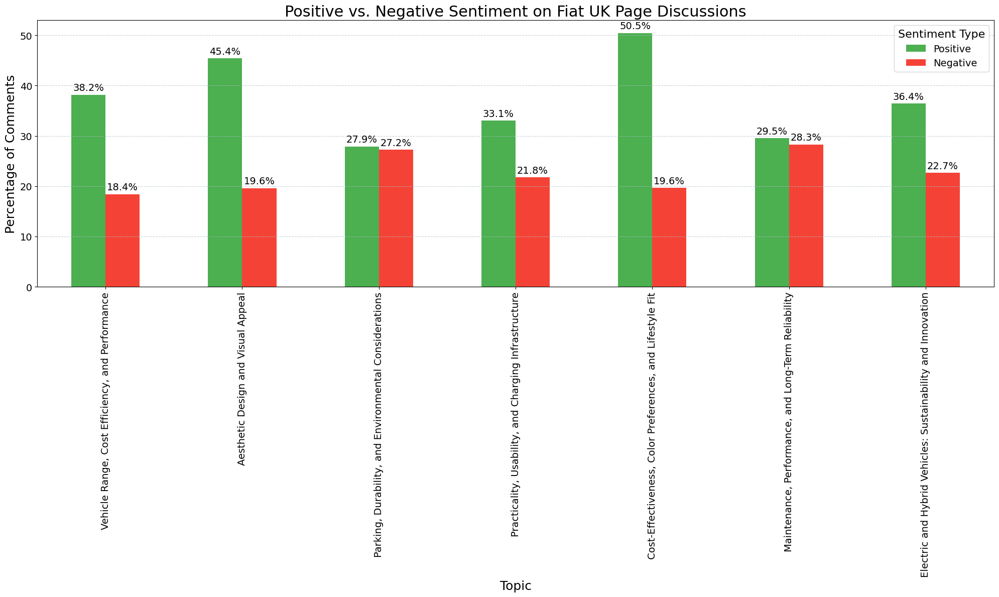

Ratios of Positive to Negative Sentiments:
Vehicle Range, Cost Efficiency, and Performance: 2.07
Aesthetic Design and Visual Appeal: 2.32
Parking, Durability, and Environmental Considerations: 1.02
Practicality, Usability, and Charging Infrastructure: 1.52
Cost-Effectiveness, Color Preferences, and Lifestyle Fit: 2.57
Maintenance, Performance, and Long-Term Reliability: 1.04
Electric and Hybrid Vehicles: Sustainability and Innovation: 1.61


In [229]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
import nltk

# Ensure the VADER lexicon and the punkt tokenizer are downloaded
nltk.download('vader_lexicon')
nltk.download('punkt')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Initialize VADER sentiment intensity analyzer
sid = SentimentIntensityAnalyzer()

# Define the clean and filter function
def clean_and_filter(comment):
    # Convert comment to lowercase to handle case insensitivity
    comment = comment.lower()
    # Tokenize the comment
    words = word_tokenize(comment)
    # List of unrelated words for filtering
    unrelated_words = ["buy", "sale", "discount", "promotion", "ad"]
    # Filtering out unrelated words
    filtered_words = [word for word in words if word not in unrelated_words]
    # Join words back into string
    return ' '.join(filtered_words)

# Define the custom sentiment analysis function
def custom_sentiment_analysis(comment):
    # Clean and filter comment
    comment = clean_and_filter(comment)
    # Custom lists of phrases to detect specific sentiments
    negative_phrases = [
        "never", "if only", "but", "pricey", "could change", "expensive", "help", 
        "even", "offer", "bring back", "doesn't work", "don't like", "would love", 
        "stinks", "fix", "died", "combustible", "scrap yard", "never seen", 
        "not be able to", "leaving", "disgusting", "washy", "breaks down"
    ]
    positive_phrases = [
        "want bad", "need", "give world", "very dated", "my next", "iconic", "legend", 
        "lovely", "last longer", "heart", "proud", "love", "can't wait", "thank you", 
        "nice", "easy", "bella", "omg", "you could", "towtruck", "miss my fiat", "loved", 
        "got few ideas", "this is the car", "enough", "best", "amazing", "honoured", "great", "old"
    ]
    # Evaluate phrases
    if any(phrase in comment for phrase in negative_phrases):
        return "negative"
    elif any(phrase in comment for phrase in positive_phrases):
        return "positive"
    # Fallback to VADER analysis if no custom phrases match
    scores = sid.polarity_scores(comment)
    return "positive" if scores['compound'] > 0.05 else "negative" if scores['compound'] < -0.05 else "neutral"

# Dictionary to store sentiment data
sentiment_counts = {topic: {'positive': 0, 'negative': 0, 'neutral': 0, 'total': 0} for topic in topic_names.keys()}

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            sentiment_counts[topic_num][sentiment] += 1
            sentiment_counts[topic_num]['total'] += 1
    else:
        print(f'File for topic {topic_name} not found.')

# Prepare data for plotting (showing only positive and negative)
data = []
for topic_num, counts in sentiment_counts.items():
    if counts['total'] > 0:  # Avoid division by zero
        pos_percent = counts['positive'] / counts['total'] * 100
        neg_percent = counts['negative'] / counts['total'] * 100
        data.append({
            'Topic Name': topic_names[topic_num],
            'Positive': pos_percent,
            'Negative': neg_percent
        })

# Create DataFrame for plotting
df = pd.DataFrame(data)
df.set_index('Topic Name', inplace=True)

# Plotting the sentiment distribution (only Positive and Negative)
plt.figure(figsize=(20, 12))  # Increase the figure size for better visualization
ax = df[['Positive', 'Negative']].plot(kind='bar', figsize=(20, 12), color=['#4CAF50', '#F44336'])
plt.xlabel('Topic', fontsize=18)
plt.ylabel('Percentage of Comments', fontsize=18)
plt.title('Positive vs. Negative Sentiment on Fiat UK Page Discussions', fontsize=22)
plt.grid(axis='y', linestyle='--', alpha=0.7, color='#B0BEC5')

# Adding percentages on top of the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize=14, color='black')

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title='Sentiment Type', fontsize=14, title_fontsize='16')
plt.tight_layout()
plt.show()

# Print the ratios of Positive to Negative sentiments for each topic
print("Ratios of Positive to Negative Sentiments:")
for topic, counts in sentiment_counts.items():
    if counts['total'] > 0:  # Avoid division by zero
        pos_ratio = counts['positive'] / max(counts['negative'], 1)  # Avoid division by zero
        print(f"{topic_names[topic]}: {pos_ratio:.2f}")


Save the topics and their sentiment analysis

In [216]:
# List to collect all analysis results for export to CSV
results = []

# Analyze sentiment for each topic
for topic_num, topic_name in topic_names.items():
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for comment in topic_df['Comment']:
            sentiment = custom_sentiment_analysis(comment)
            results.append({
                'Topic': topic_name,
                'Comment': comment,
                'Sentiment': sentiment
            })
    else:
        print(f'File for topic {topic_name} not found.')

# Create DataFrame from results
results_df = pd.DataFrame(results)

# Define the path to save the results
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_topics.csv"

# Save the DataFrame to the specified CSV file path
results_df.to_csv(file_path_csv, index=False)

print(f"Results saved to '{file_path_csv}'.")

Results saved to 'C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_topics.csv'.


In [231]:
import pandas as pd

# Read the CSV file into a DataFrame
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_topics.csv"
df = pd.read_csv(file_path_csv)

# Group by 'Topic' and 'Sentiment', then count the occurrences for each combination
summary = df.groupby(['Topic', 'Sentiment']).size().unstack(fill_value=0)

# Calculate the ratio of positive to negative comments, avoiding division by zero
summary['positive_to_negative_ratio'] = summary['positive'] / summary['negative'].replace(0, 1)

# Display the summary, showing counts of positive and negative comments along with their ratio
print(summary[['positive', 'negative', 'positive_to_negative_ratio']])


Sentiment                                           positive  negative  \
Topic                                                                    
Aesthetic Design and Visual Appeal                       139        60   
Cost-Effectiveness, Color Preferences, and Life...       167        65   
Electric and Hybrid Vehicles: Sustainability an...        82        51   
Maintenance, Performance, and Long-Term Reliabi...        70        67   
Parking, Durability, and Environmental Consider...        87        85   
Practicality, Usability, and Charging Infrastru...        79        52   
Vehicle Range, Cost Efficiency, and Performance          116        56   

Sentiment                                           positive_to_negative_ratio  
Topic                                                                           
Aesthetic Design and Visual Appeal                                    2.316667  
Cost-Effectiveness, Color Preferences, and Life...                    2.569231  
Electric 

In [215]:

# Create DataFrame from results
results_df = pd.DataFrame(results)

# Define the path to save the results
file_path_csv = r"C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv"

# Save the DataFrame to the specified CSV file path
results_df.to_csv(file_path_csv, index=False)

print(f"Results saved to '{file_path_csv}'.")

Results saved to 'C:\Users\melis\OneDrive\Desktop\ARP 3\sentiment_analyzed_comments_10_customized.csv'.


4. Sentiment Analysis Across Topics: Word Clouds for Positive, Negative, and Neutral Comments

In [156]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from wordcloud import WordCloud
from collections import Counter
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# Download required NLTK data
nltk.download('punkt')
nltk.download('stopwords')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}


# Prepare stopwords
stop_words = set(stopwords.words('english'))

# Updated list of unrelated words for Fiat Dolce Vita car analysis
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india","makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])

def preprocess_text(text):
    """Preprocess text by tokenizing and removing stopwords and non-alphabetic words."""
    tokens = word_tokenize(text.lower())
    filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words and word not in unrelated_words]
    return filtered_tokens

# Initialize VADER sentiment intensity analyzer
analyzer = SentimentIntensityAnalyzer()

# Dictionary to store sentiment data and words
topic_sentiments = {topic: {'positive': [], 'negative': []} for topic in topics}

# Analyze sentiment and extract words for each topic
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for index, row in topic_df.iterrows():
            comment = row['Comment']
            filtered_words = preprocess_text(comment)
            sentiment = analyzer.polarity_scores(' '.join(filtered_words))  # Analyze sentiment of filtered words
            if sentiment['compound'] > 0.05:  # Positive sentiment
                topic_sentiments[topic_num]['positive'].extend(filtered_words)
            elif sentiment['compound'] < -0.05:  # Negative sentiment
                topic_sentiments[topic_num]['negative'].extend(filtered_words)
    else:
        print(f'File for topic {topic_num} not found.')

# Plotting and saving word clouds for each sentiment type
for topic_num, sentiments in topic_sentiments.items():
    topic_name = topic_names[topic_num]  # Get the descriptive name for the topic
    for sentiment_type, words in sentiments.items():
        word_freq = Counter(words)
        if word_freq:  # Ensure there are words to display
            wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)
            
            # Save the wordcloud as a PNG file
            file_name = f'{topic_name.replace(" ", "_")}_{sentiment_type}.png'
            wordcloud.to_file(os.path.join(directory_path, file_name))
            print(f'Saved wordcloud: {file_name}')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Saved wordcloud: Vehicle_Range,_Cost_Efficiency,_and_Performance_positive.png
Saved wordcloud: Vehicle_Range,_Cost_Efficiency,_and_Performance_negative.png
Saved wordcloud: Aesthetic_Design_and_Visual_Appeal_positive.png
Saved wordcloud: Aesthetic_Design_and_Visual_Appeal_negative.png
Saved wordcloud: Parking,_Durability,_and_Environmental_Considerations_positive.png
Saved wordcloud: Parking,_Durability,_and_Environmental_Considerations_negative.png
Saved wordcloud: Practicality,_Usability,_and_Charging_Infrastructure_positive.png
Saved wordcloud: Practicality,_Usability,_and_Charging_Infrastructure_negative.png
Saved wordcloud: Cost-Effectiveness,_Color_Preferences,_and_Lifestyle_Fit_positive.png
Saved wordcloud: Cost-Effectiveness,_Color_Preferences,_and_Lifestyle_Fit_negative.png
Saved wordcloud: Maintenance,_Performance,_and_Long-Term_Reliability_positive.png
Saved wordcloud: Maintenance,_Performance,_and_Long-Term_Reliability_negative.png
Saved wordcloud: Electric_and_Hybrid_Vehic

Visualise the wordclouds

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


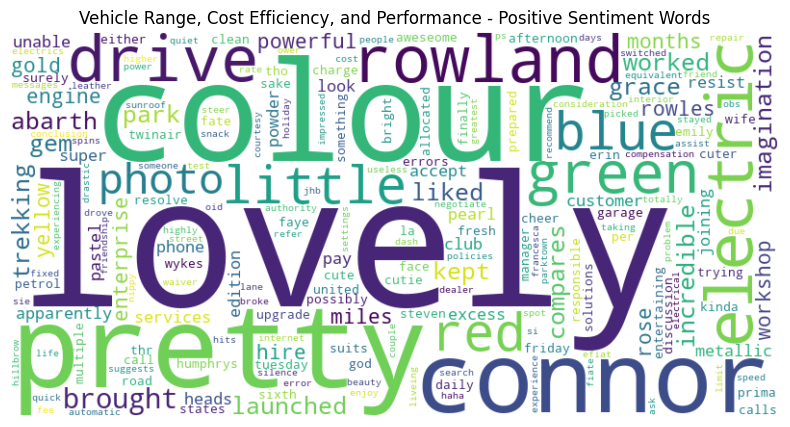

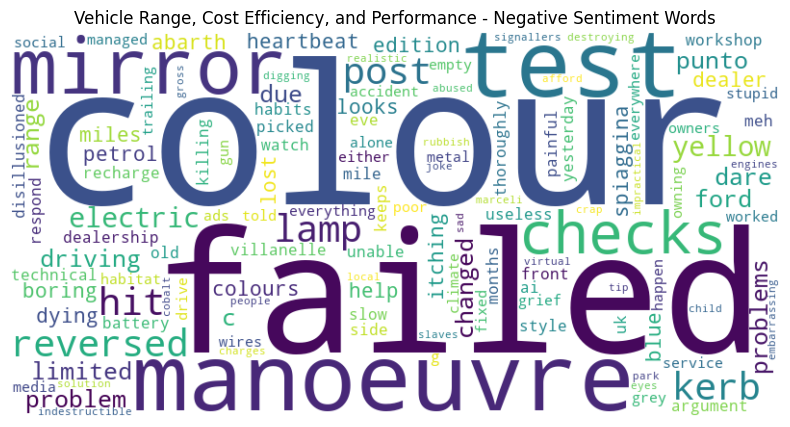

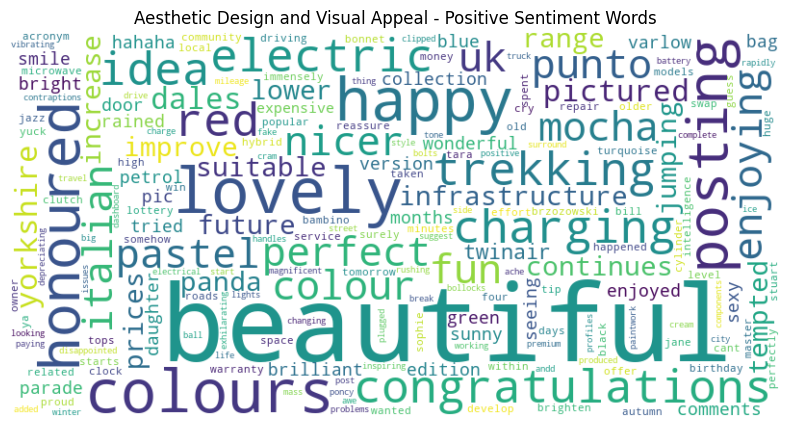

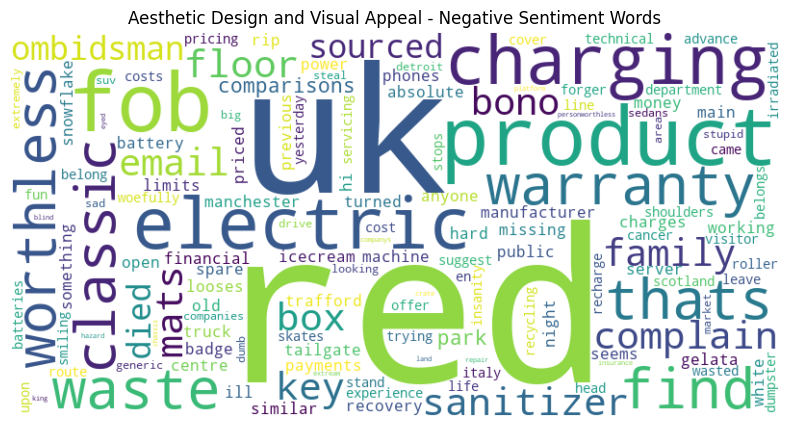

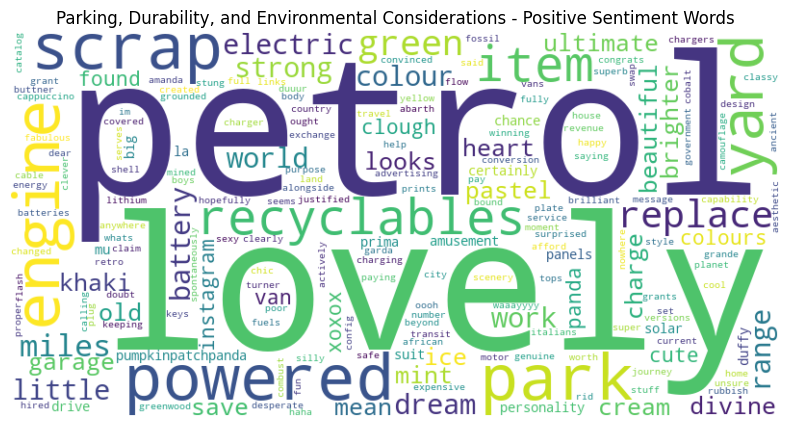

...

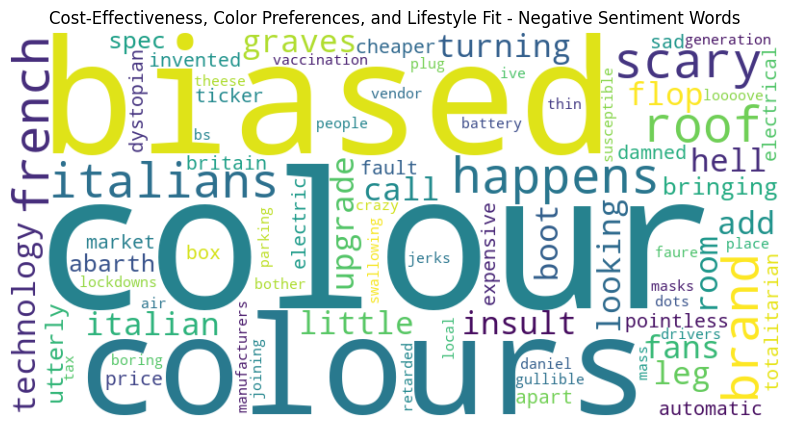

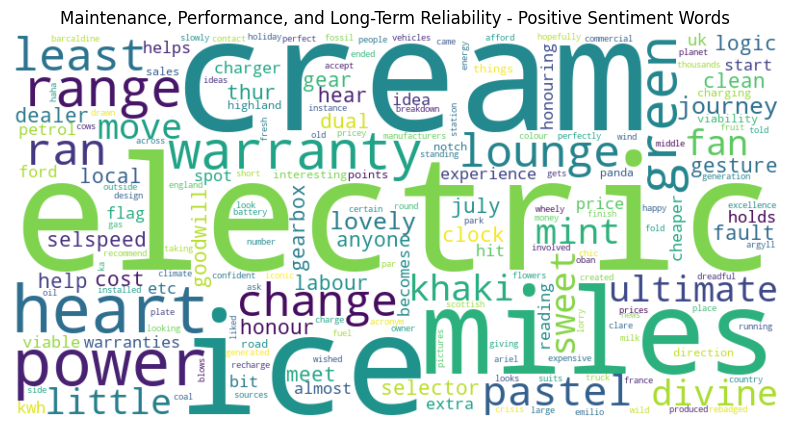

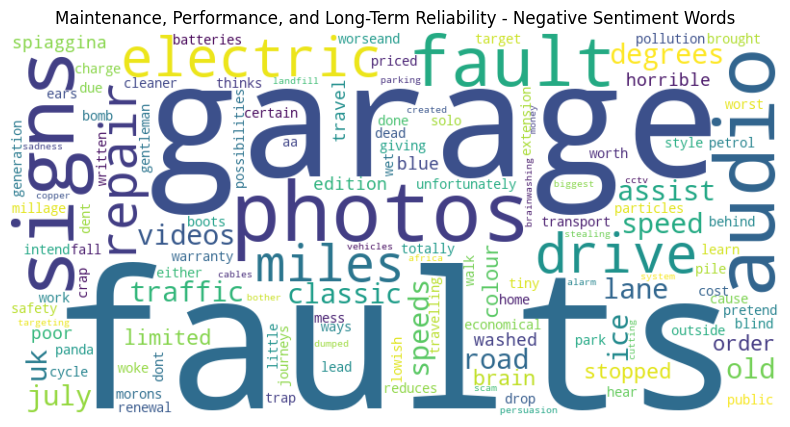

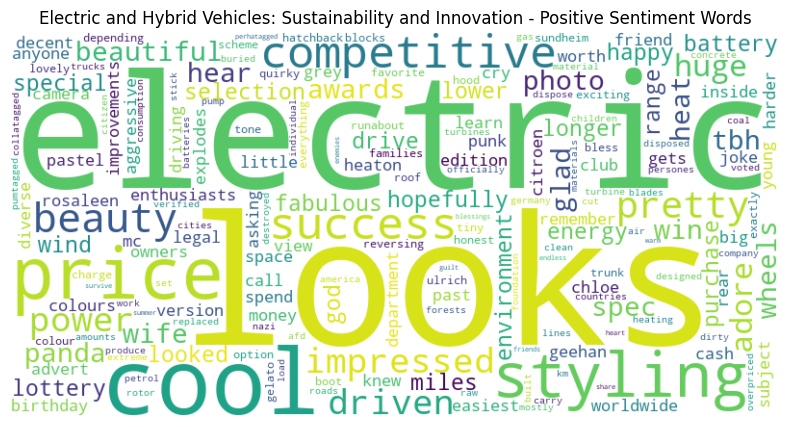

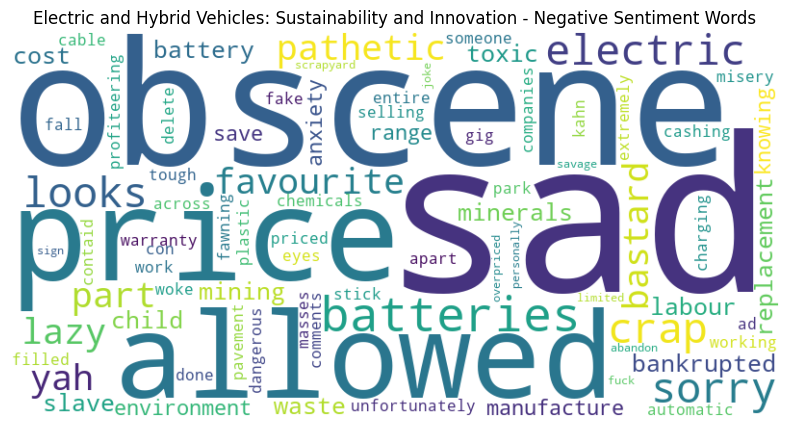

In [157]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from wordcloud import WordCloud
from collections import Counter
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# Download required NLTK data
nltk.download('punkt')
nltk.download('stopwords')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}
# Prepare stopwords
stop_words = set(stopwords.words('english'))

# Updated list of unrelated words for Fiat Dolce Vita car analysis
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])

def preprocess_text(text):
    """Preprocess text by tokenizing and removing stopwords and non-alphabetic words."""
    tokens = word_tokenize(text.lower())
    filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words and word not in unrelated_words]
    return filtered_tokens

# Initialize VADER sentiment intensity analyzer
analyzer = SentimentIntensityAnalyzer()

# Dictionary to store sentiment data and words
topic_sentiments = {topic: {'positive': [], 'negative': []} for topic in topics}

# Analyze sentiment and extract words for each topic
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for index, row in topic_df.iterrows():
            comment = row['Comment']
            filtered_words = preprocess_text(comment)
            sentiment = analyzer.polarity_scores(' '.join(filtered_words))  # Analyze sentiment of filtered words
            if sentiment['compound'] > 0.05:  # Positive sentiment
                topic_sentiments[topic_num]['positive'].extend(filtered_words)
            elif sentiment['compound'] < -0.05:  # Negative sentiment
                topic_sentiments[topic_num]['negative'].extend(filtered_words)
    else:
        print(f'File for topic {topic_num} not found.')

# Plotting and showing word clouds for each sentiment type
for topic_num, sentiments in topic_sentiments.items():
    topic_name = topic_names[topic_num]  # Get the descriptive name for the topic
    for sentiment_type, words in sentiments.items():
        word_freq = Counter(words)
        if word_freq:  # Ensure there are words to display
            wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)
            
            plt.figure(figsize=(10, 5))
            plt.imshow(wordcloud, interpolation='bilinear')
            plt.axis('off')
            plt.title(f'{topic_name} - {sentiment_type.capitalize()} Sentiment Words')
            plt.show()


Wordcloud from Dolce Vita Facebook Comments

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


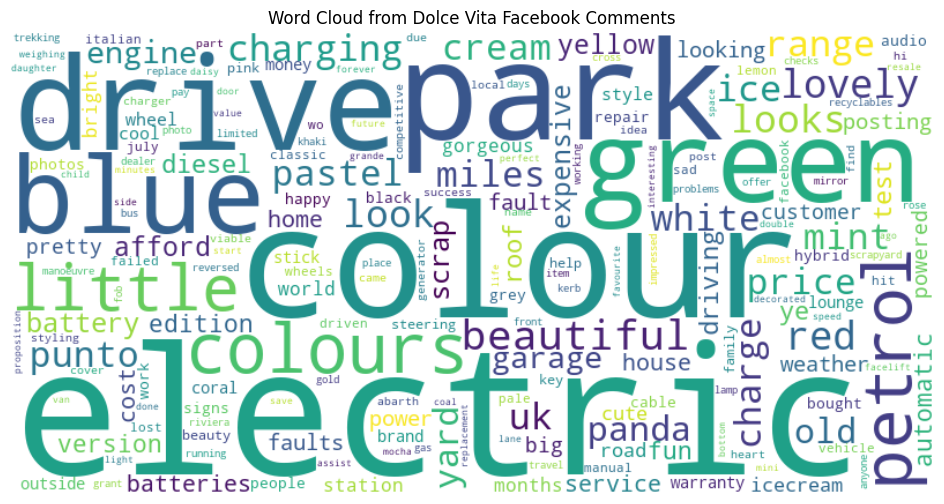

In [235]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from wordcloud import WordCloud
from collections import Counter
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# Download required NLTK data
nltk.download('punkt')
nltk.download('stopwords')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# Prepare stopwords
stop_words = set(stopwords.words('english'))

# Prepare stopwords and additional unrelated words
stop_words = set(stopwords.words('english'))
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person",  "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])

def preprocess_text(text):
    """Preprocess text by tokenizing and removing stopwords and non-alphabetic words."""
    tokens = word_tokenize(text.lower())
    filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words and word not in unrelated_words]
    return filtered_tokens

# Initialize VADER sentiment intensity analyzer
analyzer = SentimentIntensityAnalyzer()

# List to store all filtered words
all_words = []

# Analyze sentiment and extract words from all comments
for topic_num in range(1, 8):  
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for index, row in topic_df.iterrows():
            comment = row['Comment']
            filtered_words = preprocess_text(comment)
            all_words.extend(filtered_words)
    else:
        print(f'File for topic {topic_num} not found.')

# Generate word frequencies for the combined word list
word_freq = Counter(all_words)

# Generate and plot the word cloud
if word_freq:  # Ensure there are words to display
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)
    
    plt.figure(figsize=(12, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('Word Cloud from Dolce Vita Facebook Comments')
    plt.show()


In [ ]:
# Prepare stopwords and additional unrelated words
stop_words = set(stopwords.words('english'))
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])

Most Top 10 Words 

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


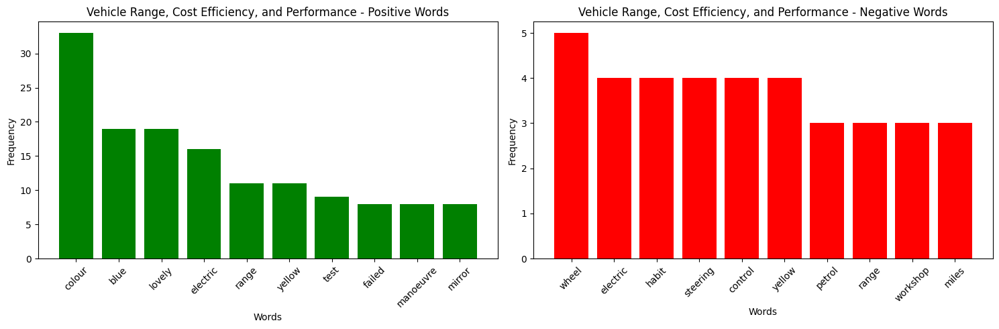

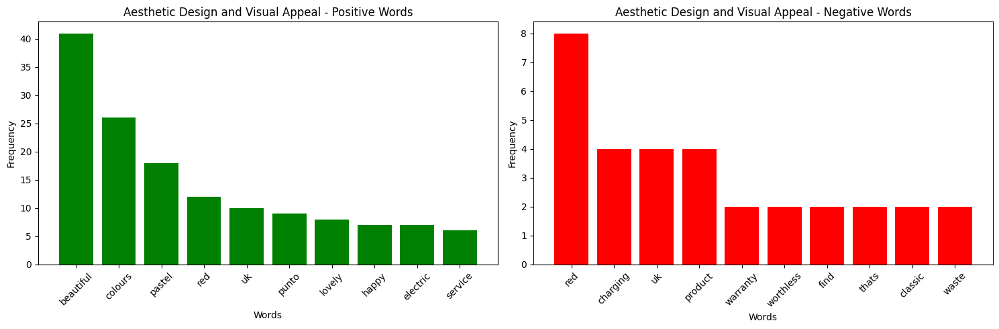

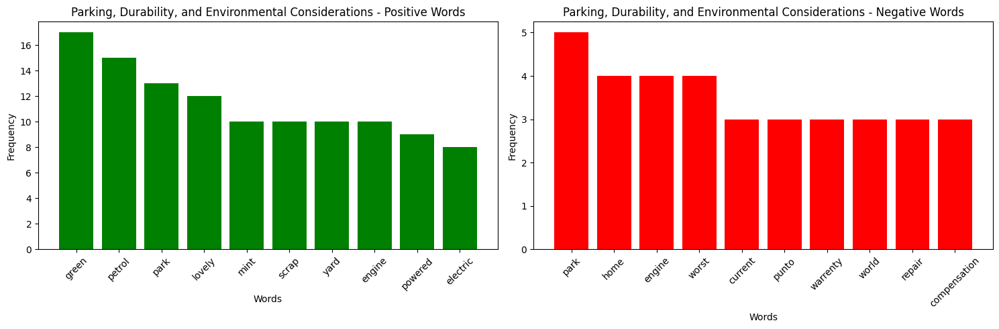

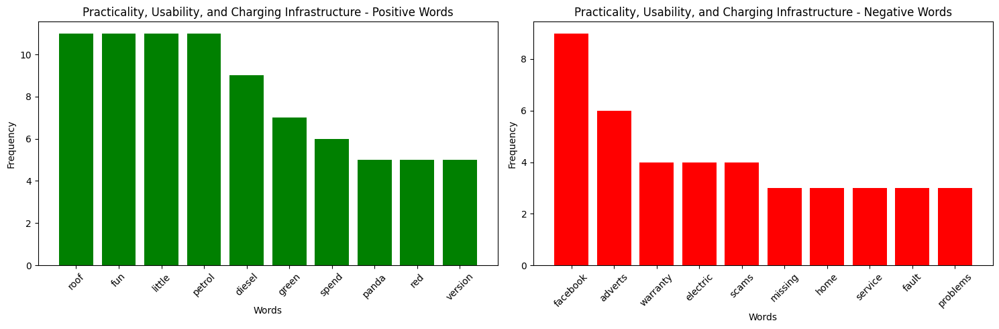

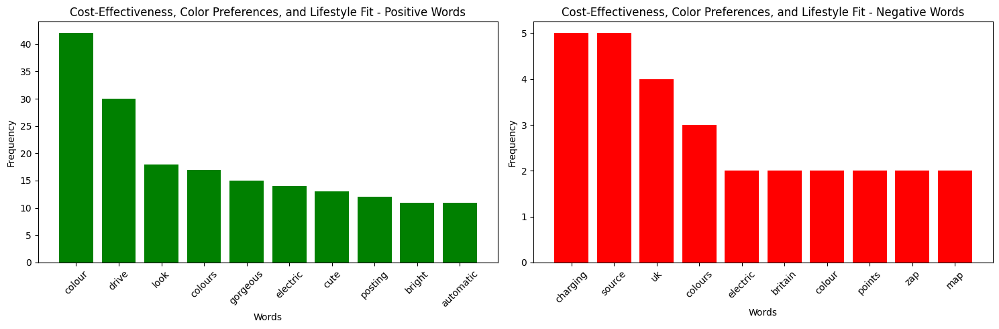

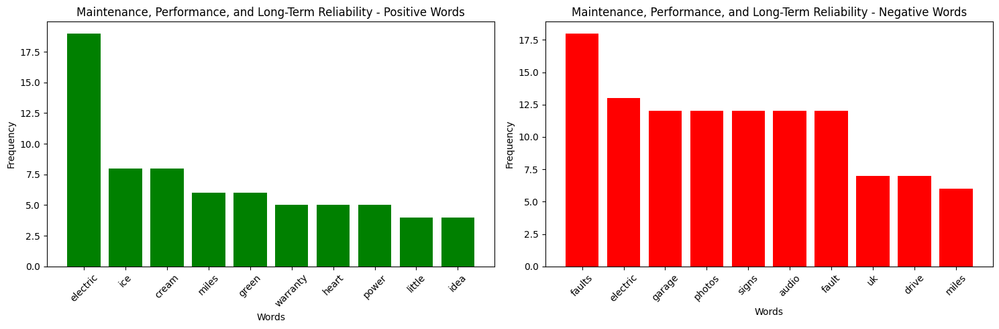

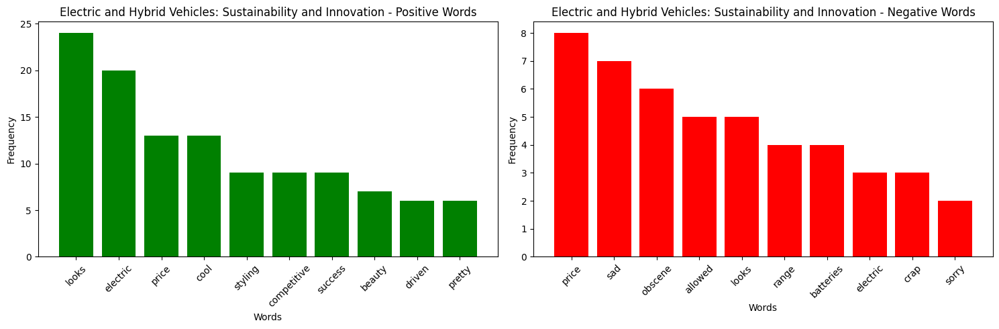

In [162]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import nltk
from collections import Counter

# Ensure that you've downloaded the required NLTK data
nltk.download('punkt')
nltk.download('stopwords')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}

# Prepare stopwords and additional unrelated words
stop_words = set(stopwords.words('english'))
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])
# Initialize VADER sentiment intensity analyzer
analyzer = SentimentIntensityAnalyzer()

def preprocess_text(text):
    """Preprocess text by tokenizing and removing stopwords and unrelated words."""
    tokens = word_tokenize(text.lower())
    filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words and word not in unrelated_words]
    return filtered_tokens

# Dictionary to store sentiment data and words
topic_sentiments = {topic: {'positive': [], 'negative': []} for topic in topics}

# Analyze sentiment and extract words for each topic
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for index, row in topic_df.iterrows():
            comment = row['Comment']
            words = preprocess_text(comment)
            scores = analyzer.polarity_scores(comment)
            sentiment_type = 'positive' if scores['compound'] > 0.05 else 'negative' if scores['compound'] < -0.05 else 'neutral'
            if sentiment_type in ['positive', 'negative']:
                topic_sentiments[topic_num][sentiment_type].extend(words)
    else:
        print(f'File for topic {topic_num} not found.')

# Plotting the top words in bar charts for both sentiments together
for topic_num, sentiments in topic_sentiments.items():
    pos_word_freq = Counter(sentiments['positive'])
    neg_word_freq = Counter(sentiments['negative'])
    
    # Top words for positive and negative sentiments
    pos_common_words = pos_word_freq.most_common(10)
    neg_common_words = neg_word_freq.most_common(10)
    
    # Data for plotting
    pos_words, pos_counts = zip(*pos_common_words) if pos_common_words else ([], [])
    neg_words, neg_counts = zip(*neg_common_words) if neg_common_words else ([], [])
    
    # Create subplots
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))
    
    # Positive words subplot
    axs[0].bar(pos_words, pos_counts, color='green')
    axs[0].set_title(f'{topic_names[topic_num]} - Positive Words')
    axs[0].set_xlabel('Words')
    axs[0].set_ylabel('Frequency')
    axs[0].tick_params(axis='x', rotation=45)
    
    # Negative words subplot
    axs[1].bar(neg_words, neg_counts, color='red')
    axs[1].set_title(f'{topic_names[topic_num]} - Negative Words')
    axs[1].set_xlabel('Words')
    axs[1].set_ylabel('Frequency')
    axs[1].tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    plt.show()


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


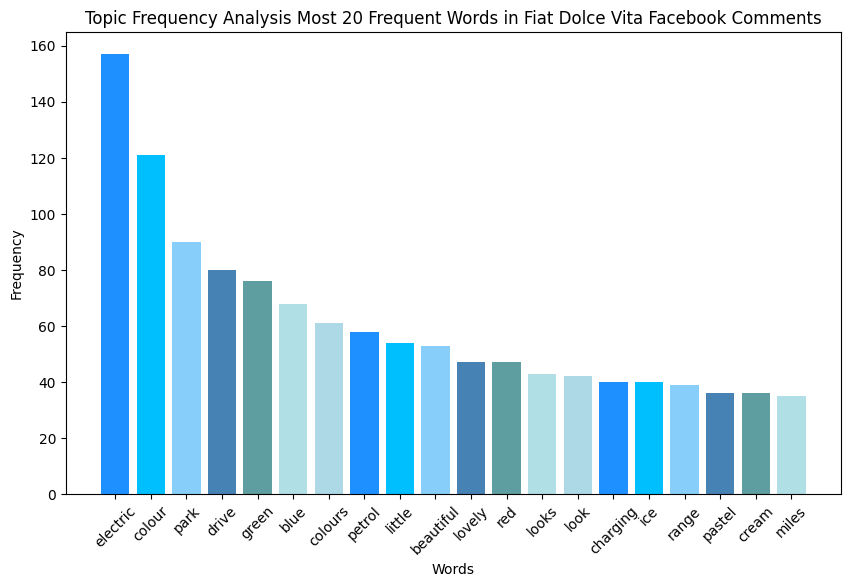

In [272]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from collections import Counter

# Ensure that you've downloaded the required NLTK data
import nltk
nltk.download('punkt')
nltk.download('stopwords')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics
topics = [1, 2, 3, 4, 5, 6, 7]


# Prepare stopwords and additional unrelated words
stop_words = set(stopwords.words('english'))
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])
# Initialize a list to hold all words
all_words = []

def preprocess_text(text):
    """Preprocess text by tokenizing and removing stopwords and unrelated words."""
    tokens = word_tokenize(text.lower())
    filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words and word not in unrelated_words]
    return filtered_tokens

# Analyze sentiment and extract words for each topic
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for index, row in topic_df.iterrows():
            comment = row['Comment']
            words = preprocess_text(comment)
            all_words.extend(words)
    else:
        print(f'File for topic {topic_num} not found.')

# Count the frequency of all words
word_freq = Counter(all_words)

# Get the top 20 most common words
top_20_words = word_freq.most_common(20)

# Convert to DataFrame for easy visualization
top_20_df = pd.DataFrame(top_20_words, columns=['Word', 'Frequency'])

blue_tones = ['#1E90FF', '#00BFFF', '#87CEFA', '#4682B4', '#5F9EA0', '#B0E0E6', '#ADD8E6']


# Plot the top 20 words
plt.figure(figsize=(10, 6))
plt.bar(top_20_df['Word'], top_20_df['Frequency'], color= blue_tones)
plt.title('Topic Frequency Analysis Most 20 Frequent Words in Fiat Dolce Vita Facebook Comments')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\melis\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


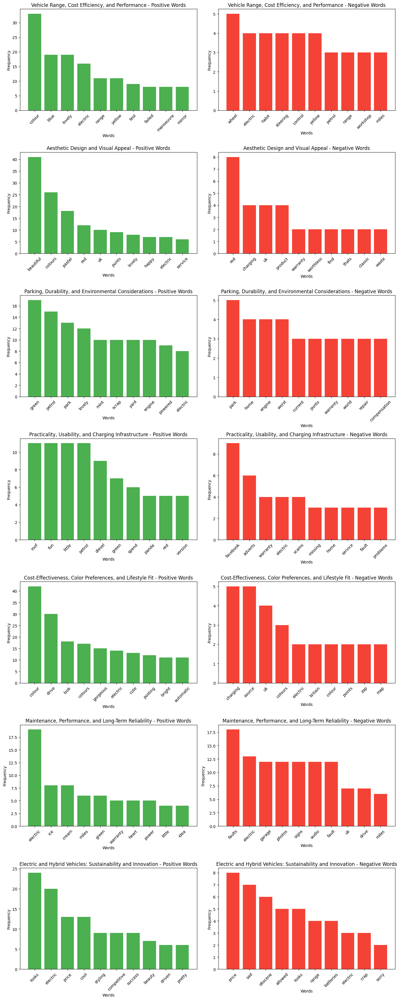

In [163]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import nltk
from collections import Counter

# Ensure that you've downloaded the required NLTK data
nltk.download('punkt')
nltk.download('stopwords')

# Define the directory path where your files are stored
directory_path = r'C:\Users\melis\OneDrive\Desktop\ARP 3'

# List of topics
topics = [1, 2, 3, 4, 5, 6, 7]

# Names for each topic
topic_names = {
    1: 'Vehicle Range, Cost Efficiency, and Performance',
    2: 'Aesthetic Design and Visual Appeal',
    3: 'Parking, Durability, and Environmental Considerations',
    4: 'Practicality, Usability, and Charging Infrastructure',
    5: 'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    6: 'Maintenance, Performance, and Long-Term Reliability',
    7: 'Electric and Hybrid Vehicles: Sustainability and Innovation'
}


# Prepare stopwords and additional unrelated words
stop_words = set(stopwords.words('english'))
# Updated list of unrelated words for Fiat Dolce Vita car analysis
unrelated_words = set([
    "along", "annette", "arrive", "avoid", "baby", "barge", "believe",
    "beltzner", "better", "bravo", "bring", "brisbane", "card", "car", "cars", "ca",
    "charlotte", "clear", "close", "commuter", "considering", "could", "crossing", "day", "degrees_degree",
    "denmark", "during", "earned", "epic", "esque", "evening", "every", "exist", "existed",
    "existent", "farm", "fiat", "fit", "fix", "focus", "following", "get", "go", "going", "got", "hand",
    "ha", "has", "have", "heard", "hey", "him", "interested", "junk", "likely", "lol", "loved", "loving",
    "luck", "make", "malton", "may", "mine", "miss", "much", "nan", "need", "near", "nearest", "nearest_scrap_yard",
    "next", "no", "nobody", "non", "nothing", "now", "off", "offered", "often", "ok", "one", "ones",
    "only", "or", "others", "our", "out", "peak", "please", "point", "push", "put", "ready", "real",
    "really", "receive", "recently", "recommended", "reply", "rest", "run", "runs", "saint", "salvage",
    "same", "san", "saw", "say", "sean", "see", "seen", "sell", "serve", "shite", "shoot", "should",
    "since", "sit", "sold", "somewhere", "sometimes", "stay", "stop", "sure", "switch", "take",
    "takes", "telling", "thanks", "that", "the", "then", "these", "think", "this", "those", "though",
    "thought", "three", "time", "times", "today", "together", "top", "total", "truly", "turn", "two",
    "typically", "unbelievable", "unbelievably", "unless", "use", "used", "usually", "various", "want",
    "warned", "way", "welcome", "well", "went", "were", "what", "when", "where", "whether", "which",
    "who", "why", "will", "with", "without", "would", "yes", "yet", "you", "oh", "burn", "francisco",
    "canada", "čevabdžinica", "trebant", "mg", "corsican", "ye_ye", "steering_wheel", "years",
    "hands", "stinks", "mines", "person", "tagged", "omg", "back", "new", "xxx", "never",
    "persontagged", "absolutely", "actually", "year", "hope", "give", "skip", "around", "xx", "keep",
    "good", "amazing", "great", "tripe", "shame", "x", "come", "like", "still", "jubbly", "tap",
    "always", "scrap_yard", "us", "buy", "many", "best", "know", "known", "far", "ev", "I", "nice",
    "simply", "anyway", "regular", "ho", "enough", "job", "end", "equally", "weeks", "left", "erm",
    "maker", "maybe", "made", "else", "already", "rather", "busy", "bad", "possible", "wait", "nina",
    "long", "away", "https", "love", "anything", "wow", "case", "hence", "ulez", "hate", "bring_honolulu_always",
    "might", "ever", "fearn", "hoot", "shown", "show", "making", "fire", "definitely", "probably", "gone",
    "buying", "ready", "wish", "ground", "HTTP", "poison", "pumped", "grid", "lot", "third", "india",
    "makes", "soooooo", "dissapointing", "available", "fiats", "dumè", "ribeiro", "olivier", "sofia",
    "dawn", "liddington", "one_person", "tagged", "coming", "wrong", "turns", "quite", "free",
    "feel", "degree", "pm", "refuses", "read", "insisted", "expect", "flaws", "breaks", "half", "another",
    "deserved", "goes", "God", "maiano", "julie", "kiely", "whoop", "gambo", "hopeless", "lack",
    "appalling", "greedy", "getting", "superior", "thank", "try", "easy", "anymore", "consider",
    "needs", "currently", "beware", "question", "using", "wishes", "Ioana", "francesco", "ny",
    "Szasz", "cornacchia", "suggesting", "soon", "realise", "seem", "hours", "brunet", "first",
    "different", "also", "called", "opinion", "wee", "although", "prefer", "small", "e", "second",
    "let", "tell", "basically", "honolulu", "deserve", "starting", "wants", "lake", "aww", "original",
    "convertible", "everyone", "awful", "whole", "sight", "faster", "sooooo", "fantastic", "stunning",
    "honouredtagged", "shocking", "right", "able", "fell", "cunningham", "morgan", "worse", "yep",
    "even", "needed", "imagine", "walsall", "reckon", "brag", "jab", "realize", "including",
    "hallows", "deathly", "fabio", "burgundy", "forget", "yeye", "willing", "less", "last", "waiting"
])

# Initialize VADER sentiment intensity analyzer
analyzer = SentimentIntensityAnalyzer()

def preprocess_text(text):
    """Preprocess text by tokenizing and removing stopwords and unrelated words."""
    tokens = word_tokenize(text.lower())
    filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words and word not in unrelated_words]
    return filtered_tokens

# Dictionary to store sentiment data and words
topic_sentiments = {topic: {'positive': [], 'negative': []} for topic in topics}

# Analyze sentiment and extract words for each topic
for topic_num in topics:
    file_path = f'{directory_path}/facebook_comments_final_2_finaltopic_{topic_num}_comments.csv'
    
    if os.path.exists(file_path):
        topic_df = pd.read_csv(file_path)
        
        for index, row in topic_df.iterrows():
            comment = row['Comment']
            words = preprocess_text(comment)
            scores = analyzer.polarity_scores(comment)
            sentiment_type = 'positive' if scores['compound'] > 0.05 else 'negative' if scores['compound'] < -0.05 else 'neutral'
            if sentiment_type in ['positive', 'negative']:
                topic_sentiments[topic_num][sentiment_type].extend(words)
    else:
        print(f'File for topic {topic_num} not found.')

# Create a figure with subplots for each topic
fig, axs = plt.subplots(len(topics), 2, figsize=(14, 5 * len(topics)))  # Adjusted height to 5

# Plotting the top words in bar charts for both sentiments together
for i, (topic_num, sentiments) in enumerate(topic_sentiments.items()):
    pos_word_freq = Counter(sentiments['positive'])
    neg_word_freq = Counter(sentiments['negative'])
    
    # Top words for positive and negative sentiments
    pos_common_words = pos_word_freq.most_common(10)
    neg_common_words = neg_word_freq.most_common(10)
    
    # Data for plotting
    pos_words, pos_counts = zip(*pos_common_words) if pos_common_words else ([], [])
    neg_words, neg_counts = zip(*neg_common_words) if neg_common_words else ([], [])
    
    # Positive words subplot
    axs[i, 0].bar(pos_words, pos_counts, color='#4CAF50')
    axs[i, 0].set_title(f'{topic_names[topic_num]} - Positive Words')
    axs[i, 0].set_xlabel('Words')
    axs[i, 0].set_ylabel('Frequency')
    axs[i, 0].tick_params(axis='x', rotation=45)
    
    # Negative words subplot
    axs[i, 1].bar(neg_words, neg_counts, color='#F44336')
    axs[i, 1].set_title(f'{topic_names[topic_num]} - Negative Words')
    axs[i, 1].set_xlabel('Words')
    axs[i, 1].set_ylabel('Frequency')
    axs[i, 1].tick_params(axis='x', rotation=45)

# Adjust layout and show plot
plt.tight_layout()
plt.show()


Similarity

In [164]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import plotly.express as px
import plotly.io as pio
import numpy as np
from textblob import TextBlob

# Set the default renderer for Plotly to display in Jupyter Notebooks (if applicable)
pio.renderers.default = 'notebook'  # Change to 'browser' or another renderer if needed

# Load the topics from both marketing data and YouTube/Reddit review data
marketing_topics_df = pd.read_csv(r'C:\Users\melis\OneDrive\Desktop\ARP 3\Fiat_Dolcevita_Marketing_Topics_75_Words.csv')
review_topics_df = pd.read_csv(r"C:\Users\melis\OneDrive\Desktop\Dolce Vita Results\topics_with_top_words_final_2.csv")

# Combine the 'Top Words' from the topics into a list
marketing_topics = marketing_topics_df['Top Words'].tolist()
review_topics = review_topics_df['Top Words'].tolist()

# Assign meaningful labels to the marketing topics
marketing_topic_labels = [
    "Fiat Marketing: Design and Exterior",
    "Fiat Marketing: Lifestyle Dolce Vita",
    "Fiat Marketing: Driver Assistance and Features",
    "Fiat Marketing: General Features and Design",
    "Fiat Marketing: Advanced Technology and Infotainment",
    "Fiat Marketing: Luxurious Interior and Sustainability",
    "Fiat Marketing: Fiat Brand and Dolcevita"
]


# Adjust review topic labels based on the number of topics
review_topic_labels = [
    'Vehicle Range, Cost Efficiency, and Performance',
    'Aesthetic Design and Visual Appeal',
    'Parking, Durability, and Environmental Considerations',
    'Practicality, Usability, and Charging Infrastructure',
    'Cost-Effectiveness, Color Preferences, and Lifestyle Fit',
    'Maintenance, Performance, and Long-Term Reliability',
    'Electric and Hybrid Vehicles: Sustainability and Innovation'
]

# Ensure that the number of labels matches the number of topics
assert len(marketing_topics) == len(marketing_topic_labels), "Number of marketing topics and labels do not match"
assert len(review_topics) == len(review_topic_labels), "Number of review topics and labels do not match"

# Create a TF-IDF vectorizer
vectorizer = TfidfVectorizer()

# Fit and transform the topics from both datasets
marketing_tfidf = vectorizer.fit_transform(marketing_topics)
review_tfidf = vectorizer.transform(review_topics)

# Calculate cosine similarity between the marketing topics and review topics
similarity_matrix = cosine_similarity(marketing_tfidf, review_tfidf)

# 1. Heatmap for Topic Similarity with White-to-Blue Color Scheme
fig1 = px.imshow(
    similarity_matrix,
    labels=dict(x="Review Topics", y="Marketing Topics", color="Similarity"),
    x=review_topic_labels,
    y=marketing_topic_labels,
    color_continuous_scale=[
        [0.0, 'white'],   # White for no similarity
        [1.0, 'blue']     # Blue for high similarity
    ],
    text_auto=True
)

fig1.update_layout(
    title="Topic Similarity Between Marketing and Review Topics",
    xaxis_title="Review Topics",
    yaxis_title="Marketing Topics",
    width=1000,
    height=800
)

fig1.show()

# Perform sentiment analysis on the review topics
review_sentiments = [TextBlob(topic).sentiment.polarity for topic in review_topics]

# Scale sentiment to match the range of similarity (0 to 1)
scaled_sentiments = (np.array(review_sentiments) + 1) / 2  # TextBlob sentiment polarity is from -1 to 1

# Adjust the shape of the scaled_sentiments array to match the similarity_matrix
scaled_sentiments = scaled_sentiments.reshape(1, -1)  # Reshape to (1, number_of_review_topics)

# Multiply sentiment with the similarity matrix to get weighted sentiment
weighted_sentiment_matrix = similarity_matrix * scaled_sentiments

# 2. Heatmap for Sentiment-Weighted Similarity
fig2 = px.imshow(
    weighted_sentiment_matrix,
    labels=dict(x="Review Topics", y="Marketing Topics", color="Weighted Sentiment"),
    x=review_topic_labels,
    y=marketing_topic_labels,
    color_continuous_scale=[
        [0.0, 'red'],      # Red for negative sentiment
        [0.5, 'yellow'],   # Yellow for neutral sentiment
        [1.0, 'green']     # Green for positive sentiment
    ],
    text_auto=True
)

fig2.update_layout(
    title="Sentiment-Weighted Similarity Between Marketing and Review Topics",
    xaxis_title="Review Topics",
    yaxis_title="Marketing Topics",
    width=1000,
    height=800
)

fig2.show()


In [28]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import plotly.express as px
import plotly.io as pio
import numpy as np
from textblob import TextBlob

# Set the default renderer for Plotly to display in Jupyter Notebooks (if applicable)
pio.renderers.default = 'notebook'  # Change to 'browser' or another renderer if needed

# Load the topics from both marketing data and YouTube/Reddit review data
marketing_topics_df = pd.read_csv(r'C:\Users\melis\OneDrive\Desktop\ARP 3\Fiat_Dolcevita_Marketing_Topics_75_Words.csv')
review_topics_df = pd.read_csv(r"C:\Users\melis\OneDrive\Desktop\ARP 3\topics_with_top_words.csv")

# Combine the 'Top Words' from the topics into a list
marketing_topics = marketing_topics_df['Top Words'].tolist()
review_topics = review_topics_df['Top Words'].tolist()

# Assign meaningful labels to the marketing topics
marketing_topic_labels = [
    "Fiat Marketing: Design and Exterior",
    "Fiat Marketing: Lifestyle Dolce Vita",
    "Fiat Marketing: Driver Assistance and Features",
    "Fiat Marketing: General Features and Design",
    "Fiat Marketing: Advanced Technology and Infotainment",
    "Fiat Marketing: Luxurious Interior and Sustainability",
    "Fiat Marketing: Fiat Brand and Dolcevita"
]


# Adjust review topic labels based on the number of topics
review_topic_labels = [
    'Vehicle Performance and Efficiency',
     'Vehicle Aesthetics and Design',
     'Environmental Impact and Sustainability',
     'Vehicle Ownership and Costs',
     'Vehicle Maintenance and Repairs',
     'Vehicle Technology and Innovation',
     'Vehicle Safety and Regulations'
]

# Ensure that the number of labels matches the number of topics
assert len(marketing_topics) == len(marketing_topic_labels), "Number of marketing topics and labels do not match"
assert len(review_topics) == len(review_topic_labels), "Number of review topics and labels do not match"

# Create a TF-IDF vectorizer
vectorizer = TfidfVectorizer()

# Fit and transform the topics from both datasets
marketing_tfidf = vectorizer.fit_transform(marketing_topics)
review_tfidf = vectorizer.transform(review_topics)

# Calculate cosine similarity between the marketing topics and review topics
similarity_matrix = cosine_similarity(marketing_tfidf, review_tfidf)

# 1. Heatmap for Topic Similarity with White-to-Blue Color Scheme
fig1 = px.imshow(
    similarity_matrix,
    labels=dict(x="Review Topics", y="Marketing Topics", color="Similarity"),
    x=review_topic_labels,
    y=marketing_topic_labels,
    color_continuous_scale=[
        [0.0, 'white'],   # White for no similarity
        [1.0, 'blue']     # Blue for high similarity
    ],
    text_auto=True
)

fig1.update_layout(
    title="Topic Similarity Between Marketing and Review Topics",
    xaxis_title="Review Topics",
    yaxis_title="Marketing Topics",
    width=1000,
    height=800
)

fig1.show()

# Perform sentiment analysis on the review topics
review_sentiments = [TextBlob(topic).sentiment.polarity for topic in review_topics]

# Scale sentiment to match the range of similarity (0 to 1)
scaled_sentiments = (np.array(review_sentiments) + 1) / 2  # TextBlob sentiment polarity is from -1 to 1

# Adjust the shape of the scaled_sentiments array to match the similarity_matrix
scaled_sentiments = scaled_sentiments.reshape(1, -1)  # Reshape to (1, number_of_review_topics)

# Multiply sentiment with the similarity matrix to get weighted sentiment
weighted_sentiment_matrix = similarity_matrix * scaled_sentiments

# 2. Heatmap for Sentiment-Weighted Similarity
fig2 = px.imshow(
    weighted_sentiment_matrix,
    labels=dict(x="Review Topics", y="Marketing Topics", color="Weighted Sentiment"),
    x=review_topic_labels,
    y=marketing_topic_labels,
    color_continuous_scale=[
        [0.0, 'red'],      # Red for negative sentiment
        [0.5, 'yellow'],   # Yellow for neutral sentiment
        [1.0, 'green']     # Green for positive sentiment
    ],
    text_auto=True
)

fig2.update_layout(
    title="Sentiment-Weighted Similarity Between Marketing and Review Topics",
    xaxis_title="Review Topics",
    yaxis_title="Marketing Topics",
    width=1000,
    height=800
)

fig2.show()
